<a href="https://colab.research.google.com/github/Elpastore/ALX_SE_project/blob/main/GWSS.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install -qq malariagen_data
import malariagen_data
import numpy as np
import pandas as pd
import allel
import zarr
import matplotlib.pyplot as plt
import seaborn as sns

ag3 = malariagen_data.Ag3()
ag3

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.0/4.0 MB 16.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 195.4/195.4 kB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.7/71.7 kB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 775.9/775.9 kB 12.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 25.9/25.9 MB 17.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.7/8.7 MB 26.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.3/211.3 kB 11.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.3/6.3 MB 20.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 32.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.9/7.9 MB 18.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.3/78.3 kB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.

ImportError: cannot import name 'cbuffer_sizes' from 'numcodecs.blosc' (/usr/local/lib/python3.11/dist-packages/numcodecs/blosc.cpython-311-x86_64-linux-gnu.so)

In [ ]:
#GSS with iHs
def run_ihS(cohort, contig,  window_size=200, country=None):
  """
  function that compute iHs value for a given cohort and contig
  """
  #for contig in contigs:
  pos, ihs = ag3.ihs_gwss(
      contig=contig,
      #sample_query=f"cohort_admin1_year == '{cohort}'" if per_cohort else f"country=='{country} and taxon=='{cohort}'",
      sample_query=f"country=='{country} and taxon=='{cohort}'",
      window_size=window_size,
      analysis="gamb_colu",
      min_cohort_size=10,
      )
  return pos, ihs # x: ndarray ihs: ndarray

def run_ihs_per_cohort(cohort_group , cohort, taxon, country, contig,  window_size=200):
  """
  function that compute iHs value for a given cohort and contig
  """
  pos, ihs = ag3.ihs_gwss(
      contig=contig,
      sample_query=f"country=='{country}' and taxon=='{taxon}' and {cohort_group}=='{cohort}'",
      window_size=window_size,
      analysis="gamb_colu",
      min_cohort_size=10,
      )
  return pos, ihs # x: ndarray ihs: ndarray

##GWSS with H12
def run_gwss(cohort, contig, window_size):
  """
  function that compute H12 value for a given cohort and contig
  """
  pos, h12, contigs = ag3.h12_gwss(
      contig=contig,
      sample_query=f"country=='Gambia, The' and taxon == '{cohort}'",
      window_size=window_size,
      #analysis="gamb_colu_arab",
      analysis="arab",
      min_cohort_size=10,
      max_cohort_size=100,
      )
  return pos, h12, contigs # x: ndarray h12: ndarray

def find_best_window_size(contig, cohort=None):
    """
    Function to compute the best window size for H12 calculation based on the rule:
    Choose the smallest window size where the 95th percentile of H12 values is within a specified range.

    Parameters:
        contig (str): The contig (chromosome) name.
        cohort (str): The cohort (taxon) name.

    Returns:
        int: The best window size.
    """
    try:
        # Compute H12 calibration for the given cohort and contig
        h12_cal = ag3.h12_calibration(
            contig=contig,
            sample_query=f"country=='Gambia, The' and taxon == '{cohort}'",
            #analysis="gamb_colu_arab",
            analysis="arab",
            max_cohort_size=100,
        )

        if not h12_cal:
            print("No H12 calibration data found.")
            return None

        # Extract window sizes and compute percentiles
        window_sizes = [int(w) for w in h12_cal.keys()]
        q95_values = [np.percentile(h12_cal[str(window)], 95) for window in window_sizes]

        # Find all valid window sizes where 95th percentile is within the range
        valid_windows = {
            window: q95 for window, q95 in zip(window_sizes, q95_values) if 0.03 <= q95 < 0.08
        }

        # Prioritize Q95 in the range [0.04-0.05]
        if valid_windows:
            sorted_valid_windows = sorted(valid_windows.items(), key=lambda x: x[0])  # Sort by window size
            for window, q95 in sorted_valid_windows:
                if 0.04 <= q95 <= 0.05:
                    print(f"Window size returned: {window}, Q95: {q95:.3f}")
                    return window

            # If no window within [0.04-0.05], take the smallest valid window
            print("No value found in the range [0.04-0.05]. Choosing smallest valid window.")
            #best_window_size = min(valid_windows.keys())
            # Use input to pick the optimal windows size?
            #print(f"Window size returned: {best_window_size}, Q95: {valid_windows[best_window_size]:.3f}")
            print("Remaining window sizes:")
            for window, q95 in valid_windows.items():
                #if window != best_window_size:
                print(f"Window size: {window}, Q95: {q95:.3f}")
            print('------------------------------------')
            others_window_size = {window: q95 for window, q95 in zip(window_sizes, q95_values) if q95 < 0.1}
            print("Complete list of window sizes:")
            for window, q95 in others_window_size.items():
                print(f"Window size: {window}, Q95: {q95:.3f}")
            optimal_window_size = input("Enter the optimal window size based on the Q95: \n")
            best_window_size = int(optimal_window_size)
            return best_window_size

        else:
            new_valid_window_size =  {
            window: q95 for window, q95 in zip(window_sizes, q95_values) if q95 < 0.1
        }
            # If no valid windows, choose the one with the smallest Q95
            min_q95_idx = np.argmin(q95_values)
            best_window_size = window_sizes[min_q95_idx]
            print(f"No valid window size found. Returning window size with minimum Q95: "
                  f"{best_window_size}, Q95: {q95_values[min_q95_idx]:.3f}")
            print("Remaining window sizes:")
            for window, q95 in new_valid_window_size.items():
                if window != best_window_size:
                    print(f"Window size: {window}, Q95: {q95:.3f}")
            # Confirm the window size
            choice = input("Is this the optimal window size? (y/n): ")
            if (not isinstance(choice, str)):
              print("Invalid input. Please enter 'y' or 'n'.")
              choice = input()
            if choice.lower() == 'y':
              return best_window_size
            else:
              print("Please enter the optimal window size:")
              optimal_window_size = input()
              best_window_size = int(optimal_window_size)
              return best_window_size

    except Exception as e:
        print(f"Error during computation: {e}")
        return None



def find_best_window_size_old(contig, cohort):
    """
    Function to compute the best window size for H12 calculation based on the rule:
    Choose the smallest window size where the 95th percentile of H12 values is at or below 0.1.

    Parameters:
        contig (str): The contig (chromosome) name.
        cohort (str): The cohort (taxon) name.

    Returns:
        int: The best window size.
    """
    try:
        # Compute H12 calibration for the given cohort and contig
        h12_cal = ag3.h12_calibration(
            contig=contig,
            sample_query=f"country=='Gambia, The' and taxon == '{cohort}'",
            analysis="gamb_colu",
            max_cohort_size=100,
        )

        if not h12_cal:
            print("No H12 calibration data found.")
            return None

        # Extract window sizes and compute 95th percentiles
        window_sizes = [int(w) for w in h12_cal.keys()]  # Convert keys to integers
        q5_values = [np.percentile(h12_cal[str(window)], 5) for window in window_sizes]
        q95_values = [np.percentile(h12_cal[str(window)], 95) for window in window_sizes]
        #q25_values = [np.percentile(h12_cal[str(window)], 25) for window in window_sizes]
        #q75_values = [np.percentile(h12_cal[str(window)], 75) for window in window_sizes]

        # Find all window sizes where the 95th percentile is <= 0.1
        valid_windows = {window: q95 for window, q95 in zip(window_sizes, q95_values) if q95 < 0.09}

        if valid_windows:
            # Choose the smallest valid window size
            best_window_size = min(valid_windows.keys())

            print(f"Window size returned: {best_window_size}, Q95: {valid_windows[best_window_size]:.3f}")
            # the remain window size
            print("Remaining window sizes:")
            for window, q95 in valid_windows.items():
                if window != best_window_size:
                    print(f"Window size: {window}, Q95: {q95:.3f}")
        else:
            # If no valid window size, choose the one with the smallest 95th percentile
            min_q95_idx = np.argmin(q95_values)
            best_window_size = window_sizes[min_q95_idx]
            print(f"No window size <= 0.1 found. Returning window size with minimum Q95: "
                  f"{best_window_size}, Q95: {q95_values[min_q95_idx]:.3f}")

        return best_window_size

    except Exception as e:
        print(f"Error during computation: {e}")
        return None



# FInd GEnes in a range of region for specif region
def locate_snp_in_region(contig, dataframe):
  """
  function that locate SNP in a given region
  """
  genes_list = (
    ag3.genome_features(region=contig).query("type=='gene'")
    [["contig", "type", "ID", "start", "end", "Name", "description"]]
    .set_index("ID")
  )
  features_df = pd.DataFrame()

  for idx, row in dataframe.iterrows():
      # Query the features DataFrame
      features = genes_list.query(f"start <= {row['Chr_pos']} and end >= {row['Chr_pos']}")

      # Proceed only if features is not empty
      if not features.empty:
          # Create a copy to avoid SettingWithCopyWarning
          features = features.copy()

          # Add 'Chr_pos' and 'ihs' columns explicitly
          features['Chr_pos'] = row['Chr_pos']
          features['ihs'] = row['ihs']

          # Concatenate to the final DataFrame with multi-index
          features_df = pd.concat([features_df, features.set_index(['Chr_pos', features.index])])

  # Display the final DataFrame
  return features_df


In [ ]:
##GWSS with H12 by  cohort
def run_gwss_by_cohort(taxon , cohort_group, cohort, country ,contig, window_size):
  """
  function that compute H12 value for a given cohort and contig
  """
  try:
    pos, h12, contigs = ag3.h12_gwss(
        contig=contig,
        sample_query=f"country=='{country}' and taxon=='{taxon}' and {cohort_group} == '{cohort}'",
        window_size=window_size,
        analysis="gamb_colu",
        min_cohort_size=10,
        max_cohort_size=100,
        )
    return pos, h12, contigs # x: ndarray h12: ndarray
  except Exception as e:
    print(f"Error during computation: {e}")
    return None
def find_best_window_size_by_cohort(contig, taxon, country, cohort_group, cohort):
    """
    Function to compute the best window size for H12 calculation based on the rule:
    Choose the smallest window size where the 95th percentile of H12 values is within a specified range.

    Parameters:
        contig (str): The contig (chromosome) name.
        cohort (str): The cohort (taxon) name.

    Returns:
        int: The best window size.
    """
    try:
        # Compute H12 calibration for the given cohort and contig
        h12_cal = ag3.h12_calibration(
            contig=contig,
            sample_query=f"country=='{country}' and taxon=='{taxon}' and {cohort_group} == '{cohort}'",
            analysis="gamb_colu",
            min_cohort_size=10,
            max_cohort_size=100,
        )

        if not h12_cal:
            print("No H12 calibration data found.")
            return None

        # Extract window sizes and compute percentiles
        window_sizes = [int(w) for w in h12_cal.keys()]
        q95_values = [np.percentile(h12_cal[str(window)], 95) for window in window_sizes]

        # Find all valid window sizes where 95th percentile is within the range
        valid_windows = {
            window: q95 for window, q95 in zip(window_sizes, q95_values) if 0.03 <= q95 < 0.08
        }

        # Prioritize Q95 in the range [0.04-0.05]
        if valid_windows:
            sorted_valid_windows = sorted(valid_windows.items(), key=lambda x: x[0])  # Sort by window size
            for window, q95 in sorted_valid_windows:
                if 0.04 <= q95 <= 0.05:
                    print(f"Window size returned: {window}, Q95: {q95:.3f}")
                    return window

            # If no window within [0.04-0.05], take the smallest valid window
            print("No value found in the range [0.04-0.05]. Choosing smallest valid window.")
            #best_window_size = min(valid_windows.keys())
            # Use input to pick the optimal windows size?
            #print(f"Window size returned: {best_window_size}, Q95: {valid_windows[best_window_size]:.3f}")
            print("Remaining window sizes:")
            for window, q95 in valid_windows.items():
                #if window != best_window_size:
                print(f"Window size: {window}, Q95: {q95:.3f}")
            print('------------------------------------')
            others_window_size = {window: q95 for window, q95 in zip(window_sizes, q95_values) if q95 < 0.1}
            print("Complete list of window sizes:")
            for window, q95 in others_window_size.items():
                print(f"Window size: {window}, Q95: {q95:.3f}")
            optimal_window_size = input("Enter the optimal window size based on the Q95: \n")
            best_window_size = int(optimal_window_size)
            return best_window_size

        else:
            new_valid_window_size =  {
            window: q95 for window, q95 in zip(window_sizes, q95_values) if q95 < 0.1
        }
            # If no valid windows, choose the one with the smallest Q95
            min_q95_idx = np.argmin(q95_values)
            best_window_size = window_sizes[min_q95_idx]
            print(f"No valid window size found. Returning window size with minimum Q95: "
                  f"{best_window_size}, Q95: {q95_values[min_q95_idx]:.3f}")
            print("Remaining window sizes:")
            for window, q95 in new_valid_window_size.items():
                if window != best_window_size:
                    print(f"Window size: {window}, Q95: {q95:.3f}")
            # Confirm the window size
            choice = input("Is this the optimal window size? (y/n): ")
            if (not isinstance(choice, str)):
              print("Invalid input. Please enter 'y' or 'n'.")
              choice = input()
            if choice.lower() == 'y':
              return best_window_size
            else:
              print("Please enter the optimal window size:")
              optimal_window_size = input()
              best_window_size = int(optimal_window_size)
              return best_window_size

    except Exception as e:
        print(f"Error during computation: {e}")
        return None

In [ ]:
def sorted_H12_data(H12_taxon_cohort_data):
  """
  function to sort iHs data by cohort and year
  """
  # Extract the year from Cohort column
  H12_taxon_cohort_data['Year'] = H12_taxon_cohort_data['Cohort'].str.extract(r'_(\d{4})$', expand=False).astype(int)
  #Extract the region (e.g., GM-M, GM-N, GM-W) from the 'Cohort' column
  H12_taxon_cohort_data['Region'] = H12_taxon_cohort_data['Cohort'].str.extract(r'^(GM-[A-Z])_', expand=False)
  # stor the data by region and year
  H12_taxon_cohort_data_sorted = H12_taxon_cohort_data.sort_values(by=['Year', 'Region'], ascending=[True, True])

  return H12_taxon_cohort_data_sorted

## GWSS by region

In [ ]:
# Contigs and cohorts setup
contigs = ["2L","2R", "3L","3R", "X"]
taxon = 'coluzzii'
country = 'Gambia, The'


ihs_final_df = pd.DataFrame()
list_cohort_group = ['country_iso', 'admin1_name', 'admin1_iso', 'admin2_name', 'cohort_admin1_year']
print("cohort group list:")
for i in list_cohort_group:
  print(i)
cohort_group = input("Enter the cohort group to use: ")
if cohort_group not in list_cohort_group or cohort_group is None:
  print("Invalid cohort group. Please choose from the list.")
  cohort_group = input("Enter the cohort group to use: ")


# Let's use cohorts with at least 30 samples for good resutl
size_info = ag3.sample_metadata(sample_query=f"taxon=='{taxon}' and country=='Gambia, The'").groupby(f'{cohort_group}').size().reset_index()
size_info.columns = [cohort_group, 'size']
cohorts = []
for index, row in size_info.iterrows():
  if row['size'] >= 10:
    cohorts.append(row[f'{cohort_group}'])
    print(f"{row[cohort_group]}: {row['size']}")
cohorts


# Initialize an empty DataFrame to store results
final_h12_df = pd.DataFrame()



# Initialize a temporary list to collect results for the cohort
cohort_results = []
cohort = input("Enter the cohort to use: ")
print(f"Processing cohort: {cohort}")
for contig in contigs:
    print(f"  Processing contig: {contig}")

    # Find the best window size
    try:
        window_size = find_best_window_size_by_cohort(contig, taxon, country, cohort_group, cohort)
        print(f"  Best window size: {window_size}")
    except Exception as e:
        print(f"  Error finding window size for {contig}, {cohort}: {e}")
        continue

    # Run the genome-wide scan for selection (GWSS)
    try:
        pos, h12, contigs = run_gwss_by_cohort(taxon , cohort_group, cohort, country ,contig, window_size)
        cohort_results.append({
            "chrom": contig,
            "Chr_pos": pos,  # Chromosomal positions
            "H12": h12,      # H12 values
            "window_size": window_size  # Window size used
        })
    except Exception as e:
        print(f"  Error running GWSS for {contig}, {cohort}: {e}")
        continue

# Process results for the current cohort and append to the final DataFrame
for result in cohort_results:
    temp_df = pd.DataFrame({
        "Chr_pos": result["Chr_pos"],
        "H12": result["H12"],
        "Cohort": cohort,
        "chrom": result["chrom"],
        "window_size": result["window_size"]
    })
    final_h12_df = pd.concat([final_h12_df, temp_df], ignore_index=True)

print("H12 selection scan complete.")
#final_h12_df.to_csv(f'{taxons}_h12_GWSS_results.csv', index=False)
final_h12_df.to_csv(f'{taxon}_{cohort}_h12_GWSS_results.csv', index=False)


cohort group list:
country_iso
admin1_name
admin1_iso
admin2_name
cohort_admin1_year
Enter the cohort group to use: admin1_iso
GM-L: 26
GM-M: 636
GM-N: 31
GM-U: 171
GM-W: 20
Enter the cohort to use: GM-W
Processing cohort: GM-W
  Processing contig: 2L


Load haplotypes:   0%|          | 0/798 [00:00<?, ?it/s]

Compute H12:   0%|          | 0/8 [00:00<?, ?it/s]

Window size returned: 5000, Q95: 0.044
  Best window size: 5000


Load haplotypes:   0%|          | 0/798 [00:00<?, ?it/s]

  Processing contig: 2R


Load haplotypes:   0%|          | 0/966 [00:00<?, ?it/s]

Compute H12:   0%|          | 0/8 [00:00<?, ?it/s]

Window size returned: 2000, Q95: 0.049
  Best window size: 2000


Load haplotypes:   0%|          | 0/966 [00:00<?, ?it/s]

  Processing contig: 3L


Load haplotypes:   0%|          | 0/616 [00:00<?, ?it/s]

Compute H12:   0%|          | 0/8 [00:00<?, ?it/s]

No value found in the range [0.04-0.05]. Choosing smallest valid window.
Remaining window sizes:
Window size: 2000, Q95: 0.058
Window size: 5000, Q95: 0.039
Window size: 10000, Q95: 0.033
------------------------------------
Complete list of window sizes:
Window size: 1000, Q95: 0.093
Window size: 2000, Q95: 0.058
Window size: 5000, Q95: 0.039
Window size: 10000, Q95: 0.033
Window size: 20000, Q95: 0.029
Enter the optimal window size based on the Q95: 
5000
  Best window size: 5000


Load haplotypes:   0%|          | 0/616 [00:00<?, ?it/s]

  Processing contig: 3R


Load haplotypes:   0%|          | 0/812 [00:00<?, ?it/s]

Compute H12:   0%|          | 0/8 [00:00<?, ?it/s]

Window size returned: 2000, Q95: 0.043
  Best window size: 2000


Load haplotypes:   0%|          | 0/812 [00:00<?, ?it/s]

  Processing contig: X


Load haplotypes:   0%|          | 0/364 [00:00<?, ?it/s]

Compute H12:   0%|          | 0/8 [00:00<?, ?it/s]

No value found in the range [0.04-0.05]. Choosing smallest valid window.
Remaining window sizes:
Window size: 5000, Q95: 0.051
Window size: 10000, Q95: 0.038
Window size: 20000, Q95: 0.033
------------------------------------
Complete list of window sizes:
Window size: 5000, Q95: 0.051
Window size: 10000, Q95: 0.038
Window size: 20000, Q95: 0.033
Enter the optimal window size based on the Q95: 
10000
  Best window size: 10000


Load haplotypes:   0%|          | 0/364 [00:00<?, ?it/s]

H12 selection scan complete.


## GWSS by taxon

In [ ]:
# Contigs and cohorts setup
contigs = ["2L"]#, "2R", "3L", "3R", "X"]
taxons = ['arabiensis']

# Initialize an empty DataFrame to store results
final_h12_df = pd.DataFrame()

# Loop over cohorts and contigs
for cohort in taxons:
    print(f"Processing cohort: {cohort}")

    # Initialize a temporary list to collect results for the cohort
    cohort_results = []

    for contig in contigs:
        print(f"  Processing contig: {contig}")

        # Find the best window size
        try:
            window_size = find_best_window_size(contig, cohort)
            print(f"  Best window size: {window_size}")
        except Exception as e:
            print(f"  Error finding window size for {contig}, {cohort}: {e}")
            continue

        # Run the genome-wide scan for selection (GWSS)
        try:
            pos, h12, contigs = run_gwss(cohort, contig, window_size)
            cohort_results.append({
                "chrom": contig,
                "Chr_pos": pos,  # Chromosomal positions
                "H12": h12,      # H12 values
                "window_size": window_size  # Window size used
            })
        except Exception as e:
            print(f"  Error running GWSS for {contig}, {cohort}: {e}")
            continue

    # Process results for the current cohort and append to the final DataFrame
    for result in cohort_results:
        temp_df = pd.DataFrame({
            "Chr_pos": result["Chr_pos"],
            "H12": result["H12"],
            "Cohort": cohort,
            "chrom": result["chrom"],
            "window_size": result["window_size"]
        })
        final_h12_df = pd.concat([final_h12_df, temp_df], ignore_index=True)

print("H12 selection scan complete.")
#final_h12_df.to_csv(f'{taxons}_h12_GWSS_results.csv', index=False)
final_h12_df.to_csv(f'{cohort}h12_GWSS_results.csv', index=False)


Processing cohort: arabiensis
  Processing contig: 2L


Load haplotypes:   0%|          | 0/2278 [00:00<?, ?it/s]

Compute H12:   0%|          | 0/8 [00:00<?, ?it/s]

Window size returned: 1000, Q95: 0.046
  Best window size: 1000


Load haplotypes:   0%|          | 0/2278 [00:00<?, ?it/s]

H12 selection scan complete.


## H12 interactive plot

In [ ]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Load your data
"""gambiae_data = pd.read_csv('/content/gambiae_h12_GWSS_results.csv')
coluzzii_data = pd.read_csv('/content/coluzzii_h12_GWSS_results.csv')
bissau_data = pd.read_csv('/content/bissau_h12_GWSS_results.csv')
final_h12_df = pd.concat([gambiae_data, coluzzii_data, bissau_data])
data = final_h12_df.query("Cohort=='bissau' and chrom=='3R'")"""
final_h12_df = pd.read_csv('/content/bissau_h12_GWSS_results.csv')
data = final_h12_df
data['chrom'] = data['chrom'].astype(str)

# Define cohorts and chromosomes
cohorts = data['Cohort'].unique()
chromosomes = data['chrom'].unique()

# Create subplots
fig = make_subplots(
    rows=len(chromosomes),
    cols=len(cohorts),
    shared_xaxes=True,
    shared_yaxes=True,
    horizontal_spacing=0.1,
    vertical_spacing=0.15,
    subplot_titles=[f"{chrom} - {cohort}" for chrom in chromosomes for cohort in cohorts],
)

# Plot for each chromosome and cohort
for row_idx, chrom in enumerate(chromosomes, start=1):
    chrom_data = data[data['chrom'] == chrom]
    max_bp = chrom_data['Chr_pos'].max()

    for col_idx, cohort in enumerate(cohorts, start=1):
        cohort_data = chrom_data[chrom_data['Cohort'] == cohort]

        # Add line trace for H12
        fig.add_trace(
            go.Scatter(
                x=cohort_data['Chr_pos'],
                y=cohort_data['H12'],
                mode='lines',
                name=f"{chrom} - {cohort}",
                line=dict(width=2),
                fill='tozeroy',  # Fill the area under the curve
                opacity=0.6,
            ),
            row=row_idx,
            col=col_idx,
        )

# Update layout
fig.update_layout(
    height=300 * len(chromosomes),
    width=1200,
    title_text="Interactive H12 Plot by Chromosome and Cohort",
    showlegend=False,
)

# Update axes labels
for row_idx in range(len(chromosomes)):
    fig.update_yaxes(title_text=chromosomes[row_idx], row=row_idx + 1, col=1)

for col_idx in range(len(cohorts)):
    fig.update_xaxes(title_text=cohorts[col_idx], row=len(chromosomes), col=col_idx + 1)

# Show the interactive plot
fig.show()
#37200000,37300000

In [ ]:
#list of gene for region under selection in 2L chromosome in gambiae taxon
genes_list = (
    ag3.genome_features(region="2R:40,665,770-41,027,770").query("type=='gene'")
    [["contig", "ID", "start", "end", "Name", "description","type"]]
    .set_index("ID")
)

genes_list
genes_list = genes_list.rename(columns={'Name': 'Gene_name',
                                        'type': 'Biotype'},)
# Add
genes_list.columns
genes_list.reset_index(inplace=True)
genes_list.to_csv('genes_list.csv', index=False)
#Save in rda format



,contig,start,end,Name,description,type
ID,,,,,,
AGAP029110,2R,40674640,40686939,NaN,NaN,gene
AGAP003626,2R,40687126,40688303,NaN,NaN,gene
AGAP013221,2R,40688706,40690136,NaN,NaN,gene
AGAP012946,2R,40692804,40694168,NaN,NaN,gene
AGAP003627,2R,40695206,40696459,NaN,NaN,gene
AGAP003629,2R,40698086,40705049,NaN,NaN,gene
AGAP003630,2R,40723859,40724443,NaN,NaN,gene
AGAP003631,2R,40725964,40738059,GPRGRP2,putative gastrin/bombesin receptor 2 [Source:V...,gene
AGAP003632,2R,40782890,40785367,NaN,U3 small nucleolar RNA-associated protein 14 [...,gene


In [ ]:
import pandas as pd

# Sample genome feature dataframe (replace this with your actual data)
genome_feature = pd.read_csv('/content/genes_list.csv')

# Step 1: Create 'chrom', 'gene_start_gene_end', 'gene_symbol', 'exon_chromstart', 'exon_chromend'

# 'chrom' will correspond to the 'contig' column
genome_feature['chrom'] = genome_feature['contig']

# 'gene_start_gene_end' will combine 'start' and 'end' columns
genome_feature['gene_start'] = genome_feature['start'].astype(str)
genome_feature['gene_end'] = genome_feature['end'].astype(str)

# 'gene_symbol' will correspond to the 'Gene_name' column
genome_feature['gene_symbol'] = genome_feature['Gene_name']

# 'exon_chromstart' will be the same as the 'start' column (assuming exons start at gene start)
genome_feature['exon_chromstart'] = genome_feature['start']

# 'exon_chromend' will be the same as the 'end' column (assuming exons end at gene end)
genome_feature['exon_chromend'] = genome_feature['end']

# Step 2: Create final dataframe with required columns
final_columns = ['chrom', 'gene_start', 'gene_end', 'gene_symbol', 'Biotype', 'exon_chromstart', 'exon_chromend']
final_df = genome_feature[final_columns]

# Display the final dataframe
final_df

save_path = '/content/genes_list_final.csv'
final_df.to_csv(save_path, index=False)

#


,chrom,gene_start,gene_end,gene_symbol,Biotype,exon_chromstart,exon_chromend
0,2R,3426,9985,NaN,gene,3426,9985
1,2R,3426,9985,NaN,mRNA,3426,9985
2,2R,3426,3685,AGAP001096-RA-E1,exon,3426,3685
3,2R,3426,3685,NaN,five_prime_UTR,3426,3685
4,2R,5466,6717,NaN,five_prime_UTR,5466,6717
...,...,...,...,...,...,...,...
56288,2R,61478226,61478262,NaN,CDS,61478226,61478262
56289,2R,61478431,61478545,AGAP004676-RA-E2,exon,61478431,61478545
56290,2R,61478431,61478545,NaN,CDS,61478431,61478545
56291,2R,61478610,61478802,AGAP004676-RA-E3,exon,61478610,61478802


## H12 plot annotated

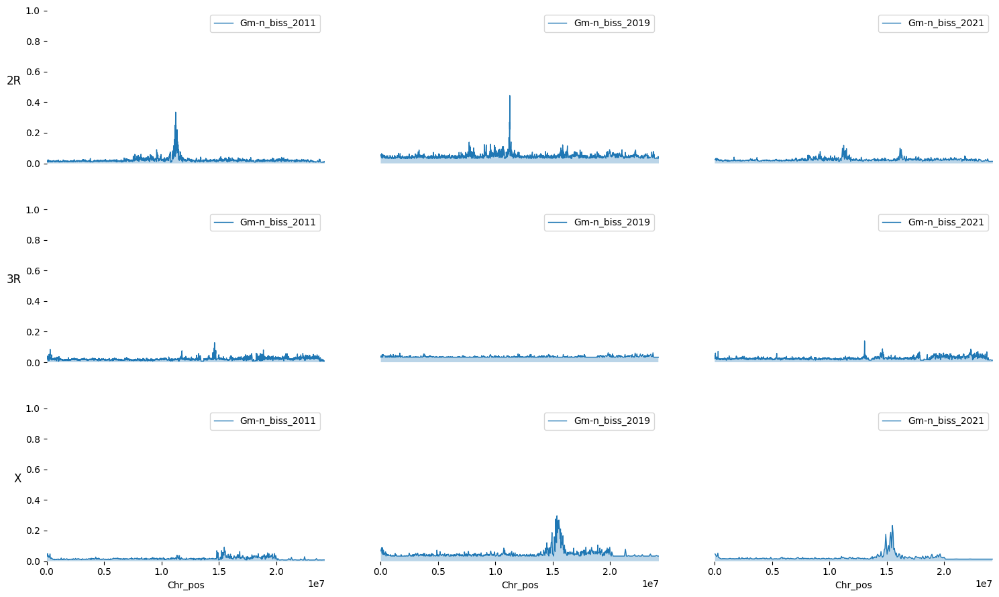

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.lines as lines

# Load your data
"""gambia_data = pd.read_csv('/content/gambiae_h12_GWSS_results.csv')
coluzzii_data = pd.read_csv('/content/coluzziih12_GWSS_results.csv')
bissau_data = pd.read_csv('/content/bissau_h12_GWSS_results.csv')
melas_data = pd.read_csv('/content/melash12_GWSS_results (1).csv')
arabiensis_data = pd.read_csv('/content/arabiensish12_GWSS_results.csv')
final_h12_df = pd.concat([gambia_data, coluzzii_data, bissau_data, melas_data, arabiensis_data])"""
biss_2011 = pd.read_csv('/content/bissau_GM-N_biss_2011_h12_GWSS_results.csv')
biss_2019 = pd.read_csv('/content/bissau_GM-N_biss_2019_h12_GWSS_results.csv')
biss_2021 = pd.read_csv('/content/bissau_GM-N_biss_2021_h12_GWSS_results.csv')
final_h12_df = pd.concat([biss_2011, biss_2019,biss_2021 ])
data = final_h12_df # Replace with your actual data source
data['chrom'] = data['chrom'].astype(str)

# Define cohorts and chromosomes
cohorts = data['Cohort'].unique()
chromosomes = data['chrom'].unique()

# Define helper function for chromosome structure
def plotChromLines(ax, start, end, contig_label):
    """
    Draw chromosome structure on the bottom panel.
    """
    ax.add_line(lines.Line2D([start, end], [4, 6], color='#36454F', linewidth=3))
    ax.add_line(lines.Line2D([start, start + 5_000_000], [4.5, 4], color='#36454F', linewidth=3))
    ax.add_line(lines.Line2D([end, end - 5_000_000], [4.5, 4], color='#36454F', linewidth=3))
    ax.text((start + end) / 2, 6.5, contig_label, fontsize=14, ha='center')

# Set up the figure and subplots
fig, axes = plt.subplots(len(chromosomes), len(cohorts), figsize=(15, len(chromosomes) * 3))

# Gene annotation positions
annotations = {
    '2L': {'2e6': 'Vgsc', '2.85e7': 'COEAE2F\n Aldehyde oxydase\n AGAP006238'},
    '2R': {'2.85e7': 'CYP450', '1.8e7': 'NADPH'},
    '3R': {'2e7': 'Gste2'},
    '3L': {'1.50e7': 'Unknows', '1.98e7': 'AGAP011231'},
    'X': {'1.5e7': 'CPR125\n Cyp9k1'}
}
gambiae_annotations = {
    '2L': {'2e6': 'Vgsc', '2.85e7': 'COEAE2F\n Aldehyde oxydase\n AGAP006238'},
    '2R': {'2.85e7': 'COEAE6O\n CYP450', '6.1e7': 'Unknows'},
    '3R': {'2.85e7': 'GSTEs'},
    '3L': {'1.50e7': 'Unknow'},
    'X': {'1.5e7': 'CPR125\n Cyp9k1'}
}
arabiensis_annotations = {
    '2R': {'2.85e7': 'COEAE6O\n CYP450', '4.08e7': 'SP8905'}
}
coluzzii_annotations = {
    '2L': {'2e6': 'Vgsc', '2.2e7': ' E3 ubiquitin-protein\n\n, fumarylacetoacetase'},
    '2R': {'1.8e7': 'Pex16\n \nAGAP002284', '2.85e7': 'CYP450'},
    '3R': {'2.85e7': 'GSTEs'},
    '3L': {'1.50e7': 'Unknow'},
    'X': {'1.5e7': 'CPR125\n Cyp9k1'}
}
bissau_annotations = {
    '2L': {'2e6': 'Vgsc', '1.1e7': 'Unknow', '2.1e7': 'Unknows','2.59e7': 'Unknows'},
    '2R': {'2.85e7': 'CYP450'},
    '3R': {'2.85e7': 'GSTEs', '3.2e7': 'ORs'},
    '3L': {'1.50e7': 'Unknow'},
    'X': {'1.5e7': 'CPR125\n Cyp9k1'}
}

# Adjust axes to 2D array if needed
if len(chromosomes) > 1:
    axes = axes.reshape(len(chromosomes), len(cohorts))

# Plot for each chromosome
for row_idx, chrom in enumerate(chromosomes):
    chrom_data = data[data['chrom'] == chrom]
    max_bp = chrom_data['Chr_pos'].max()

    for col_idx, cohort in enumerate(cohorts):
        ax = axes[row_idx][col_idx] if len(chromosomes) > 1 else axes[col_idx]
        cohort_data = chrom_data[chrom_data['Cohort'] == cohort]

        # Plot H12 as a line plot
        sns.lineplot(
            x=cohort_data['Chr_pos'],
            y=cohort_data['H12'],
            ax=ax,
            #label=f"{chrom}",  # Add chromosome label for legend
            label = (
              fr"$\it{{An.\ {cohort}\ s.s.}}$"
              if cohort == 'gambiae'
              else (fr"$\it{{An.\ {cohort}}}$" if cohort == 'coluzzii' else f"{cohort.capitalize()}"))
            ,
            linewidth=1
        )
        ax.fill_between(cohort_data['Chr_pos'], cohort_data['H12'], alpha=0.3, label=f"{chrom} (H12)")

        # Configure axes
        ax.set_xlim(0, max_bp)
        ax.set_ylim(0, 1)


        if col_idx == 0:
          #ax.set_ylabel(cohort, rotation=0, ha='right', fontsize=12)
          ax.set_ylabel(chrom, rotation=0, ha='right', fontsize=12)
        else:
          ax.get_yaxis().set_visible(False)
        sns.despine(ax=ax, top=True, right=True, left=True, bottom=True)
        if row_idx < len(chromosomes) - 1:
            ax.get_xaxis().set_visible(False)

        # Annotate key loci and plot points
        # Manual annotations
        if cohort == 'gambiae':
          for pos, label in gambiae_annotations[chrom].items():
            if chrom != '3L':
              ax.text(float(pos) , 0.6, label, fontsize=10, ha='center', color='brown')
              ax.scatter([float(pos)], [0.5], color='brown', s=10, zorder=3)
        if cohort == 'coluzzii':
          for pos, label in coluzzii_annotations[chrom].items():
            if chrom != '3L' and chrom !='3R':
              if coluzzii_annotations[chrom][pos] == 'CYP450':
                ax.text(float(pos) , 0.5, label, fontsize=10, ha='center', color='brown')
                ax.scatter([float(pos)], [0.4], color='brown', s=10, zorder=3)
              else:
                ax.text(float(pos) , 0.6, label, fontsize=10, ha='center', color='brown')
                ax.scatter([float(pos)], [0.5], color='brown', s=10, zorder=3)

        if cohort == 'bissau':
          for pos, label in bissau_annotations[chrom].items():
            if chrom != '3L' and chrom != '2L':
              if bissau_annotations[chrom][pos] == 'ORs':
                  ax.text(float(pos) , 0.5, label, fontsize=10, ha='center', color='brown')
                  ax.scatter([float(pos)], [0.4], color='brown', s=10, zorder=3)
              else:
                  ax.text(float(pos) , 0.6, label, fontsize=10, ha='center', color='brown')
                  ax.scatter([float(pos)], [0.5], color='brown', s=10, zorder=3)
        if cohort == 'arabiensis':
          if chrom not in ['2L', '3R', '3L', 'X']:
            for pos, label in arabiensis_annotations[chrom].items():
              if arabiensis_annotations[chrom][pos] == 'SP8905':
                ax.text(float(pos) , 0.5, label, fontsize=10, ha='center', color='brown')
                ax.scatter([float(pos)], [0.4], color='brown', s=10, zorder=3)
              else:
                ax.text(float(pos) , 0.6, label, fontsize=10, ha='center', color='brown')
                ax.scatter([float(pos)], [0.5], color='brown', s=10, zorder=3)



# Adjust layout
plt.tight_layout()
plt.subplots_adjust(hspace=0.3, wspace=0.2)

# Save the combined plot
plt.savefig(f'h12_plot.png', dpi=300)
plt.savefig(f'h12_plot.pdf', dpi=300)
plt.show()


<ipython-input-12-a803b8cc2d5f>:35: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(['{:,}'.format(int(v)) for v in ax.get_xticks()])


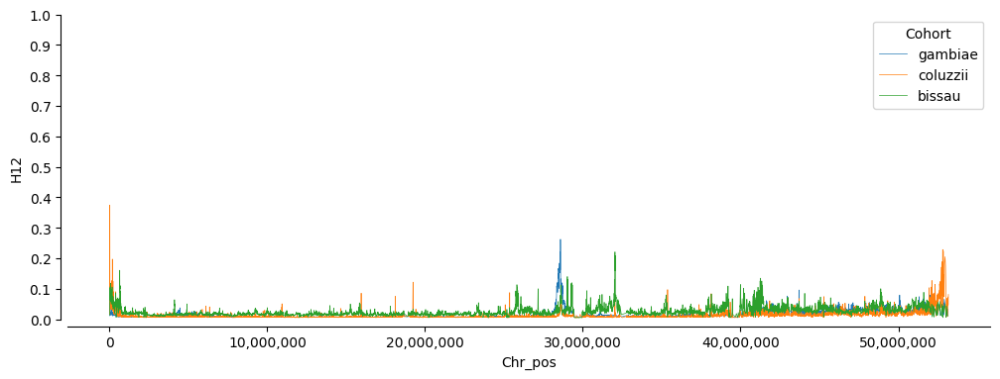

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

def plot_fst_year(data=df, figsize=(12,4), ax=None, title=None, xlab=None,
                  ylab=None, legend_loc=None, fig_name=None):

    if ax is None:
        fig, ax = plt.subplots(figsize=figsize)
        sns.despine(ax=ax, offset=5)

    # Plot FST
    sns.lineplot(x='Chr_pos', y='H12', hue='Cohort', data=data, ax=ax, linewidth=0.5)

    # Set axis titles
    if title:
        ax.set_title(title)
    if xlab:
        ax.set_xlabel(xlab)
    if ylab:
        ax.set_ylabel(ylab)

    # Set legend
    if legend_loc:
        ax.legend(loc='best', bbox_to_anchor=legend_loc)

    # Set axis limits
    #xlim = [xlim1[0], xlim1[-1]]
    #ax.set_xlim(*xlim)
    #ax.set_ylim(0, 1)  # Change y-axis range from 0 to 1
    ax.set_ylim(0,0.25)
    #ax.set_yticks([i / 20 for i in range(21)])  # Set ticks at 0.05 intervals (0, 0.05, 0.10, ..., 1.0)
    ax.set_yticks([i / 10 for i in range(11)])

    # Format x-axis tick labels
    ax.set_xticklabels(['{:,}'.format(int(v)) for v in ax.get_xticks()])

    # Save figure
    if fig_name:
        fig.savefig(f"{fig_name}.png", dpi=300, bbox_inches='tight')

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load your data (modify this to match your actual file structure)
gambia_data = pd.read_csv('/content/gambiae_h12_GWSS_results.csv')
coluzzii_data = pd.read_csv('/content/coluzzii_h12_GWSS_results.csv')
bissau_data = pd.read_csv('/content/bissau_h12_GWSS_results.csv')
#melas_data = pd.read_csv('/content/melash12_GWSS_results.csv')
#arabiensis_data = pd.read_csv('/content/arabiensish12_GWSS_results.csv')
final_h12_df = pd.concat([gambia_data, coluzzii_data, bissau_data])#, melas_data, arabiensis_data])
df = final_h12_df.query('chrom=="3R"')
df

plot_fst_year(data=df, figsize=(12,4), ax=None, title=None, xlab=None,
                  ylab=None, legend_loc=None, fig_name=None)

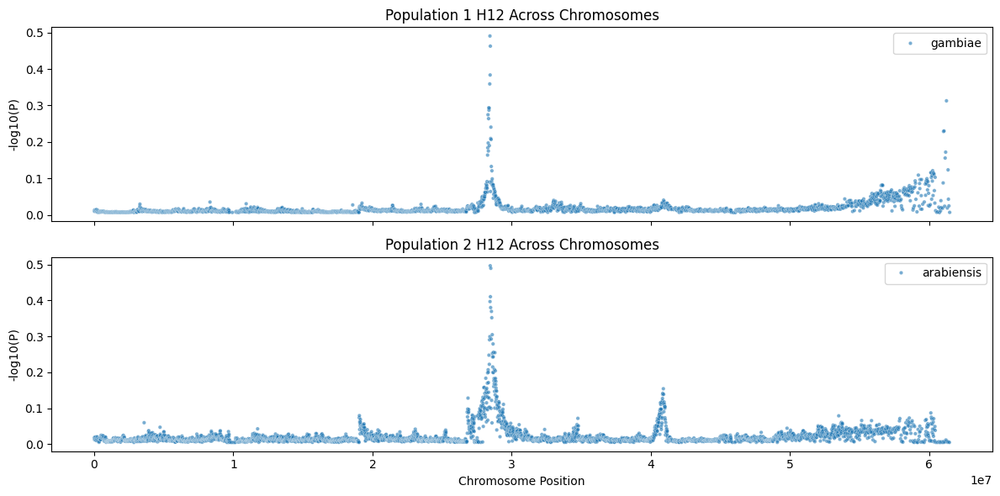

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

def plot_h12_two_pops(data1, data2, figsize=(12, 6), title=None, xlab="Chromosome Position",
                      ylab="-log10(P)", legend_loc="best", fig_name=None):
    """
    Plot H12 values for two populations in a Manhattan-style plot.

    Parameters:
    data1 (pd.DataFrame): Data for the first population with 'Chr_pos' and 'H12' columns.
    data2 (pd.DataFrame): Data for the second population with 'Chr_pos' and 'H12' columns.
    figsize (tuple): Size of the figure.
    title (str): Title of the plot.
    xlab (str): Label for x-axis.
    ylab (str): Label for y-axis.
    legend_loc (str): Location of the legend.
    fig_name (str): Name of the file to save the figure.
    """

    fig, axs = plt.subplots(2, 1, figsize=figsize, sharex=True, gridspec_kw={'height_ratios': [1, 1]})

    # Top plot (first population)
    sns.scatterplot(x='Chr_pos', y='H12', hue='Cohort', data=data1, ax=axs[0], s=10, alpha=0.6)
    axs[0].set_title(f"Population 1 {title}" if title else "Population 1")
    axs[0].set_ylabel(ylab)
    axs[0].legend(loc=legend_loc)

    # Bottom plot (second population)
    sns.scatterplot(x='Chr_pos', y='H12', hue='Cohort', data=data2, ax=axs[1], s=10, alpha=0.6)
    axs[1].set_title(f"Population 2 {title}" if title else "Population 2")
    axs[1].set_xlabel(xlab)
    axs[1].set_ylabel(ylab)
    axs[1].legend(loc=legend_loc)
    #axs[1].set_ylim(axs[0].get_ylim())  # Set y-axis limits to match top plot

    # Adjust layout
    plt.tight_layout()

    # Save figure if filename is provided
    if fig_name:
        plt.savefig(f"{fig_name}.png", dpi=300, bbox_inches='tight')

    plt.show()

# Example usage with two datasets (replace df1 and df2 with your data)
df1 = pd.read_csv('/content/gambiae_h12_GWSS_results.csv')
df2 = pd.read_csv('/content/arabiensish12_GWSS_results.csv')

"""GM_L_h12_df = pd.read_csv('/content/coluzzii_GM-L_h12_GWSS_results.csv')
GM_M_h12_df = pd.read_csv('/content/coluzzii_GM-M_h12_GWSS_results.csv')
GM_N_H12_df = pd.read_csv('/content/coluzzii_GM-N_h12_GWSS_results.csv')
GM_U_h12_df = pd.read_csv('/content/coluzzii_GM-U_h12_GWSS_results.csv')
GM_W_h12_df = pd.read_csv('/content/coluzzii_GM-W_h12_GWSS_results.csv')"""
chr="2R"
plot_h12_two_pops(data1=df1.query(f"chrom=='{chr}'"), data2=df2.query(f"chrom=='{chr}'"), title="H12 Across Chromosomes")


In [ ]:
#list of gene for region under selection in 2L chromosome in gambiae taxon
genes_list = (
    ag3.genome_features(region=["2R", "2L","3R", "3L", "X"]).query("type!='chromosome'")
    [["contig", "ID", "start", "end", "Name", "description","type"]]
    .set_index("ID")
)

# Add
genes_list
genes_list.reset_index(inplace=True)
genes_list.to_csv('genes_list.csv', index=False)
#Save in rda format
"""# get dict of ID and Name
gene_dict = genes_list.set_index('ID')['Name'].to_dict()
gene_dict
gene_dict = genes_list['Name'].to_dict()
gene_dict
# remove na value
gene_dict = {k: v for k, v in gene_dict.items() if not pd.isna(v)}
gene_dict"""

,ID,contig,start,end,Name,description,type
0,AGAP004677,2L,157348,186936,NaN,methylenetetrahydrofolate dehydrogenase(NAD ) ...,gene
1,AGAP004677-RA,2L,157348,181305,NaN,NaN,mRNA
2,NaN,2L,157348,157495,NaN,NaN,three_prime_UTR
3,NaN,2L,157348,157623,AGAP004677-RB-E4,NaN,exon
4,AGAP004677-RB,2L,157348,186936,NaN,NaN,mRNA
...,...,...,...,...,...,...,...
191386,AGAP028967-RA,X,24359754,24359921,NaN,NaN,rRNA
191387,NaN,X,24359754,24359921,AGAP028967-RA-E1,NaN,exon
191388,AGAP028974,X,24390339,24391011,LSU_rRNA_eukarya,Eukaryotic large subunit ribosomal RNA [Source...,ncRNA_gene
191389,AGAP028974-RA,X,24390339,24391011,NaN,NaN,rRNA


In [ ]:
ag3.plot_genes(region="2L")

In [ ]:
import pandas as pd

h12_data = pd.read_csv('/content/arabiensish12_GWSS_results.csv')
#h12_data = h12_data.query('chrom=="2R"')
h12_data = h12_data.rename(columns={
    "chrom": "contig",
    "Chr_pos": "position",
    "H12": "H12"
})
h12_data
genes_list.query("Name=='COEAE2F'")
#gene_list = pd.read_csv('/content/genes_list.csv')

# Step 1: Merge H12 data with gene_list based on position match
def assign_gene_info(h12_df, gene_df):
    """
    For each H12 position, assign the gene ID and Name if it falls between start and end.
    """
    result = []
    for _, h12_row in h12_df.iterrows():
        chrom, pos = h12_row["contig"], h12_row["position"]

        # Find matching gene
        matching_genes = gene_df[
            (gene_df["contig"] == chrom) & (gene_df["start"] <= pos) & (gene_df["end"] >= pos)
        ]

        if not matching_genes.empty:
            for _, gene_row in matching_genes.iterrows():
                result.append({
                    "contig": chrom,
                    "position": pos,
                    "H12": h12_row["H12"],
                    "gene_id": gene_row["ID"],
                    "gene_name": gene_row["Name"],
                    "gene_description": gene_row["description"],
                    "type": gene_row["type"]
                })
        else:
            # No matching gene found
            result.append({
                "contig": chrom,
                "position": pos,
                "H12": h12_row["H12"],
                "gene_id": "No Gene",
                "gene_name": "No Gene",
                "gene_description": "No Gene"
            })

    return pd.DataFrame(result)

# Step 2: Run the function
h12_with_genes = assign_gene_info(h12_data, genes_list)
# Replace NaN in gene_name by gene_id
h12_with_genes['gene_name'].fillna(h12_with_genes['gene_id'], inplace=True)
# Display the result
h12_with_genes.query("contig=='2L'")

# save
h12_with_genes.to_csv('arabiensis_h12_with_genes.csv', index=False)
h12_with_genes

,contig,position,H12,gene_id,gene_name,gene_description,type
0,2L,7.127474e+04,0.00540,No Gene,No Gene,No Gene,NaN
1,2L,1.650170e+05,0.00565,AGAP004677,AGAP004677,methylenetetrahydrofolate dehydrogenase(NAD ) ...,gene
2,2L,1.650170e+05,0.00565,AGAP004677-RA,AGAP004677-RA,NaN,mRNA
3,2L,1.650170e+05,0.00565,AGAP004677-RB,AGAP004677-RB,NaN,mRNA
4,2L,2.258059e+05,0.00575,No Gene,No Gene,No Gene,NaN
...,...,...,...,...,...,...,...
45982,X,2.424633e+07,0.03485,AGAP001094,run,runt [Source:VB Community Annotation],gene
45983,X,2.424633e+07,0.03485,AGAP001094-RA,AGAP001094-RA,NaN,mRNA
45984,X,2.428542e+07,0.00515,No Gene,No Gene,No Gene,NaN
45985,X,2.433253e+07,0.00515,No Gene,No Gene,No Gene,NaN


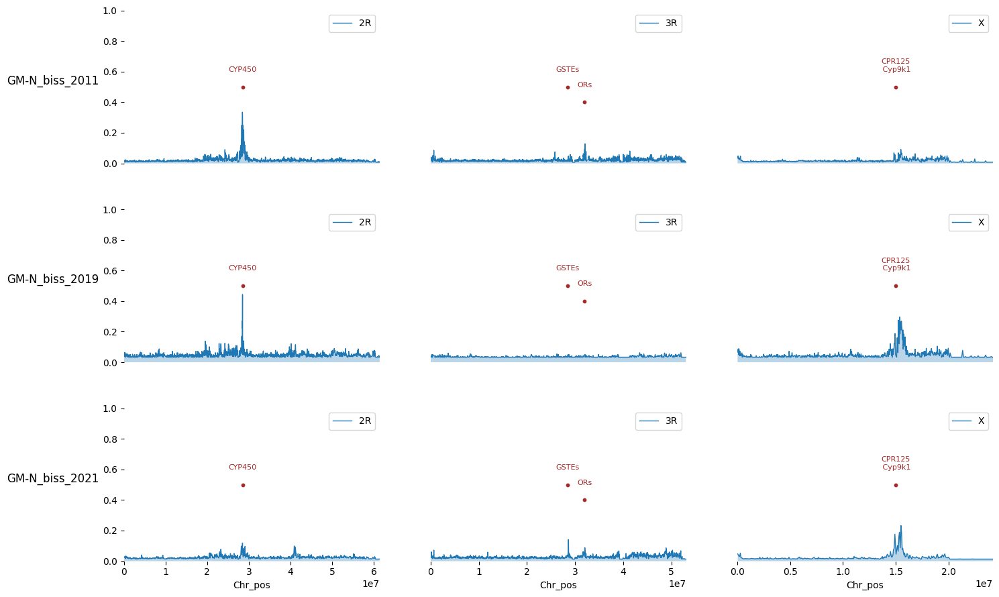

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.lines as lines

# Load your data
"""cohort_A = pd.read_csv('/content/bissau_GM-M_h12_GWSS_results.csv')
cohort_B = pd.read_csv('/content/bissau_GM-N_h12_GWSS_results.csv')
cohort_C = pd.read_csv('/content/bissau_GM-W_h12_GWSS_results.csv')
cohort1 = pd.read_csv('/content/bissau_GM-M_biss_2019_h12_GWSS_results.csv')
cohort2 = pd.read_csv('/content/bissau_GM-N_biss_2011_h12_GWSS_results.csv')
cohort3 = pd.read_csv('/content/bissau_GM-N_biss_2019_h12_GWSS_results.csv')
cohort4 = pd.read_csv('/content/bissau_GM-N_biss_2021_h12_GWSS_results.csv')
cohort5 = pd.read_csv('/content/bissau_GM-W_biss_2019_h12_GWSS_results.csv')
h12_region = pd.concat([cohort_A, cohort_B, cohort_C])
h12_year_df = pd.concat([cohort1, cohort2, cohort3, cohort4, cohort5])
h12_year_df = sorted_H12_data(h12_year_df)
final_h12_df = pd.concat([h12_region, h12_year_df])

gambia_data = pd.read_csv('/content/gambiae_h12_GWSS_results.csv')
coluzzii_data = pd.read_csv('/content/coluzzii_h12_GWSS_results.csv')
bissau_data = pd.read_csv('/content/bissau_h12_GWSS_results.csv')
melas_data = pd.read_csv('/content/melash12_GWSS_results (1).csv')
arabiensis_data = pd.read_csv('/content/arabiensish12_GWSS_results.csv')
final_h12_df = pd.concat([gambia_data, coluzzii_data, bissau_data, melas_data, arabiensis_data])"""
biss_2011 = pd.read_csv('/content/bissau_GM-N_biss_2011_h12_GWSS_results.csv')
biss_2019 = pd.read_csv('/content/bissau_GM-N_biss_2019_h12_GWSS_results.csv')
biss_2021 = pd.read_csv('/content/bissau_GM-N_biss_2021_h12_GWSS_results.csv')
final_h12_df = pd.concat([biss_2011, biss_2019,biss_2021 ])
data = final_h12_df  # Replace with your actual DataFrame
data['chrom'] = data['chrom'].astype(str)
# Define cohorts and chromosomes
cohorts = data['Cohort'].unique()
chromosomes = data['chrom'].unique()
# Gene annotation positions

gambiae_annotations = {
    '2L': {'2e6': 'Vgsc', '2.85e7': 'COEAE2F\n Aldehyde oxydase\n AGAP006238'},
    '2R': {'2.85e7': 'COEAE6O\n CYP450', '6.1e7': 'Unknows'},
    '3R': {'2.85e7': 'GSTEs'},
    '3L': {'1.50e7': 'Unknow'},
    'X': {'1.5e7': 'CPR125\n Cyp9k1'}
}
coluzzii_annotations = {
    '2L': {'2e6': 'Vgsc', '2.2e7': ' E3 ubiquitin-protein\n\n, fumarylacetoacetase'},
    '2R': {'1.8e7': 'Pex16\n \nAGAP002284', '2.85e7': 'CYP450'},
    '3R': {'2.85e7': 'GSTEs'},
    '3L': {'1.50e7': 'Unknow'},
    'X': {'1.5e7': 'CPR125\n Cyp9k1'}
}
bissau_annotations = {
    '2L': {'2e6': 'Vgsc', '1.1e7': 'Unknow', '2.1e7': 'Unknows','2.59e7': 'Unknows'},
    '2R': {'2.85e7': 'CYP450'},
    '3R': {'2.85e7': 'GSTEs', '3.2e7': 'ORs'},
    '3L': {'1.50e7': 'Unknow'},
    'X': {'1.5e7': 'CPR125\n Cyp9k1'}
}

# Define helper function to draw chromosome lines
def plotChromLines(ax, start, end, contig_label):
    """
    Draw chromosome structure on the bottom panel.
    """
    ax.add_line(lines.Line2D([start, end], [4, 6], color='#36454F', linewidth=3))
    ax.add_line(lines.Line2D([start, start + 5_000_000], [4.5, 4], color='#36454F', linewidth=3))
    ax.add_line(lines.Line2D([end, end - 5_000_000], [4.5, 4], color='#36454F', linewidth=3))
    ax.text((start + end) / 2, 6.5, contig_label, fontsize=14, ha='center')

# Set up the figure and subplots
fig, axes = plt.subplots(len(cohorts), len(chromosomes), figsize=(15, len(cohorts) * 3), sharex='col', sharey='row')

# Plot for each cohort (row) and chromosome (column)
for row_idx, cohort in enumerate(cohorts):
    cohort_data = data[data['Cohort'] == cohort]
    for col_idx, chrom in enumerate(chromosomes):
        chrom_data = cohort_data[cohort_data['chrom'] == chrom]
        max_bp = chrom_data['Chr_pos'].max()

        # Select the appropriate subplot
        ax = axes[row_idx, col_idx] if len(cohorts) > 1 else axes[col_idx]

        # Plot H12 as a line plot
        sns.lineplot(
            x=chrom_data['Chr_pos'],
            y=chrom_data['H12'],
            ax=ax,
            label=f"{chrom}",  # Add chromosome label for legend
            linewidth=1
        )
        ax.fill_between(chrom_data['Chr_pos'], chrom_data['H12'], alpha=0.3, label=f"{chrom} (H12)")

        # Configure axes
        ax.set_xlim(0, max_bp if pd.notna(max_bp) else 1)
        ax.set_ylim(0, 1)
        if col_idx == 0:
            #reformated_cohort = fr"$\it{{An.\ {cohort}\ s.s.}}$" if cohort == 'gambiae' else (fr"$\it{{An.\ {cohort}}}$" if cohort == 'coluzzii' else f"{cohort.capitalize()}")
            ax.set_ylabel(cohort, rotation=0, ha='right', fontsize=12)
        else:
            ax.get_yaxis().set_visible(False)

        sns.despine(ax=ax, top=True, right=True, left=True, bottom=True)
        if row_idx < len(cohorts) - 1:
            ax.get_xaxis().set_visible(False)

        # Add a legend for each chromosome
        """if row_idx == 0:
            ax.set_title(chrom, fontsize=14)"""
                # Annotate key loci and plot points
        # Manual annotations
        if cohort == 'gambiae':
          for pos, label in gambiae_annotations[chrom].items():
            if chrom != '3L':
              ax.text(float(pos) , 0.6, label, fontsize=8, ha='center', color='brown')
              ax.scatter([float(pos)], [0.5], color='brown', s=10, zorder=3)
        if cohort == 'coluzzii':
          for pos, label in coluzzii_annotations[chrom].items():
            if chrom != '3L' and chrom !='3R':
              if coluzzii_annotations[chrom][pos] == 'CYP450':
                ax.text(float(pos) , 0.5, label, fontsize=8, ha='center', color='brown')
                ax.scatter([float(pos)], [0.4], color='brown', s=10, zorder=3)
              else:
                ax.text(float(pos) , 0.6, label, fontsize=8, ha='center', color='brown')
                ax.scatter([float(pos)], [0.5], color='brown', s=10, zorder=3)

        #if cohort == 'bissau':
        else:
          for pos, label in bissau_annotations[chrom].items():
            if chrom != '3L' and chrom != '2L':
              if bissau_annotations[chrom][pos] == 'ORs':
                  ax.text(float(pos) , 0.5, label, fontsize=8, ha='center', color='brown')
                  ax.scatter([float(pos)], [0.4], color='brown', s=10, zorder=3)
              else:
                  ax.text(float(pos) , 0.6, label, fontsize=8, ha='center', color='brown')
                  ax.scatter([float(pos)], [0.5], color='brown', s=10, zorder=3)

# Adjust layout
plt.tight_layout()
plt.subplots_adjust(hspace=0.3, wspace=0.2)
#plt.subplots_adjust(left=0.1, bottom=0.5)  # Adjust values as needed
# Save the combined plot
plt.savefig('h12_by_cohort_and_chromosome.pdf', dpi=300)
plt.savefig('h12_by_cohort_and_chromosome.png', dpi=300)
plt.show()


<ipython-input-4-21e09d5759b4>:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(['{:,}'.format(int(v)) for v in ax.get_xticks()])


<Axes: xlabel='GenomeWide_pos', ylabel='H12'>

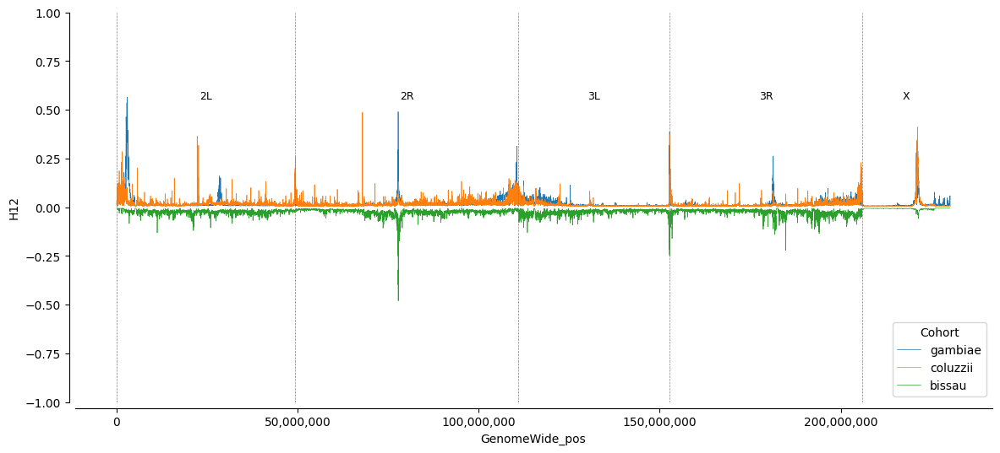

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

def plot_fst_year(data, figsize=(14, 6), ax=None, title=None, xlab=None,
                  ylab=None, legend_loc=None, fig_name=None):

    if ax is None:
        fig, ax = plt.subplots(figsize=figsize)
        sns.despine(ax=ax, offset=5)

    # Compute cumulative genome-wide positions
    data = data.copy()
    chr_offsets = {}
    cumulative_position = 0

    for chr_name in sorted(data['chrom'].unique()):  # Ensure sorted chromosomes
        chr_data = data[data['chrom'] == chr_name]
        min_pos = chr_data['Chr_pos'].min()
        data.loc[data['chrom'] == chr_name, 'GenomeWide_pos'] = chr_data['Chr_pos'] - min_pos + cumulative_position
        chr_offsets[chr_name] = cumulative_position
        cumulative_position = data.loc[data['chrom'] == chr_name, 'GenomeWide_pos'].max() + 1  # Add offset for next chr

    # Plot FST
    sns.lineplot(x='GenomeWide_pos', y='H12', hue='Cohort', data=data, ax=ax, linewidth=0.5)

    # Set axis titles
    if title:
        ax.set_title(title)
    if xlab:
        ax.set_xlabel(xlab)
    if ylab:
        ax.set_ylabel(ylab)

    # Add chromosome separators and labels
    for chr_name, pos in chr_offsets.items():
        ax.axvline(pos, color='gray', linestyle='--', linewidth=0.5)
        mid_pos = pos + (data[data['chrom'] == chr_name]['GenomeWide_pos'].max() - pos) / 2
        ax.text(mid_pos, ax.get_ylim()[1] * 0.9, chr_name, ha='center', fontsize=9)

    # Format x-axis tick labels
    ax.set_xticklabels(['{:,}'.format(int(v)) for v in ax.get_xticks()])

    # Set legend
    if legend_loc:
        ax.legend(loc='best', bbox_to_anchor=legend_loc)

    # Set axis limits
    ax.set_ylim(-1, 1)

    # Save figure
    if fig_name:
        fig.savefig(f"{fig_name}.png", dpi=300, bbox_inches='tight')

    return ax

gambia_data = pd.read_csv('/content/gambiae_h12_GWSS_results.csv')
coluzzii_data = pd.read_csv('/content/coluzzii_h12_GWSS_results.csv')
bissau_data = pd.read_csv('/content/bissau_h12_GWSS_results.csv')
bissau_data['H12'] = bissau_data['H12'] * (-1)
#melas_data = pd.read_csv('/content/melash12_GWSS_results (1).csv')
#arabiensis_data = pd.read_csv('/content/arabiensish12_GWSS_results.csv')
final_h12_df = pd.concat([gambia_data, coluzzii_data, bissau_data])
plot_fst_year(data=final_h12_df)


<Axes: xlabel='GenomeWide_pos', ylabel='H12'>

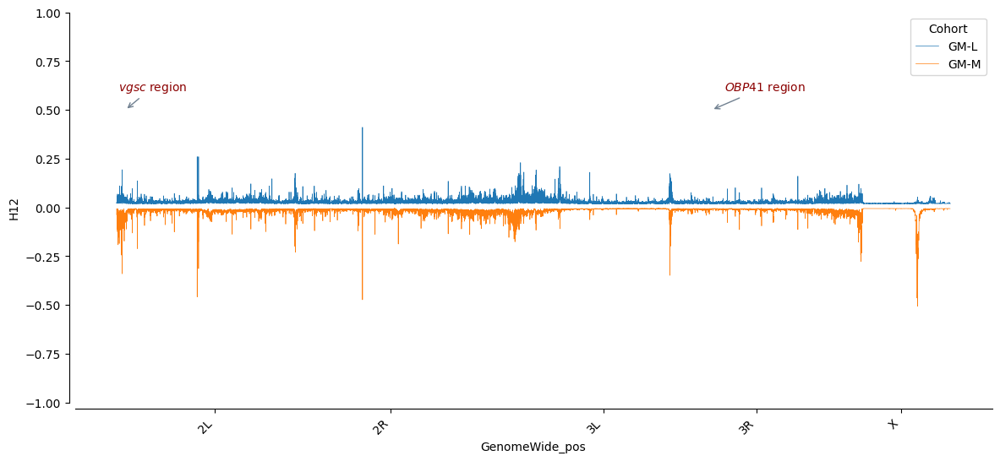

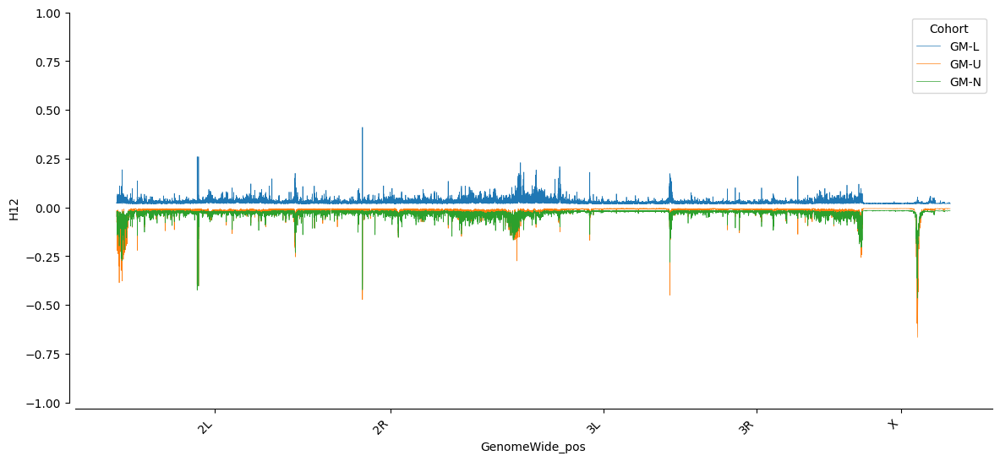

In [ ]:
from typing_extensions import final
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

def plot_fst_year(data, annotations=None, figsize=(14, 6), ax=None, title=None, xlab=None,
                  ylab=None, legend_loc=None, fig_name=None):

    if ax is None:
        fig, ax = plt.subplots(figsize=figsize)
        sns.despine(ax=ax, offset=5)

    # Sort chromosomes to ensure proper order
    chrom_order = sorted(data['chrom'].unique())

    # Assign new x-axis positions for chromosomes
    chr_ticks = []
    chr_positions = []
    cumulative_position = 0
    chr_offsets = {}

    for chrom in chrom_order:
        chr_data = data[data['chrom'] == chrom].copy()
        chr_data['GenomeWide_pos'] = chr_data['Chr_pos'] - chr_data['Chr_pos'].min() + cumulative_position
        data.loc[data['chrom'] == chrom, 'GenomeWide_pos'] = chr_data['GenomeWide_pos']

        # Save midpoint for labeling
        mid_pos = chr_data['GenomeWide_pos'].median()
        chr_positions.append(mid_pos)
        chr_ticks.append(chrom)

        # Store offset for annotation mapping
        chr_offsets[chrom] = cumulative_position

        # Update cumulative position
        cumulative_position = chr_data['GenomeWide_pos'].max() + 1

    # Plot FST
    sns.lineplot(x='GenomeWide_pos', y='H12', hue='Cohort', data=data, ax=ax, linewidth=0.5)

    # Set custom x-ticks
    ax.set_xticks(chr_positions)
    ax.set_xticklabels(chr_ticks, rotation=45, ha="right")

    # Set axis titles
    if title:
        ax.set_title(title)
    if xlab:
        ax.set_xlabel(xlab)
    if ylab:
        ax.set_ylabel(ylab)

    # Add annotations if provided
    if annotations:
        for label, chrom, pos, text_x, text_y in annotations:
            if chrom in chr_offsets:
                genome_pos = pos - data[data['chrom'] == chrom]['Chr_pos'].min() + chr_offsets[chrom]
                text_x_adj = text_x - data[data['chrom'] == chrom]['Chr_pos'].min() + chr_offsets[chrom]

                ax.annotate(label, xy=(genome_pos, text_y), xytext=(text_x_adj, text_y + 0.1),
                            color='darkred', arrowprops=dict(arrowstyle="->", color='slategrey'))

    # Set legend
    if legend_loc:
        ax.legend(loc='best', bbox_to_anchor=legend_loc)

    # Set y-axis limits
    ax.set_ylim(-1, 1)

    # Save figure
    if fig_name:
        fig.savefig(f"{fig_name}.png", dpi=300, bbox_inches='tight')

    return ax

# Example usage
annotations = [
    ('$vgsc$ region', '2L', 2431617, 500000,0.5),
    ('$OBP41$ region', '3R', 11551855.5, 15000000, 0.5)
]

# df should contain columns: 'chrom' (chromosome name), 'Chr_pos' (position), 'H12' (FST value), and 'Cohort'
GM_L_h12_df = pd.read_csv('/content/coluzzii_GM-L_h12_GWSS_results.csv')
GM_M_h12_df = pd.read_csv('/content/coluzzii_GM-M_h12_GWSS_results.csv')
GM_U_h12_df = pd.read_csv('/content/coluzzii_GM-U_h12_GWSS_results.csv')
GM_N_H12_df = pd.read_csv('/content/coluzzii_GM-N_h12_GWSS_results.csv')
GM_M_h12_df['H12'] = GM_M_h12_df['H12'] * (-1)
GM_N_H12_df['H12'] = GM_N_H12_df['H12'] * (-1)
GM_U_h12_df['H12'] = GM_U_h12_df['H12'] * (-1)
final_h12_df = pd.concat([GM_L_h12_df, GM_M_h12_df])

plot_fst_year(data=final_h12_df, annotations=annotations)

final_h12_df_2 = pd.concat([GM_L_h12_df, GM_U_h12_df, GM_N_H12_df])
plot_fst_year(data=final_h12_df_2)


<Axes: xlabel='GenomeWide_pos', ylabel='H12'>

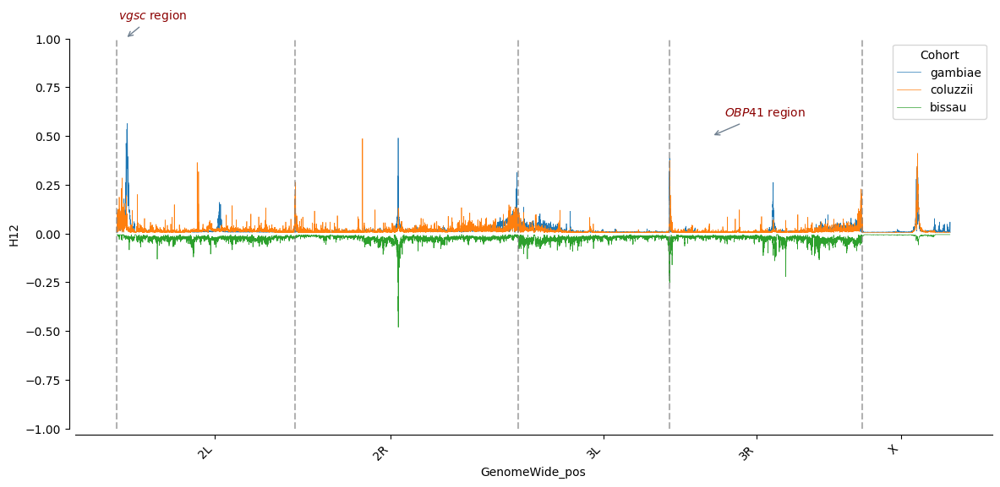

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

def plot_fst_year(data, annotations=None, figsize=(14, 6), ax=None, title=None, xlab=None,
                  ylab=None, legend_loc=None, fig_name=None):

    if ax is None:
        fig, ax = plt.subplots(figsize=figsize)
        sns.despine(ax=ax, offset=5)

    # Sort chromosomes to ensure proper order
    chrom_order = data['chrom'].unique()# Sort chromosomes properly

    # Assign new x-axis positions for chromosomes
    cumulative_position = 0
    chr_positions = []
    chr_boundaries = []
    chr_offsets = {}

    for chrom in chrom_order:
        chr_data = data[data['chrom'] == chrom].copy()
        chr_data['GenomeWide_pos'] = chr_data['Chr_pos'] - chr_data['Chr_pos'].min() + cumulative_position
        data.loc[data['chrom'] == chrom, 'GenomeWide_pos'] = chr_data['GenomeWide_pos']

        # Save chromosome midpoint for label placement
        mid_pos = chr_data['GenomeWide_pos'].median()
        chr_positions.append((chrom, mid_pos))

        # Store chromosome start position for boundary marking
        chr_boundaries.append(cumulative_position)
        chr_offsets[chrom] = cumulative_position

        # Update cumulative position
        cumulative_position = chr_data['GenomeWide_pos'].max() + 1

    # Plot FST
    sns.lineplot(x='GenomeWide_pos', y='H12', hue='Cohort', data=data, ax=ax, linewidth=0.5)

    # Add vertical lines to separate chromosomes
    for boundary in chr_boundaries:
        ax.axvline(x=boundary, color='gray', linestyle='dashed', alpha=0.6)

    # Set custom x-ticks with chromosome positions
    ax.set_xticks([pos for _, pos in chr_positions])
    ax.set_xticklabels([chrom for chrom, _ in chr_positions], rotation=45, ha="right")

    # Set axis titles
    if title:
        ax.set_title(title)
    if xlab:
        ax.set_xlabel(xlab)
    if ylab:
        ax.set_ylabel(ylab)

    # Add annotations
    if annotations:
        for label, chrom, pos, text_x, text_y in annotations:
            if chrom in chr_offsets:
                genome_pos = pos - data[data['chrom'] == chrom]['Chr_pos'].min() + chr_offsets[chrom]
                text_x_adj = text_x - data[data['chrom'] == chrom]['Chr_pos'].min() + chr_offsets[chrom]

                ax.annotate(label, xy=(genome_pos, text_y), xytext=(text_x_adj, text_y + 0.1),
                            color='darkred', arrowprops=dict(arrowstyle="->", color='slategrey'))

    # Set legend
    if legend_loc:
        ax.legend(loc='best', bbox_to_anchor=legend_loc)

    # Set y-axis limits
    ax.set_ylim(-1, 1)

    # Save figure
    if fig_name:
        fig.savefig(f"{fig_name}.png", dpi=300, bbox_inches='tight')

    return ax

# Example usage
annotations = [
    ('$vgsc$ region', '2L', 2431617, 600000, 1),
    ('$OBP41$ region', '3R', 11551855.5, 15000000, 0.5)
]

# Ensure 'final_h12_df' contains 'chrom', 'Chr_pos', 'H12', and 'Cohort'
plot_fst_year(data=final_h12_df, annotations=annotations)


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

def plot_H12(data, annotations=None, figsize=(15, 8), ax=None, title=None, xlab=None,
             ylab=None, legend_loc=(1, 1.25), fig_name=None):

    if ax is None:
        fig, ax = plt.subplots(figsize=figsize)
        sns.despine(ax=ax, offset=5)

    # Assign x-axis positions based on chromosome lengths
    cumulative_position = 0
    chr_positions = []
    chr_boundaries = []
    chr_offsets = {}

    for chrom in data['chrom'].unique():  # No sorting applied
        chr_data = data[data['chrom'] == chrom].copy()
        chr_min = chr_data['Chr_pos'].min()
        chr_max = chr_data['Chr_pos'].max()
        chr_length = chr_max - chr_min

        # Adjust chromosome positions
        chr_data['Chromosomes'] = chr_data['Chr_pos'] - chr_min + cumulative_position
        data.loc[data['chrom'] == chrom, 'Chromosomes'] = chr_data['Chromosomes']

        # Save midpoint for chromosome label
        mid_pos = cumulative_position + chr_length / 2
        chr_positions.append((chrom, mid_pos))

        # Save chromosome boundary
        chr_boundaries.append(cumulative_position)

        # Store chromosome start position
        chr_offsets[chrom] = cumulative_position

        # Update cumulative position
        cumulative_position += chr_length + 1  # Add buffer space

    # Define colors for the cohorts
    taxon_color = {
        'An. coluzzii': 'orange',
        'An. gambiae': 'blue',
        'Bissau': 'purple',
        'An. melas': 'green',
        'An. arabiensis': 'red'
    }

    # Plot H12 values
    sns.lineplot(x='Chromosomes', y='H12', hue='Cohort', palette=taxon_color, data=data, ax=ax, linewidth=0.5)

    # Add vertical lines to separate chromosomes
    for boundary in chr_boundaries:
        ax.axvline(x=boundary, color='gray', linestyle='dashed', alpha=0.40)

    # Set x-ticks to chromosome midpoints
    ax.set_xticks([pos for _, pos in chr_positions])
    ax.set_xticklabels([chrom for chrom, _ in chr_positions], rotation=45, ha="right")

    # Set axis titles with spacing
    if title:
        ax.set_title(title, pad=30, fontsize=14, fontweight='bold')  # Moves title higher
    if xlab:
        ax.set_xlabel(xlab, fontsize=12)
    if ylab:
        ax.set_ylabel(ylab, fontsize=12)

    # Add annotations
    if annotations:
        for label, chrom, pos, text_x, text_y, y_text_offset in annotations:
            if chrom in chr_offsets:
                genome_pos = pos - data[data['chrom'] == chrom]['Chr_pos'].min() + chr_offsets[chrom]
                text_x_adj = text_x - data[data['chrom'] == chrom]['Chr_pos'].min() + chr_offsets[chrom]

                ax.annotate(label,
                            xy=(genome_pos, text_y),
                            xytext=(text_x_adj, text_y + y_text_offset),
                            color='darkred',
                            fontsize=8,
                            arrowprops=dict(arrowstyle="->", color='slategrey'))

    # Set legend outside the plot area
    legend = ax.legend(loc='upper right', bbox_to_anchor=legend_loc, frameon=False)
    for text in legend.get_texts():
        if text.get_text() in ['An. coluzzii', 'An. gambiae', 'An. melas', 'An. arabiensis']:  # Apply italic only to these
          text.set_fontstyle('italic')
        text.set_fontweight('bold')

    # Set y-axis limits
    ax.set_ylim(-1, 1)

    # Save figure
    if fig_name:
        fig.savefig(f"{fig_name}.png", dpi=300, bbox_inches='tight')

    return ax


<Axes: xlabel='Chromosomes', ylabel='H12'>

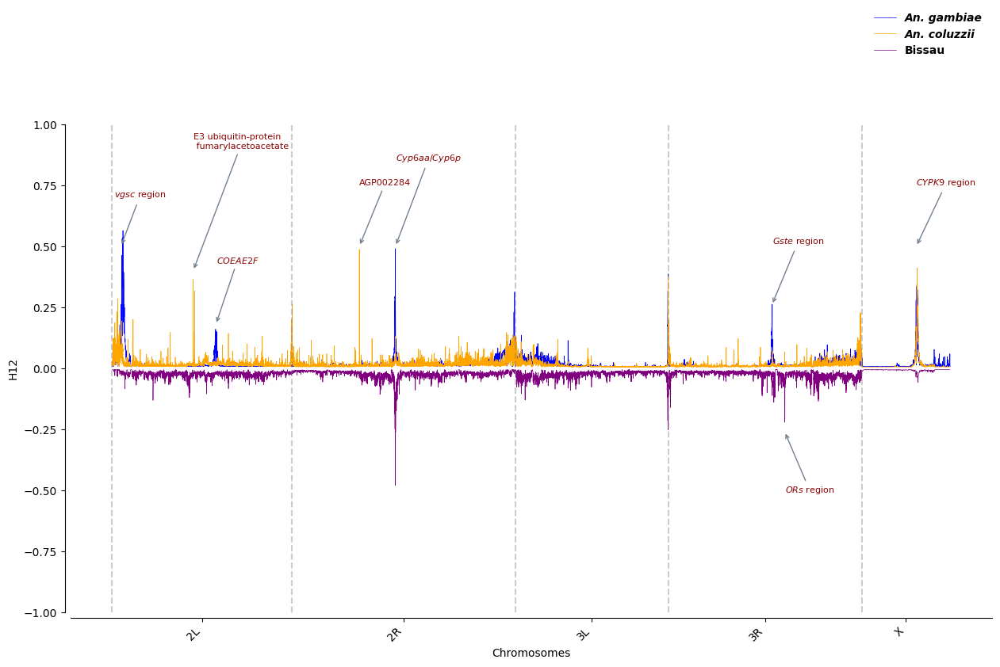

In [ ]:
#Annotations
annotations = [
    ('$vgsc$ region', '2L', 2431617, 600000, 0.5, 0.2),
    ('$Gste$ region', '3R', 28500000, 28600000, 0.26, 0.25),
    ('$Cyp6aa/Cyp6p$', '2R', 28500000, 28600000, 0.5, 0.35),
    ('$ORs$ region', '3R', 32000000, 32080000, -0.26, -0.25),
    ('$CYPK9$ region', 'X', 15000000, 15010000, 0.5, 0.25),
    ('$COEAE2F$', '2L', 28500000, 28600000, 0.18, 0.25),
    ('E3 ubiquitin-protein\n fumarylacetoacetate ','2L', 22281000,22283000, 0.40, 0.5),
    ('AGP002284', '2R', 18570000, 18600000, 0.5, 0.25)
]

# Load data
gambia_data = pd.read_csv('/content/gambiae_h12_GWSS_results.csv')
coluzzii_data = pd.read_csv('/content/coluzzii_h12_GWSS_results.csv')
bissau_data = pd.read_csv('/content/bissau_h12_GWSS_results.csv')
bissau_data['H12'] = bissau_data['H12'] * (-1)

# Combine data
final_h12_df = pd.concat([gambia_data, coluzzii_data, bissau_data])
final_h12_df['Cohort'] = final_h12_df['Cohort'].replace({
    'coluzzii': 'An. coluzzii',
    'bissau': 'Bissau',
    'gambiae': 'An. gambiae'
})

# Plot
plot_H12(data=final_h12_df, annotations=annotations, fig_name="GWSS_results")


<Axes: xlabel='Chromosomes', ylabel='H12'>

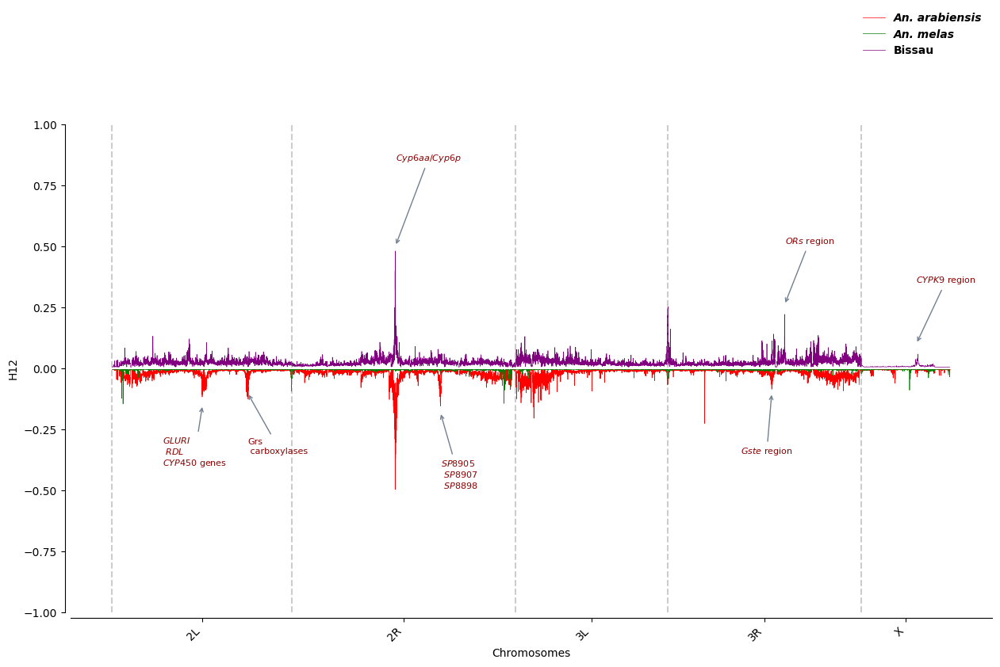

In [ ]:
arabiensis = pd.read_csv('/content/arabiensish12_GWSS_results.csv')
melas = pd.read_csv('/content/melash12_GWSS_results (1).csv')
gambiae = pd.read_csv('/content/gambiae_h12_GWSS_results.csv')
#coluzzii = pd.read_csv('/content/coluzzii_h12_GWSS_results.csv')
bissau_data = pd.read_csv('/content/bissau_h12_GWSS_results.csv')
melas['H12'] = melas['H12'] * (-1)
arabiensis['H12'] = arabiensis['H12'] * (-1)
#gambiae['H12'] = gambiae['H12'] * (-1)


final_h12_df = pd.concat([arabiensis,melas, bissau_data])
final_h12_df['Cohort'] = final_h12_df['Cohort'].replace({
    'arabiensis': 'An. arabiensis',
    'melas': 'An. melas',
    'gambiae': 'An. gambiae',
    'bissau': 'Bissau',
    'coluzzii': 'An. coluzzii'
})

annotations = [
    #('$vgsc$ region', '2L', 2431617, 600000, 0.5, 0.2),
    ('$Gste$ region', '3R', 28500000, 20000000, -0.10, -0.25),
    ('$Cyp6aa/Cyp6p$', '2R', 28500000, 28600000, 0.5, 0.35),
    ('$SP8905$ \n $SP8907$ \n $SP8898$ \n', '2R', 40850000, 40930000, -0.18, -0.35),
    ('$ORs$ region', '3R', 32000000, 32080000, 0.26, 0.25),
    ('$CYPK9$ region', 'X', 15050000, 15010000, 0.10, 0.25),
    #('$COEAE2F$', '2L', 28500000, 28600000, 0.18, 0.25),
    ('$GLURI$ \n $RDL$ \n$CYP450$ genes', '2L', 24882820, 14000000, -0.15,-0.25), #2L:25882820-24785920
    ('Grs\n carboxylases', '2L', 37200000,37300000, -0.10, -0.25)
    #('E3 ubiquitin-protein\n fumarylacetoacetate ','2L', 22281000,22283000, 0.40, 0.5),
    #('AGP002284 ', '2R', 18570000, 18600000, 0.5, 0.25)
]


plot_H12(data=final_h12_df, annotations=annotations,fig_name="GWSS_results_2")

<Axes: xlabel='Chromosomes', ylabel='H12'>

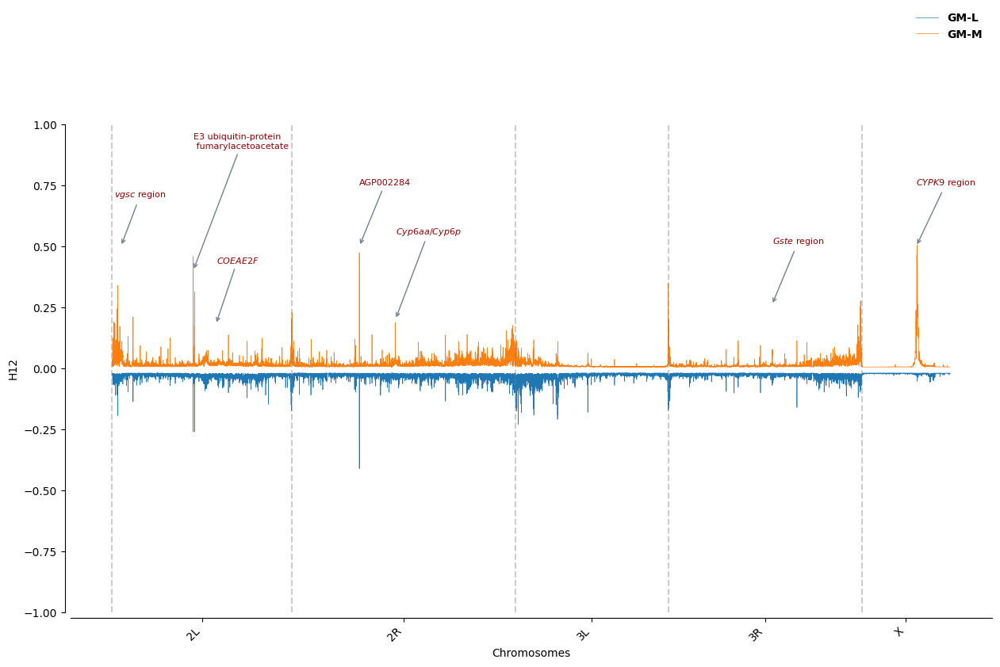

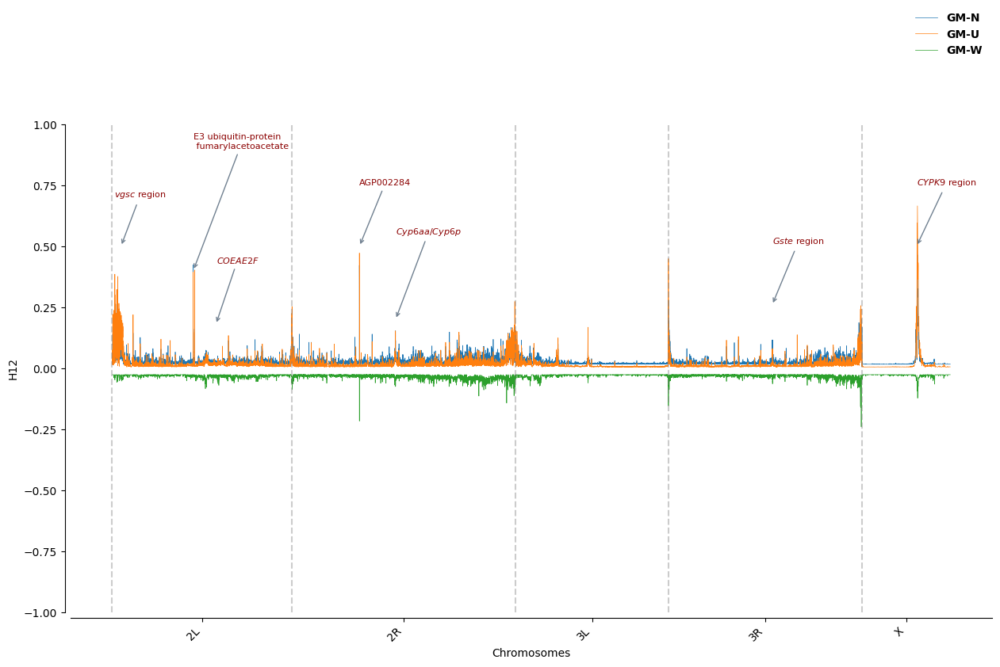

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

def plot_H12(data, annotations=None, figsize=(15, 8), ax=None, title=None, xlab=None,
             ylab=None, legend_loc=(1, 1.25), fig_name=None):

    if ax is None:
        fig, ax = plt.subplots(figsize=figsize)
        sns.despine(ax=ax, offset=5)

    # Assign x-axis positions based on chromosome lengths
    cumulative_position = 0
    chr_positions = []
    chr_boundaries = []
    chr_offsets = {}

    for chrom in data['chrom'].unique():  # No sorting applied
        chr_data = data[data['chrom'] == chrom].copy()
        chr_min = chr_data['Chr_pos'].min()
        chr_max = chr_data['Chr_pos'].max()
        chr_length = chr_max - chr_min

        # Adjust chromosome positions
        chr_data['Chromosomes'] = chr_data['Chr_pos'] - chr_min + cumulative_position
        data.loc[data['chrom'] == chrom, 'Chromosomes'] = chr_data['Chromosomes']

        # Save midpoint for chromosome label
        mid_pos = cumulative_position + chr_length / 2
        chr_positions.append((chrom, mid_pos))

        # Save chromosome boundary
        chr_boundaries.append(cumulative_position)

        # Store chromosome start position
        chr_offsets[chrom] = cumulative_position

        # Update cumulative position
        cumulative_position += chr_length + 1  # Add buffer space

    # Plot H12 values
    sns.lineplot(x='Chromosomes', y='H12', hue='Cohort', data=data, ax=ax, linewidth=0.5)

    # Add vertical lines to separate chromosomes
    for boundary in chr_boundaries:
        ax.axvline(x=boundary, color='gray', linestyle='dashed', alpha=0.40)

    # Set x-ticks to chromosome midpoints
    ax.set_xticks([pos for _, pos in chr_positions])
    ax.set_xticklabels([chrom for chrom, _ in chr_positions], rotation=45, ha="right")

    # Set axis titles with spacing
    if title:
        ax.set_title(title, pad=30, fontsize=14, fontweight='bold')  # Moves title higher
    if xlab:
        ax.set_xlabel(xlab, fontsize=12)
    if ylab:
        ax.set_ylabel(ylab, fontsize=12)

    # Add annotations
    if annotations:
        for label, chrom, pos, text_x, text_y, y_text_offset in annotations:
            if chrom in chr_offsets:
                genome_pos = pos - data[data['chrom'] == chrom]['Chr_pos'].min() + chr_offsets[chrom]
                text_x_adj = text_x - data[data['chrom'] == chrom]['Chr_pos'].min() + chr_offsets[chrom]

                ax.annotate(label,
                            xy=(genome_pos, text_y),
                            xytext=(text_x_adj, text_y + y_text_offset),
                            color='darkred',
                            fontsize=8,
                            arrowprops=dict(arrowstyle="->", color='slategrey'))

    # Set legend outside the plot area
    legend = ax.legend(loc='upper right', bbox_to_anchor=legend_loc, frameon=False)
    for text in legend.get_texts():
        if text.get_text() in ['An. coluzzii', 'An. gambiae', 'An. melas', 'An. arabiensis']:  # Apply italic only to these
          text.set_fontstyle('italic')
        text.set_fontweight('bold')

    # Set y-axis limits
    ax.set_ylim(-1, 1)

    # Save figure
    if fig_name:
        fig.savefig(f"{fig_name}.png", dpi=300, bbox_inches='tight')

    return ax

GM_L_h12_df = pd.read_csv('/content/coluzzii_GM-L_h12_GWSS_results.csv')
GM_M_h12_df = pd.read_csv('/content/coluzzii_GM-M_h12_GWSS_results.csv')
GM_N_H12_df = pd.read_csv('/content/coluzzii_GM-N_h12_GWSS_results.csv')
GM_U_h12_df = pd.read_csv('/content/coluzzii_GM-U_h12_GWSS_results.csv')
GM_W_h12_df = pd.read_csv('/content/coluzzii_GM-W_h12_GWSS_results.csv')

GM_L_h12_df['H12'] = GM_L_h12_df['H12'] * (-1)
GM_W_h12_df['H12'] = GM_W_h12_df['H12'] * (-1)
#GM_U_h12_df['H12'] = GM_U_h12_df['H12'] * (-1)


final_h12_df = pd.concat([GM_L_h12_df, GM_M_h12_df])


annotations = [
    ('$vgsc$ region', '2L', 2431617, 600000, 0.5, 0.2),
    ('$Gste$ region', '3R', 28500000, 28600000, 0.26, 0.25),
    ('$Cyp6aa/Cyp6p$', '2R', 28500000, 28600000, 0.2, 0.35),
    #('$ORs$ region', '3R', 32000000, 32080000, -0.26, -0.25),
    ('$CYPK9$ region', 'X', 15000000, 15010000, 0.5, 0.25),
    ('$COEAE2F$', '2L', 28500000, 28600000, 0.18, 0.25),
    #('Grs/carboxylases genes', '2L', 37200000,37300000, -0.10, -0.25),
    ('E3 ubiquitin-protein\n fumarylacetoacetate ','2L', 22281000,22283000, 0.40, 0.5),
    ('AGP002284', '2R', 18570000, 18600000, 0.5, 0.25)
]


plot_H12(data=final_h12_df, annotations=annotations,fig_name="GWSS_results_3")

final_h12_df_2 = pd.concat([GM_N_H12_df, GM_U_h12_df, GM_W_h12_df])
plot_H12(data=final_h12_df_2, annotations=annotations, fig_name="GWSS_results_4")

In region underselection specially for 2R:28.5kb and X:15kb the Lower river and Western cohort of An. coluzzii were isolated in PcoA(GM-L) and characterized by some level of genetic difference. This is particular due lack or loss of selection pressure around these two genomic regions.

In [ ]:
ag3.plot_h12_gwss(
    contig="2R",
    analysis="arab",
    min_cohort_size=10,
    max_cohort_size=100,
    window_size=1000,
    sample_query="country=='Gambia, The' and taxon=='arabiensis'"
)


Load haplotypes:   0%|          | 0/2948 [00:00<?, ?it/s]

In [ ]:
gambiae_df = pd.read_csv('/content/gambiae_h12_GWSS_results.csv')
#chr2L_df = gambiae_df[gambiae_df['chrom'] == '2L']
#sweep_28kb = chr2L_df[(chr2L_df['Chr_pos'] >= 28500000) & (chr2L_df['Chr_pos'] <= 28600000)]

start = 28400000
end = 28600000
# take the middle of start and end
middle = (start + end) / 2
print(f"The middle of {start} and {end} is {middle}")

#Identify the top SNP position
#sweep_28kb.loc[sweep_28kb['H12'].idxmax()]

#top_SNP = sweep_28kb.loc[sweep_28kb['H12'].idxmax()]
#position = top_SNP['Chr_pos']
# define a range of 10k around that position
range_start = middle - 20000
range_end = middle + 20000

print(f"start: {range_start}; end: {range_end}")
reformated_start = f'{int(range_start):,}'
reformated_end = f'{int(range_end):,}'

region=f'3R:{reformated_start}-{reformated_end}'
region

The middle of 28400000 and 28600000 is 28500000.0
start: 28480000.0; end: 28520000.0


'3R:28,480,000-28,520,000'

In [ ]:
genes_list = ag3.genome_features(region="2R:40,850,000-40,930,000").query("type=='gene'")
genes_list


,contig,source,type,start,end,score,strand,phase,ID,Parent,Name,description
1,2R,VectorBase,gene,40868693,40876251,NaN,+,NaN,AGAP003638,NaN,NaN,NaN
15,2R,VectorBase,gene,40879164,40880765,NaN,+,NaN,AGAP003639,NaN,NaN,Prolylcarboxypeptidase [Source:VB Community An...
21,2R,VectorBase,gene,40882209,40883811,NaN,+,NaN,AGAP003640,NaN,SP8905,NaN
27,2R,VectorBase,gene,40894010,40895072,NaN,+,NaN,AGAP003641,NaN,SP8907,NaN
33,2R,VectorBase,gene,40902493,40904036,NaN,+,NaN,AGAP003642,NaN,SP8898,NaN
39,2R,VectorBase,gene,40906652,40923872,NaN,+,NaN,AGAP003643,NaN,NaN,ubiquitin carboxyl-terminal hydrolase 34 [Sour...
77,2R,VectorBase,gene,40925112,40926110,NaN,+,NaN,AGAP003644,NaN,mRpS11,"28S ribosomal protein S11, mitochondrial [Sour..."
87,2R,VectorBase,gene,40926195,40945169,NaN,-,NaN,AGAP003645,NaN,NaN,kelch-like protein 19 [Source:VB Community Ann...


In [ ]:
import malariagen_data
from bokeh.models import LabelSet, ColumnDataSource
from bokeh.plotting import show

# Load the Anopheles gambiae dataset
#Ag3 = malariagen_data.Ag3()

# Define gene annotations (complete IDs later)
gene_labels = {
    "AGAP004707": "vgsc",  # Example ID
    "AGAP004709": "mpRL18",
    "AGAP009190": "Gste8",
    #"AGAP009191": "Gste6",
    "AGAP009192": "Gste5",
    #"AGAP009193": "Gste4",
    #"AGAP009195": "Gste1",
    "AGAP009194": "Gste2",
    "AGAP002862": "Cyp6aa/Cyp6p",
    "AGAP009396	": "ORs",
    "AGAP000818	": "CYP9K1",
    #"AGAP006028": "COEAE2F",
    #"AGAP001090": "E3 ubiquitin-protein fumarylacetoacetate",
    "AGP002284": "AGP002284"
}

# Regions to plot
regions = ["2L:2300000 -2500000", "3R:28560000-28600300", "2R:28,430,000-28,615,000",
           "3R:32000000-33000000", "X:15000000-15010000", "2L:28500000-28600000",
           "2L:22281000-22283000", "2R:18570000-18600000"]
# Plot genes in regions with better visualization
for region in regions:
    ag3.plot_genes(region=region,
                        sizing_mode="stretch_width",  # Adjust width dynamically
                        height=130,  # More height for visibility
                        width=100,
                        toolbar_location=None,  # No toolbar for cleaner visualization
                        output_backend="svg",  # High-quality for publication
                        title=f"Gene Visualization: {region}",
                        gene_labels=gene_labels,)



In [ ]:
# For multiple chr
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.lines as lines

# Load your data
gambiae_df = pd.read_csv('/content/gambiae_h12_GWSS_results.csv')
coluzzii_df = pd.read_csv('/content/coluzzii_h12_GWSS_results.csv')
bissau_df = pd.read_csv('/content/bissau_h12_GWSS_results.csv')
final_h12_df = pd.concat([gambiae_df, coluzzii_df, bissau_df])
data = final_h12_df
data['chrom'] = data['chrom'].astype(str)

# Define cohorts and chromosomes
cohorts = data['Cohort'].unique()
chromosomes = data['chrom'].unique()

# Helper function to draw chromosome lines
def plotChromLines(ax, start, end, contig_label):
    """
    Draw chromosome structure on the bottom panel.
    """
    ax.add_line(lines.Line2D([start, end], [4, 6], color='#36454F', linewidth=3))
    ax.add_line(lines.Line2D([start, start + 5_000_000], [4.5, 4], color='#36454F', linewidth=3))
    ax.add_line(lines.Line2D([end, end - 5_000_000], [4.5, 4], color='#36454F', linewidth=3))
    ax.text((start + end) / 2, 6.5, contig_label, fontsize=14, ha='center')

# Plot each chromosome
for chrom in chromosomes:
    chrom_data = data[data['chrom'] == chrom]
    max_bp = chrom_data['Chr_pos'].max()

    # Initialize the figure and axes
    fig, axes = plt.subplots(len(cohorts) + 1, 1, figsize=(10, len(cohorts) * 2), gridspec_kw={'height_ratios': [1] * len(cohorts) + [0.3]})

    # Plot H12 for each cohort
    for idx, cohort in enumerate(cohorts):
        ax = axes[idx]
        cohort_data = chrom_data[chrom_data['Cohort'] == cohort]

        # Plot H12 as a line plot
        sns.lineplot(
            x=cohort_data['Chr_pos'],
            y=cohort_data['H12'],
            ax=ax,
            label=f"{chrom}",
            linewidth=1
        )
        ax.fill_between(cohort_data['Chr_pos'], cohort_data['H12'], alpha=0.3)

        # Configure axes
        ax.set_xlim(0, max_bp)
        ax.set_ylim(0, 1)
        ax.set_ylabel(cohort, rotation=0, ha='right', fontsize=12)
        sns.despine(ax=ax, top=True, right=True, left=True, bottom=True)
        ax.get_xaxis().set_visible(True)

    # Add the chromosome structure on the final panel
    chrom_ax = axes[-1]
    plotChromLines(chrom_ax, start=0, end=max_bp, contig_label=chrom)
    chrom_ax.set_xlim(0, max_bp)
    chrom_ax.set_ylim(3, 6.5)
    chrom_ax.get_yaxis().set_visible(False)
    chrom_ax.set_xlabel("Position (bp)", fontsize=12)
    sns.despine(ax=chrom_ax, left=True, bottom=False)

    # Save the plot for this chromosome
    plt.tight_layout()
    plt.savefig(f'{cohort}_{chrom}_h12_plot.png', dpi=300)
    plt.show()
    plt.close()


## Download results

In [ ]:
import glob
import shutil
from google.colab import files
import zipfile # Import the zipfile module

# Find all PNG files in the current directory
png_files = glob.glob('*.png')
csv_files = glob.glob('*.csv')
# combine list
png_files.extend(csv_files)
# Create a ZIP archive
zip_name = f'{cohort}_H12_result.zip'
with zipfile.ZipFile(zip_name, 'w') as zipf: # Use zipfile.ZipFile
    for file in png_files:
        zipf.write(file)

# Download the ZIP file
files.download(zip_name)

##iHs analysis by taxon

In [ ]:
contigs = ['2L', '2R', '3L', '3R', 'X']
taxon='coluzzii'
taxon_cohort_df = taxon_sample_df.query(f"taxon == '{taxon}'")
# Let's use cohorts with at least 30 samples for good resutl
size_info = ag3.sample_metadata(sample_query=f"taxon=='{taxon}' and country=='Gambia, The'").groupby('cohort_admin1_year').size().reset_index()
size_info.columns = ['cohort_admin1_year', 'size']
cohorts = []
for index, row in size_info.iterrows():
  if row['size'] >= 30:
    cohorts.append(row['cohort_admin1_year'])
    print(f"{row['cohort_admin1_year']}: {row['size']}")
cohorts

ihs_final_df = pd.DataFrame()
for  cohort in cohorts:
  for contig in contigs:
      pos, ihs = run_ihS(cohort, contig, window_size=200, per_cohort=True, country=None)
      ihs_ref = []
      ihs_alt = []
      for i in ihs:
        ihs_ref.append(i[0])
        ihs_alt.append(i[1])

      for i in range(ihs.shape[1]):
        ihs_perc = ihs[:, i]
      ihs_perc
      # create dataFrame for iHs result
      ihs_df = pd.DataFrame({
          "chrom": contig,
          "Chr_pos": pos,
          "ihs": ihs_perc,
          "ihs_ref": ihs_ref,
          "ihs_alt": ihs_alt,
          "Cohort": cohort,
      })
      ihs_final_df = pd.concat([ihs_final_df, ihs_df], ignore_index=True)
  ihs_final_df
# remove row not in cohorts
ihs_final_df = ihs_final_df[ihs_final_df['Cohort'].isin(cohorts)]
# Save the data
ihs_final_df.to_csv(f'ihs_{taxon}_cohort_data.csv')


##iHs analysis by cohort

In [ ]:
# By cohort
contigs = ['2L', '2R', '3L', '3R', 'X']
taxon='coluzzii'
country='Gambia, The'
# Let's use cohorts with at least 30 samples for good resutl
size_info = ag3.sample_metadata(sample_query=f"taxon=='{taxon}' and country=='Gambia, The'").groupby('admin1_iso').size().reset_index()
size_info.columns = ['admin1_iso', 'size']
cohorts = []
for index, row in size_info.iterrows():
  if row['size'] >= 10:
    cohorts.append(row['admin1_iso'])
    print(f"{row['admin1_iso']}: {row['size']}")
cohorts

ihs_final_df = pd.DataFrame()
list_cohort_group = ['country_iso', 'admin1_name', 'admin1_iso', 'admin2_name', 'cohort_admin1_year']
print("cohort group list:")
for i in list_cohort_group:
  print(i)
cohort_group = input("Enter the cohort group to use: ")
if cohort_group not in list_cohort_group or cohort_group is None:
  print("Invalid cohort group. Please choose from the list.")
  cohort_group = input("Enter the cohort group to use: ")
for  cohort in cohorts:
  print(f"{cohort} ihs analysis")
  for contig in contigs:
      print(f"{contig} contig analysis...")
      pos, ihs = run_ihs_per_cohort(cohort_group ,cohort, taxon, country, contig,  window_size=200)
      print(f"{contig} contig analysis done.")
      ihs_ref = []
      ihs_alt = []
      for i in ihs:
        ihs_ref.append(i[0])
        ihs_alt.append(i[1])

      for i in range(ihs.shape[1]):
        ihs_perc = ihs[:, i]
      ihs_perc
      # create dataFrame for iHs result
      ihs_df = pd.DataFrame({
          "chrom": contig,
          "Chr_pos": pos,
          "ihs": ihs_perc,
          "ihs_ref": ihs_ref,
          "ihs_alt": ihs_alt,
          "Cohort": cohort,
          "Taxon": taxon,
          "Country": country
      })
      ihs_final_df = pd.concat([ihs_final_df, ihs_df], ignore_index=True)
  ihs_final_df
# remove row not in cohorts
ihs_final_df = ihs_final_df[ihs_final_df['Cohort'].isin(cohorts)]
# Save the data
ihs_final_df.to_csv(f'ihs_{taxon}_cohort_data.csv')


##iHs interactive plot

In [ ]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go

# Load your data
"""ihs_final_df = pd.read_csv('/content/ihs_gambiae_cohort_data.csv')
ihs_final_df = ihs_final_df.drop(columns=['Unnamed: 0'])
ihs_df = ihs_final_df.query('Cohort=="GM-W_gamb_2019" and chrom == "2L"')
gambiae = pd.read_csv("/content/ihs_gambiae_data.csv")
coluzzii_df =pd.read_csv("/content/ihs_coluzzii_data.csv")
bissau_df = pd.read_csv("/content/ihs_bissau_data.csv")
ihs_final_df = pd.concat([gambiae, coluzzii_df, bissau_df])
ihs_df = ihs_final_df.drop(columns=['Unnamed: 0'])
ihs_df = ihs_final_df.query('Cohort=="coluzzii" and chrom == "2R"')"""

ihs_df_init = pd.read_csv("/content/ihs_bissau_data.csv")
high_ihs_dict = {}
#ihs_df_init = sorted_iHs_data(ihs_df_init)
cohorts = ihs_df_init['Cohort'].unique()
chromosome = "3R"
for cohort in cohorts:
  print(cohort)
  ihs_df = ihs_df_init.query(f'chrom=="{chromosome}" and Cohort=="{cohort}"')
  # Ensure data has the required columns
  data = ihs_df[['Chr_pos', 'ihs']]

  # Add absolute iHS values
  data['abs_iHS'] = np.abs(data['ihs'])

  # Apply log transformation
  data['ihs_log'] = np.log(data['abs_iHS'])


  # Define the threshold for high iHS values
  threshold = data['abs_iHS'].quantile(0.99)  # Top 1% as threshold
  #threshold = 4
  #threshold = np.percentile(data['ihs_log'], 99)
  # use mean to define threshold
  #threshold = data['abs_iHS'].mean() + 3 * data['abs_iHS'].std()



  # Highlight points above the threshold
  high_ihs = data[data['abs_iHS'] > threshold]
  #high_ihs = data[data['ihs_log'] > threshold]
  high_ihs_dict[cohort] = high_ihs
  # Create the scatter plot
  fig = go.Figure()

  # Add all points
  fig.add_trace(go.Scatter(
      x=data['Chr_pos'],
      y=data['abs_iHS'],
      #y=data['ihs_log'],
      mode='markers',
      marker=dict(color='blue', size=6),
      name='All Points'
  ))

  # Add high iHS points
  fig.add_trace(go.Scatter(
      x=high_ihs['Chr_pos'],
      y=high_ihs['abs_iHS'],
      #y=high_ihs['ihs_log'],
      mode='markers+text',
      marker=dict(color='red', size=8),
      name='High iHS (> Threshold)',
      #text=high_ihs['Chr_pos'],  # Annotate with Chr_pos
      textposition="top center"
  ))

  # Add the threshold line
  fig.add_trace(go.Scatter(
      x=[data['Chr_pos'].min(), data['Chr_pos'].max()],
      y=[threshold, threshold],
      mode='lines',
      line=dict(color='black', dash='dash'),
      name=f'Threshold: {threshold:.2f}'
  ))

  # Customize layout
  fig.update_layout(
      title=f'iHS Plot for Chromosome {chromosome} of {cohort}',
      xaxis_title='Position on Chromosome',
      yaxis_title='|iHS|',
      #yaxis_title='|iHS_log|',
      legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1),
      template="plotly_white"
  )

  # Show the plot
  fig.show()




In [ ]:
# get number SNP in high_df
cohorts
#high_ihs = high_ihs_dict['GM-N_biss_2021']
high_ihs
selected = high_ihs.query("2.6e+7 < Chr_pos <3e+7")
selected["contig"] = "2R"
selected
# get number of SNP in selected
len(selected['Chr_pos'].values)

start = int(selected['Chr_pos'].min())
end = int(selected['Chr_pos'].max())
print(start, end)

In [ ]:
#list of gene for region under selection in 2L chromosome in gambiae taxon
formated_start = f"{start:,}"
formated_end = f"{end:,}"
print(formated_start, formated_end)
genes_list = (
    ag3.genome_features(region=f"2R:{formated_start}-{formated_end}").query("type!='chromosome'")
    #ag3.genome_features(region="X:14,000,000-15,000,000").query("type=='gene'")
    [["contig", "ID","type", "start", "end", "Name", "description"]]
    .set_index("ID")
)
genes_list
genes_list["window"] = f"{start}-{end}"
genes_list.reset_index(inplace=True)
genes_list.set_index("window", inplace=True)
#genes_list = genes_list.drop(columns=['index'])
len(genes_list)
genes_list.to_excel('genes_list_ihs_bissau_2L.xlsx')
genes_name = genes_list['Name'].values
genes_name
# Remove nan
genes_name = genes_name[~pd.isnull(genes_name)]
genes_name
len(genes_name)
genes_name_df = genes_list.query("Name in @genes_name")
genes_name_df.to_excel("ihs_gene_list_coluzzii.xlsx")

# desbribe gene
genes_describe = genes_list['description'].values
genes_describe = genes_describe[~pd.isnull(genes_describe)]
genes_describe = genes_list.query("description in @genes_describe")
genes_describe
len(genes_describe)
genes_describe.to_excel("genes_describe_bissau_3R.xlsx")
genes_describe['Name'].values

#dowload
from google.colab import files
files.download('genes_list_ihs_coluzzii_2L.xlsx')
files.download("genes_describe_bissau_3R.xlsx")

In [ ]:
import pandas as pd

# Load SNP data
snp_data = selected[['contig', 'Chr_pos']]
len(snp_data)
genes_list.reset_index(inplace=True)

# Load Gene list
gene_data = genes_list[['contig', 'type','start', 'end', 'ID', 'Name', 'description']]

# Merge SNPs with genes based on position within gene start and end
merged_data = pd.merge(snp_data, gene_data, on="contig", how="left")
filtered_data = merged_data[
    (merged_data['Chr_pos'] >= merged_data['start']) &
    (merged_data['Chr_pos'] <= merged_data['end'])
]
len(filtered_data)
filtered_data

# Keep only relevant columns
result = filtered_data[['contig', 'Chr_pos', 'ID','Name', 'description']]
result
result.to_excel("SNP_gene_list_coluzzii.xlsx")
from google.colab import files
files.download("SNP_gene_list_coluzzii.xlsx")


##iHs plot

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# Load data
gambiae_df = pd.read_csv('/content/ihs_gambiae_data.csv')
coluzzii_df = pd.read_csv('/content/ihs_coluzzii_cohort_data_with10.csv')
bissau_df = pd.read_csv('/content/ihs_bissau_cohort_data.csv')

# Select dataset
ihs_final_df = coluzzii_df.copy()
ihs_final_df = sorted_iHs_data(ihs_final_df)

# Filter for a specific chromosome
taxon = 'coluzzii'
chromosomes = ihs_final_df['chrom'].unique()

for chromosome in chromosomes:
    # Filter for a specific chromosome
  ihs_final_df_i = ihs_final_df.query(f"chrom == '{chromosome}'")

  # Ensure required columns exist
  data = ihs_final_df_i[['chrom', 'Chr_pos', 'ihs', 'Cohort']].copy()

  # Compute absolute iHS values
  data['abs_iHS'] = np.abs(data['ihs'])

  # Get unique cohorts and chromosomes
  cohorts = data['Cohort'].unique()
  chromosomes = data['chrom'].unique()

  # Define color map for chromosomes
  colors = plt.cm.tab20.colors
  color_map = {chrom: colors[i % len(colors)] for i, chrom in enumerate(chromosomes)}

  # Create subplots
  nrows = len(cohorts)
  fig, axes = plt.subplots(nrows=nrows, figsize=(12, 4 * nrows), sharex=False)

  # Handle case where there is only one cohort
  if nrows == 1:
      axes = [axes]

  # Dictionary to collect legend handles for a global legend
  legend_handles = {}

  # Plot each cohort
  for idx, cohort in enumerate(cohorts):
      ax = axes[idx]
      cohort_data = data[data['Cohort'] == cohort]

      for chrom in chromosomes:
          chrom_data = cohort_data[cohort_data['chrom'] == chrom]

          if chrom_data.empty:
              continue

          # Compute threshold
          threshold = cohort_data['abs_iHS'].quantile(0.99)

          # Convert default color to hex
          default_color = mcolors.to_hex(color_map[chrom])

          # Assign colors: Red for values above threshold, otherwise default color
          point_colors = np.where(chrom_data['abs_iHS'] > threshold, 'red', default_color)

          # Scatter plot with color-coded points
          scatter = ax.scatter(
              chrom_data['Chr_pos'], chrom_data['abs_iHS'],
              color=point_colors, s=10, label=f'Chrom {chrom}'
          )

          # Store only one handle per chromosome for a global legend
          if chrom not in legend_handles:
              legend_handles[chrom] = scatter

      # Threshold line (99th percentile)
      ax.axhline(y=threshold, color='black', linestyle='--', linewidth=1, label='99% Threshold')

      # Set labels and title
      ax.set_ylabel('|iHS|')
      ax.set_title(f'Cohort: {cohort}')

  # Global X-axis label
  fig.supxlabel('Chromosome Position', fontsize=14)

  # Global legend
  fig.legend(handles=legend_handles.values(), labels=legend_handles.keys(),
            loc='upper right', fontsize=12, title="Chromosome", title_fontsize=13)

  # Adjust layout
  plt.tight_layout(rect=[0, 0, 1, 0.95])

  # Save the plot
  #plt.savefig(f'{taxon}_ihs_subplots_by_cohort_{chromosome}.png', dpi=300)
  #plt.savefig(f'{taxon}_ihs_{chromosome}.png', dpi=300)

  # Show the plot
  plt.show()
  from google.colab import files
  #files.download(f'{taxon}_ihs_{chromosome}.png')

##iHs by year by taxon

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
#GSS with iHs
def run_ihS_by_period(country, taxon, year, contig,  window_size=200):
  """
  function that compute iHs value for a given cohort and contig
  """
  #for contig in contigs:
  pos, ihs = ag3.ihs_gwss(
      contig=contig,
      sample_query=f"country=='{country}' and taxon=='{taxon}' and year=={year}",
      window_size=window_size,
      analysis="gamb_colu",
      min_cohort_size=10,
      )
  return pos, ihs # x: ndarray ihs: ndarray

def manhanthan_plot(ihs_taxon_cohort_data):
  # sort the ihs data
  print('Sorting data')
  ihs_taxon_cohort_data_sorted = sorted_iHs_data_by_year(ihs_taxon_cohort_data)

  # List of unique chromosomes
  chromosomes = ihs_taxon_cohort_data_sorted['chrom'].unique()

  # Define color map for cohorts
  cohorts = ihs_taxon_cohort_data_sorted['year'].unique()
  colors = plt.cm.tab20.colors  # Color palette
  color_map = [colors[i % len(colors)] for i in range(len(cohorts))]

  # Determine subplot grid size
  ncols = 2
  nrows = (len(chromosomes) + 1) // ncols

  # Create subplots
  fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(16, 7 * nrows), sharex=False, sharey=False)
  axes = axes.flatten()  # Flatten the axes array for easy indexing

  # Loop through each chromosome and create a plot
  for i, chr in enumerate(chromosomes):
      ax = axes[i]
      chr_data = ihs_taxon_cohort_data_sorted.query(f"chrom == '{chr}'")
      data = chr_data[['year', 'Chr_pos', 'ihs']]
      data['abs_iHS'] = np.abs(data['ihs'])

      # Unique cohorts
      cohorts = data['year'].unique()

      x_ticks = []
      x_labels = []
      current_x = 0

      for idx, cohort in enumerate(cohorts):
          # Filter data for the current cohort
          cohort_data = data[data['year'] == cohort]

          # X values: Positions adjusted by current_x offset
          x = cohort_data['Chr_pos'] + current_x
          y = cohort_data['abs_iHS']

          # Scatter plot for current cohort
          ax.scatter(x, y, color=color_map[idx], s=10, label=f'{cohort}')

          # Add ticks and labels for cohorts
          x_ticks.append(x.median())  # Use median position for tick
          x_labels.append(f'{cohort}')

          # Update current_x for the next cohort
          current_x += cohort_data['Chr_pos'].max() + 50  # Add spacing between cohorts

      # Highlight the threshold line
      threshold = data['abs_iHS'].quantile(0.99)  # Top 1% as threshold
      ax.axhline(y=threshold, color='black', linestyle='--', linewidth=1)

      # Set title for the subplot
      ax.set_title(f'Manhattan Plot of |iHS| Values for Chromosome {chr}', fontsize=12)
      ax.set_ylabel('|iHS|')
      #ax.legend()

      # Set x-axis ticks and labels
      ax.set_xticks(ticks=x_ticks)
      ax.set_xticklabels(labels=x_labels, rotation=45, ha='right')

  # Remove empty subplots if the number of chromosomes is not a multiple of 2
  for j in range(len(chromosomes), len(axes)):
      fig.delaxes(axes[j])

  # Set global x-axis label
  fig.supxlabel('year', fontsize=14)

  # Adjust layout
  plt.tight_layout()

  # Save the plot
  plt.savefig('ihs_per_year.png')

  # Display the plot
  plt.show()
def  sorted_iHs_data_by_year(ihs_taxon_cohort_data):
  """
  function to sort iHs data by cohort and year
  """
  # Extract the year from Cohort column
  ihs_taxon_cohort_data_sorted = ihs_taxon_cohort_data.sort_values(by=['year'], ascending=[True])

  return ihs_taxon_cohort_data_sorted

In [ ]:
contigs = ['2L', '2R', '3L', '3R', 'X']
# Define our cohort for taxon
# Let's use cohorts with at least 30 samples for good result
taxon='bissau'
country="Gambia, The"
size_info = ag3.sample_metadata(sample_query=f"taxon=='{taxon}' and country=='Gambia, The'").groupby('year').size().reset_index()
size_info.columns = ['year', 'size']
cohorts = []
for index, row in size_info.iterrows():
  if row['size'] >= 30:
    cohorts.append(row['year'])
    print(f"{row['year']}: {row['size']}")
cohorts

if len(cohorts) > 1:
  ihs_final_df = pd.DataFrame()
  for  year in cohorts:
    for contig in contigs:
        pos, ihs = run_ihS_by_period(country, taxon, year, contig, window_size=200)
        ihs_ref = []
        ihs_alt = []
        for i in ihs:
          ihs_ref.append(i[0])
          ihs_alt.append(i[1])

        for i in range(ihs.shape[1]):
          ihs_perc = ihs[:, i]
        ihs_perc
        # create dataFrame for iHs result
        ihs_df = pd.DataFrame({
            "chrom": contig,
            "Chr_pos": pos,
            "ihs": ihs_perc,
            "ihs_ref": ihs_ref,
            "ihs_alt": ihs_alt,
            "year": year,
            "taxon" : taxon
        })
        ihs_final_df = pd.concat([ihs_final_df, ihs_df], ignore_index=True)
    ihs_final_df
  # Save the data
  ihs_final_df.to_csv(f'ihs_{taxon}_cohort_data.csv')
else:
  print('Should have at least 2 cohorts!')

In [ ]:
#plot iHs
manhanthan_plot(ihs_final_df)

##Fst-gwss

In [ ]:
#!pip install -q malariagen_data
#!pip install -q scikit-allel
!pip install -q petl

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 414.1/414.1 kB 6.2 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [ ]:
import dask
import dask.array as da
# silence some dask warnings
dask.config.set(**{'array.slicing.split_large_chunks': True})
from dask.diagnostics.progress import ProgressBar

import random
import functools
import petl as ptl
import itertools
import scipy
from collections import Counter

# plotting setup
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib.gridspec import GridSpec
import matplotlib_venn as venn
import seaborn as sns

In [ ]:
# step1: Define population: between An. gambia complex or withing each taxon
taxons = ["coluzzii", "gambiae", "bissau"]
taxon="bissau"
country = "Gambia, The"
sample_query = f"country=='{country}' and taxon=='{taxon}'"

taxon_sample = ag3.sample_metadata(sample_query=sample_query)
taxon_sample['pop'] = taxon_sample['admin1_iso'] + '_' + taxon_sample['taxon']
taxon_sample.groupby('pop').size()
taxon_sample = taxon_sample[taxon_sample['pop'].isin(taxon_sample['pop'].value_counts()[taxon_sample['pop'].value_counts() >= 10].index)]



#gambiae_subset_index = taxon_sample.query("taxon=='gambiae'").index
#coluzzii_subset_index = taxon_sample.query("taxon=='coluzzii'").index
#bissau_subset_index = taxon_sample.query("taxon=='bissau'").index
"""taxon_pop = {
  'gambiae': gambiae_subset_index,
  'coluzzii': coluzzii_subset_index,
  'bissau': bissau_subset_index
}"""
#taxon_pop = dict([(f"{p}", list(df.index)) for p, df in taxon_sample.reset_index().groupby(['taxon'])])
#taxon_sample['pop'] = taxon_sample['admin1_iso'] + '_' + taxon_sample['taxon']
#cohort_pop = dict([(f"{p}", list(df.index)) for p, df in taxon_sample.reset_index().groupby(['pop'])])
pops = taxon_sample['pop'].unique()
taxon_pop = {pop: taxon_sample[taxon_sample['pop'] == pop].index for pop in pops}
taxon_pop.keys()



# step2: Get SNP data

#To access to the genotypes within the 2L chromosomes
chrom2L_gt = ag3.snp_calls(region="3R", sample_query=sample_query)

# To filter the SNP dataset and warp the dataset to GT array
filt = 'gamb_colu'
filt_val = chrom2L_gt[f"variant_filter_pass_{filt}"].values
gt_filtered = allel.GenotypeDaskArray(chrom2L_gt["call_genotype"][filt_val].data)
filterd_val = chrom2L_gt[f"variant_filter_pass_{filt}"].values
filtered_pos = allel.SortedIndex(chrom2L_gt['variant_position'][filterd_val].values)

#gt_filtered.shape #(36005131, 1135, 2)
# step3: Compute allel count for each population for a given chromosome

ac_pop_taxon = {} ## compute allele counts pop - dict
with ProgressBar():
  for pop in pops:
    print(f"Computing allele count for {pop}")
    ac_pop_taxon[pop] = gt_filtered.take(taxon_pop[pop],axis=1).count_alleles(max_allele=3).compute()

# step4: Get SNP position then sort it.
#snps_pos = allel.SortedIndex(chrom2L_gt['variant_position'].values)
filtered_pos = allel.SortedIndex(chrom2L_gt['variant_position'][filterd_val].values)


Computing allele count for GM-W_bissau
[########################################] | 100% Completed | 15m 39s
Computing allele count for GM-M_bissau
[########################################] | 100% Completed | 15m 6s
Computing allele count for GM-N_bissau
[########################################] | 100% Completed | 17m 28s


In [ ]:
@functools.lru_cache(maxsize=None)
def load_ac(pop):
    ac_popi = ac_pop_taxon[pop]
    return ac_popi

In [ ]:
def compute_windowed_pair_fst(pops, filt_pos, size):
    # order is irrelevant
    pop1, pop2 = pops
    ac_pop1 = load_ac(pop=pop1)
    ac_pop2 = load_ac(pop=pop2)
    loc_pass = ac_pop1.is_segregating() & ac_pop2.is_segregating() & (ac_pop1.max_allele() <= 1) & (ac_pop2.max_allele() <= 1)
    # Find selected SNPs pos
    pos=filt_pos[loc_pass]
    # compute windowed_fst
    fst_wind, windows, counts = allel.windowed_hudson_fst(pos, ac_pop1[loc_pass], ac_pop2[loc_pass],size=size)
    return fst_wind, windows, counts

def compute_windowed_pairwise_fst(coh_list, pos_filt, size):
    pairwise_fst = {}
    wind_pairwise_fst = {}
    for pop1, pop2 in itertools.combinations(coh_list, 2):
        pops = tuple(sorted([pop1, pop2]))
        fst, wind, _ = compute_windowed_pair_fst(pops=pops,filt_pos=pos_filt,size=size)
        pairwise_fst[f'fst_{pop1}_{pop2}'] = fst
        wind_pairwise_fst[f'wind_{pop1}_{pop2}'] = wind
    return pairwise_fst, wind_pairwise_fst

In [ ]:
# compute fst and windows
fst_dict_ag, wind_fst_dict_ag = compute_windowed_pairwise_fst(coh_list=pops, pos_filt=filtered_pos, size=100000)
# warp fst data to dataframe
df_fst=pd.DataFrame(fst_dict_ag)
df_fst
df_fst.to_csv('fst_gwss_taxon.csv')

# Extract windowed FST means for all population pairs
"""df_wind = pd.DataFrame({
    key: np.mean(wind_fst_dict_ag[key], axis=1)  # Compute mean FST for each pair
    for key in wind_fst_dict_ag.keys()
})"""
 # Rename columns to indicate pairs
#df_wind.columns = [key.replace('wind_', '') for key in wind_fst_dict_ag.keys()]
key = list(wind_fst_dict_ag.keys())[0]
df_wind = pd.DataFrame(np.mean(wind_fst_dict_ag[key], axis=1), columns=['wind_mean'])
df_wind.to_csv('wind_mean_3R.csv')
data_fst_ag = pd.concat([df_wind, df_fst], axis=1)
ag_fst = data_fst_ag.copy()
ag_fst[ag_fst < 0] = 0  # Ensure FST values are non-negative
ag_fst.to_csv('fst_gwss_bissau_3R.csv')



# Warp to df
data_fst_ag = ag_fst.melt('wind_mean', var_name='taxon_Pop', value_name='pair_fst')
data_fst_ag.to_csv('fst_gwss_bissau_3R.csv')
#data_fst_ag = data_fst_ag.query("taxon_Pop =='fst_coluzzii_gambiae'")
xlim1 = list(ag_fst.wind_mean)

#data_fst_ag.query("pair_fst >= 0.2 and taxon_Pop != 'fst_gambia_bissau' and 6000000 <= wind_mean <= 10000000").sort_values(by='wind_mean', ascending=True)

In [ ]:
genes_list = (
  ag3.genome_features(region="2L:9,000,000-9,700,000").query("type=='gene'")
  [["contig", "type", "ID", "start", "end", "Name", "description"]]
  .set_index("ID")
)
genes_list

,contig,type,start,end,Name,description
ID,,,,,,
AGAP005058,2L,gene,8987648,9034103,NaN,rhomboid-related protein 1/2/3 [Source:VB Comm...
AGAP005059,2L,gene,9111282,9113441,NaN,NaN
AGAP005060,2L,gene,9149032,9150830,GPRNND2,putative GPCR class d orphan receptor 2 [Sourc...
AGAP005061,2L,gene,9150880,9153646,RpS9,40S ribosomal protein S9 [Source:VB Community ...
AGAP005062,2L,gene,9155189,9159529,NaN,cleavage and polyadenylation specificity facto...
AGAP005063,2L,gene,9166657,9183508,NaN,RAN binding protein 9 [Source:VB Community Ann...
AGAP005064,2L,gene,9184144,9217445,NaN,NaN
AGAP005065,2L,gene,9220270,9221206,NaN,NaN
AGAP028441,2L,gene,9237450,9238986,NaN,NaN


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

def plot_fst_year(data=data_fst_ag, figsize=(12,4), ax=None, title=None, xlab=None,
                  ylab=None, legend_loc=None, fig_name=None):

    if ax is None:
        fig, ax = plt.subplots(figsize=figsize)
        sns.despine(ax=ax, offset=5)

    # Plot FST
    sns.lineplot(x='wind_mean', y='pair_fst', hue='taxon_Pop', data=data, ax=ax, linewidth=0.5)

    # Set axis titles
    if title:
        ax.set_title(title)
    if xlab:
        ax.set_xlabel(xlab)
    if ylab:
        ax.set_ylabel(ylab)

    # Set legend
    if legend_loc:
        ax.legend(loc='best', bbox_to_anchor=legend_loc)

    # Set axis limits
    xlim = [xlim1[0], xlim1[-1]]
    ax.set_xlim(*xlim)
    #ax.set_ylim(0, 1)  # Change y-axis range from 0 to 1
    ax.set_ylim(0,0.25)
    #ax.set_yticks([i / 20 for i in range(21)])  # Set ticks at 0.05 intervals (0, 0.05, 0.10, ..., 1.0)
    ax.set_yticks([i / 10 for i in range(11)])

    # Format x-axis tick labels
    ax.set_xticklabels(['{:,}'.format(int(v)) for v in ax.get_xticks()])

    # Save figure
    if fig_name:
        fig.savefig(f"{fig_name}.png", dpi=300, bbox_inches='tight')



In [ ]:
def plot_fst_year(data=data_fst_ag, figsize=(12,4), ax=None, title = None, xlab=None,
                  ylab=None, legend_loc=None, fig_name=None):

  if ax is None:
    fig, ax = plt.subplots(figsize=figsize)
    sns.despine(ax=ax, offset=5)

  #Plot fst
  sns.lineplot(x = 'wind_mean', y = 'pair_fst', hue='taxon_Pop', data=data, ax=ax,  linewidth=.5)

  # set ax title
  if title:
    ax.set_title (title = f'{title}')
  if xlab:
    ax.set_xlabel(f'{xlab}')
  if ylab:
    ax.set_ylabel(f'{ylab}')

  #set legend
  if legend_loc:
    ax.legend(loc='best', bbox_to_anchor=legend_loc)

  # set ax lim
  xlim=[xlim1[0], xlim1[-1]]
  ax.set_ylim(0,0.25)
  ax.set_xlim(*xlim)
  ax.set_xticklabels(['{:,}'.format(int(v)) for v in ax.get_xticks()])

  # Save fig
  if fig_name:
    fig.savefig(f"drive/MyDrive/Genomic/Fst/{fig_name}.png", dpi=300, bbox_inches='tight')

<ipython-input-47-07a9bf14a2df>:27: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(['{:,}'.format(int(v)) for v in ax.get_xticks()])


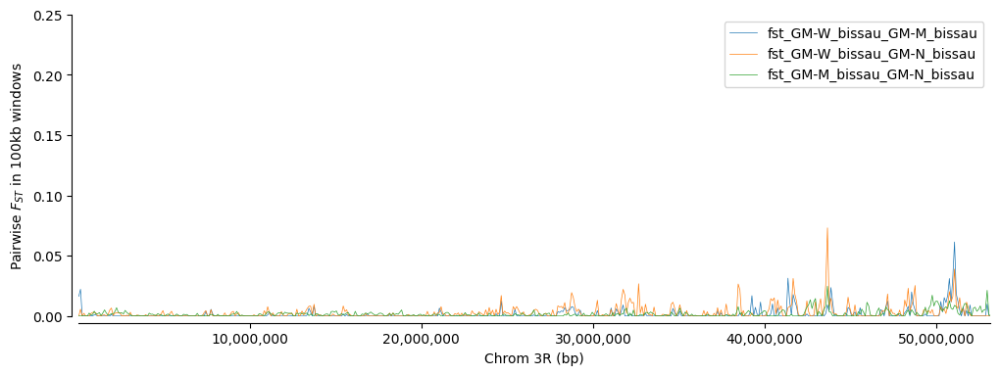

In [ ]:
## Compute An. gambiae Fst
fig, ax = plt.subplots(figsize=(12, 4))
sns.despine(ax=ax, offset=5)
plot_fst_year(data=data_fst_ag, ax=ax, xlab='Chrom 3R (bp)', ylab='Pairwise $F_{ST}$ in 100kb windows',
              legend_loc=(1, 1))
"""
ax.annotate('$vgsc$ region', xy=(2431617, 0.7), xytext=(600000, 1),
            color='darkred', arrowprops=dict(arrowstyle="->", color='slategrey'))
ax.annotate('$OBP41$ region', xy=(11551855.5, 0.3), xytext=(15000000, 0.5),
            color='darkred', arrowprops=dict(arrowstyle="->", color='slategrey'))"""

# Save fig
fig.savefig(f"3R_window_bissau_fst.png", dpi=300, bbox_inches='tight')
fig.show()

In [ ]:
#plot fsts
plt_fst = sns.FacetGrid(fst_big_df,
                            row="comp",
                            col="chrom",
                            height=1.8, aspect=2.5,
                            sharex=False,
                            sharey=True,
                            margin_titles=True)
plt_fst.map(sns.lineplot, "pos", "fst")
plt_fst.despine(left=True, bottom=True)
plt_fst.set_titles(col_template="{col_name}", row_template="{row_name}")
#plt.subplots_adjust(wspace=0.005)
plt_fst.fig.subplots_adjust(wspace=0.005, hspace=0.1)
plt_fst.set_axis_labels("Position", "Fst")

#remove y axis ticks from cols 3rl and x
for axis in plt_fst.axes[:,1:].flatten():
    axis.tick_params(left=False)

#remove x axis ticks from rows except bottom
for axis in plt_fst.axes[0:5, :].flatten():
    axis.tick_params(bottom=False, labelbottom=False)

#save plot as svg then edit in inkscape
plt_fst.savefig('drive/My Drive/Colab Notebooks/plt_fst.svg')

##XP-EHH

In [ ]:
# Contigs and cohorts setup
#GSS with iHs
def run_XP_EHH(taxon1, taxon2, contig,  country, window_size=200):
  """
  function that compute xp_ehh value for between twon taxon for a given contig
  """
  try:
    pos, xp_ehh = ag3.xpehh_gwss(
            contig=contig,
            cohort1_query = f"country=='{country}' and taxon=='{taxon1}'",
            cohort2_query = f"country=='{country}' and taxon=='{taxon2}'",
            window_size=window_size,
            analysis="gamb_colu",
    )
    return pos, xp_ehh # x: ndarray xp_ehh: ndarray
  except Exception as e:
    print(f"Error running XP-EHH: {e}")
    return None, None

def run_XP_EHH_loc(taxon, cohort1, cohort2, country ,contig, window_size=200):
  """
  function that compute xp_ehh value for between twon subpopulation for a given contig
  """
  list_cohort_group = ['country_iso', 'admin1_name', 'admin1_iso', 'admin2_name', 'cohort_admin1_year']
  print("cohort group list:")
  for i in list_cohort_group:
    print(i)
  cohort_group = input("Enter the cohort group to use: ")
  if cohort_group not in list_cohort_group or cohort_group is None:
    print("Invalid cohort group. Please choose from the list.")
    return
  try:
    pos, xp_ehh = ag3.xpehh_gwss(
            contig=contig,
            cohort1_query = f"country=='{country}' and taxon=='{taxon}' and {cohort_group} == '{cohort1}'",
            cohort2_query = f"country=='{country}' and taxon=='{taxon}' and {cohort_group} == '{cohort2}'",
            window_size=window_size,
            analysis="gamb_colu",
            min_cohort_size=10,
            max_cohort_size=100
    )
    return pos, xp_ehh # x: ndarray xp_ehh: ndarray
  except Exception as e:
    print(f"Error running XP-EHH: {e}")
    return None, None

In [ ]:
# Initialize an empty DataFrame to store results
final_xp_ehh_df = pd.DataFrame()
taxon1 = 'coluzzii'
taxon2 = 'bissau'
contigs = ['2L', '2R', '3L', '3R', 'X']
country = 'Gambia, The'  # Ensure the country variable is defined
window_size = 200  # Define the window size
cohort_results = []  # Initialize an empty list to collect results

for contig in contigs:
    print(f"Processing contig: {contig}")

    # Run the genome-wide scan for selection (XP-EHH)
    try:
        # Assuming run_XP_EHH returns positions and XP-EHH values
        pos, xp_ehh = run_XP_EHH(taxon1, taxon2, contig, country, window_size=window_size)
        # add an empty dimension to XP-EHH array if 1D
        xp_ehh = np.reshape(xp_ehh, (xp_ehh.shape[0], -1))
        for i in range(xp_ehh.shape[1]):
           xp_ehh_perc = xp_ehh[:, i]

        # Append results for the current contig to cohort_results
        cohort_results.append({
            "chrom": contig,
            "Chr_pos": pos,        # Chromosomal positions
            "xp_ehh": xp_ehh_perc,      # XP-EHH values
            "window_size": window_size,  # Window size used
            "taxon_1": taxon1,
            "taxon_2": taxon2,
            "country": country
        })
        print(f"XP-EHH scan completed for {contig}.")
    except Exception as e:
        print(f"Error running XP-EHH for {contig}: {e}")
        continue

# Process results and append to the final DataFrame
for result in cohort_results:
    temp_df = pd.DataFrame({
        "Chr_pos": result["Chr_pos"],
        "xp_ehh": result["xp_ehh"],
        "chrom": result["chrom"],
        "window_size": result["window_size"],
        "taxon_1": result["taxon_1"],
        "taxon_2": result["taxon_2"],
        "country": result["country"]
    })
    final_xp_ehh_df = pd.concat([final_xp_ehh_df, temp_df], ignore_index=True)

print("XP-EHH selection scan complete.")

# Save the final results to a CSV file
final_xp_ehh_df.to_csv(f'XP_EHH_{taxon1}_vs_{taxon2}_results.csv', index=False)
final_xp_ehh_df.query("chrom == '2R'")

##XP-EHH plot

In [ ]:
# List of unique chromosomes
chromosomes = final_xp_ehh_df['chrom'].unique()

# Define color map for cohorts
cohorts = final_xp_ehh_df['taxon_1'].unique()  # Assuming cohorts are defined by `taxon_1`
colors = plt.cm.tab20.colors  # Color palette
color_map = [colors[i % len(colors)] for i in range(len(cohorts))]

# Determine subplot grid size
ncols = 2
nrows = (len(chromosomes) + 1) // ncols

# Create subplots
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(16, 7 * nrows), sharex=False, sharey=False)
axes = axes.flatten()  # Flatten the axes array for easy indexing

# Loop through each chromosome and create a plot
for i, chrom in enumerate(chromosomes):
    ax = axes[i]
    chr_data = final_xp_ehh_df.query(f"chrom == '{chrom}'")

    # Unique cohorts
    cohorts = chr_data['taxon_1'].unique()  # Assuming `taxon_1` defines cohorts
    x_ticks = []
    x_labels = []
    current_x = 0

    for idx, cohort in enumerate(cohorts):
        # Filter data for the current cohort
        cohort_data = chr_data[chr_data['taxon_1'] == cohort]

        # X values: Positions adjusted by current_x offset
        x = cohort_data['Chr_pos'] + current_x
        y = cohort_data['xp_ehh']  # Use XP-EHH values

        # Scatter plot for current cohort
        ax.scatter(x, y, color=color_map[idx], s=10, label=f'{cohort}')

        # Add ticks and labels for cohorts
        x_ticks.append(x.median())  # Use median position for tick
        x_labels.append(f'{cohort}')

        # Update current_x for the next cohort
        current_x += cohort_data['Chr_pos'].max() + 50  # Add spacing between cohorts

    # Highlight the threshold line
    threshold = chr_data['xp_ehh'].quantile(0.99)  # Top 1% as threshold
    ax.axhline(y=threshold, color='black', linestyle='--', linewidth=1)

    # Set title for the subplot
    ax.set_title(f'XP-EHH Plot for Chromosome {chrom}', fontsize=12)
    ax.set_ylabel('XP-EHH')
    ax.legend(loc='upper right', fontsize=8)

    # Set x-axis ticks and labels
    ax.set_xticks(ticks=x_ticks)
    ax.set_xticklabels(labels=x_labels, rotation=45, ha='right')

# Remove empty subplots if the number of chromosomes is not a multiple of 2
for j in range(len(chromosomes), len(axes)):
    fig.delaxes(axes[j])

# Set global x-axis label
fig.supxlabel('Cohorts', fontsize=14)

# Adjust layout
plt.tight_layout()

# Save the plot
plt.savefig('xp_ehh_per_cohort.png', dpi=300)

# Display the plot
plt.show()


Understanding the Methods in linkage(y, method, metric)
##Single Linkage (method='single')

Merges clusters based on the smallest distance between any two points.
Tends to form elongated clusters (sensitive to noise/outliers).
Suitable for phylogenetic trees and evolutionary relationships.

##Complete Linkage (method='complete')

Merges clusters based on the largest distance between any two points.
Produces more compact clusters (less sensitive to noise).
Good for genetic similarity analysis when strict grouping is needed.

##Average Linkage (method='average')

Uses the average distance between all points in two clusters.
Balances between single and complete linkage.
Useful when studying genetic distances across multiple populations.

##Ward’s Method (method='ward')

Minimizes variance within clusters.
Works best for genome-wide SNP data, gene expression, and transcriptomic data.
Recommended for NGS population structure studies.

##Which Method is More Suitable for NGS Data?
If you are clustering genetic sequences or evolutionary trees, use:

method='single' (best for hierarchical phylogenetics).
If you are clustering genetic distances (SNPs, gene expression, CNVs), use:

method='ward' (best for structured population analysis).
method='average' (if populations are more diverse).
If you are handling contaminant filtering or noise reduction, use:

method='complete' (to avoid chaining effect).

**Source: Chat GPT :)**


In [ ]:
regions = ["2R:28,430,000-28,615,000", "3R:28,400,000-28,600,000",  "X:15,130,000-15,324,000", "3R:32,000,000-32,080,000"]
#regions=["3R:28,400,000-28,420,000","3R:28,420,000-28,440,000", "3R:28,420,000-28,600,000", "3R:32,000,000-32,080,000"]
sample_metadata = ag3.sample_metadata(sample_query="country=='Gambia, The' and taxon in ['coluzzii', 'gambiae', 'bissau']")
coluzzii_subset = sample_metadata.query("taxon=='coluzzii'").groupby("admin1_iso").apply(lambda x: x.sample(n=min(20, len(x)))).reset_index(drop=True)
coluzzii_subset.groupby('admin1_iso').size()
gambiae_subset = sample_metadata.query("taxon=='gambiae'")
bissau_subset = sample_metadata.query("taxon=='bissau' and admin1_iso != 'GM-U'").groupby('admin1_iso').apply(lambda x: x.sample(n=min(20, len(x)))).reset_index(drop=True)


samples_df = pd.concat([coluzzii_subset, gambiae_subset, bissau_subset])

# Samples list
samples_list = list(samples_df['sample_id'].values)


#regions=["3R:32,000,000-32,020,000", "3R:32,020,000-32,040,000","3R:32,040,000-32,080,000"]
"""ag3.plot_haplotype_clustering(
      region=region,
      analysis="gamb_colu",
      sample_query=f"country=='Gambia, The' and sample_id in {samples_list}",
      #cohort_size=200,
      color='taxon',
      linkage_method='ward', # or average, complete to have better view on local adpatation
      #title="Haplotype cluster of Anopheles gambiae complex\n Genomic region: 3R:32,000,000-32,080,000 (30,690 SNPs)"
)"""
for region in regions:
  ag3.plot_haplotype_clustering(
      region=region,
      analysis="gamb_colu",
      sample_query=f"country=='Gambia, The' and sample_id in {samples_list}",
      #cohort_size=200,
      color='taxon',
      marker_size=12,
      linkage_method='ward', # or average, complete to have better view on local adpatation
      #title="Haplotype cluster of Anopheles gambiae complex\n Genomic region: 3R:32,000,000-32,080,000 (30,690 SNPs)"
)

<ipython-input-6-14914e5f75e5>:4: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

<ipython-input-6-14914e5f75e5>:7: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



Load haplotypes:   0%|          | 0/148 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/74 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/74 [00:00<?, ?it/s]

Load haplotypes:   0%|          | 0/74 [00:00<?, ?it/s]

## heatmap haplotype cluster

In [ ]:
!rm *.*

In [ ]:
# compute the pairwise haplotype distance
regions = ["2R:28,430,000-28,615,000", "3R:28,400,000-28,600,000", "3R:32,000,000-32,080,000", "X:15,130,000-15,324,000"]
#regions=["3R:28,400,000-28,420,000","3R:28,420,000-28,440,000", "3R:28,420,000-28,600,000", "3R:32,000,000-32,080,000"]
sample_metadata = ag3.sample_metadata(sample_query="country=='Gambia, The' and taxon in ['coluzzii', 'gambiae', 'bissau']")

coluzzii_subset = sample_metadata.query("taxon=='coluzzii'").groupby("admin1_iso").apply(lambda x: x.sample(n=min(20, len(x)))).reset_index(drop=True)
coluzzii_subset.groupby('admin1_iso').size()
gambiae_subset = sample_metadata.query("taxon=='gambiae'")
bissau_subset_GM_N = sample_metadata.query("taxon=='bissau'and admin1_iso == 'GM-N'").sample(n=50, random_state=42)
bissau_subset = sample_metadata.query("taxon=='bissau' and admin1_iso not in ['GM-U', 'GM-N']")
# Take 40 indiv in each taxon
"""coluzzii_subset = sample_metadata.query("taxon=='coluzzii'").sample(n=40, random_state=42)
gambiae_subset =sample_metadata.query("taxon=='gambiae'").sample(n=40, random_state=42)
bissau_subset = sample_metadata.query("taxon=='bissau'").sample(n=40, random_state=42)
"""
samples_df = pd.concat([coluzzii_subset, gambiae_subset, bissau_subset_GM_N, bissau_subset])
#rename sample
samples_df["sample_pop"] = samples_df["taxon"] + "_" + samples_df["admin1_iso"]
# Samples list
samples_list = list(samples_df['sample_id'].values)

region = regions[3]
# Compute the pairwise haplotype distance
dist, phased_sample, n_snp = ag3.haplotype_pairwise_distances(
    region=regions,
    analysis="gamb_colu",
    sample_query=f"country=='Gambia, The' and sample_id in {samples_list}",
)


<ipython-input-148-f3cf3d695d0c>:6: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



Load haplotypes:   0%|          | 0/385 [00:00<?, ?it/s]

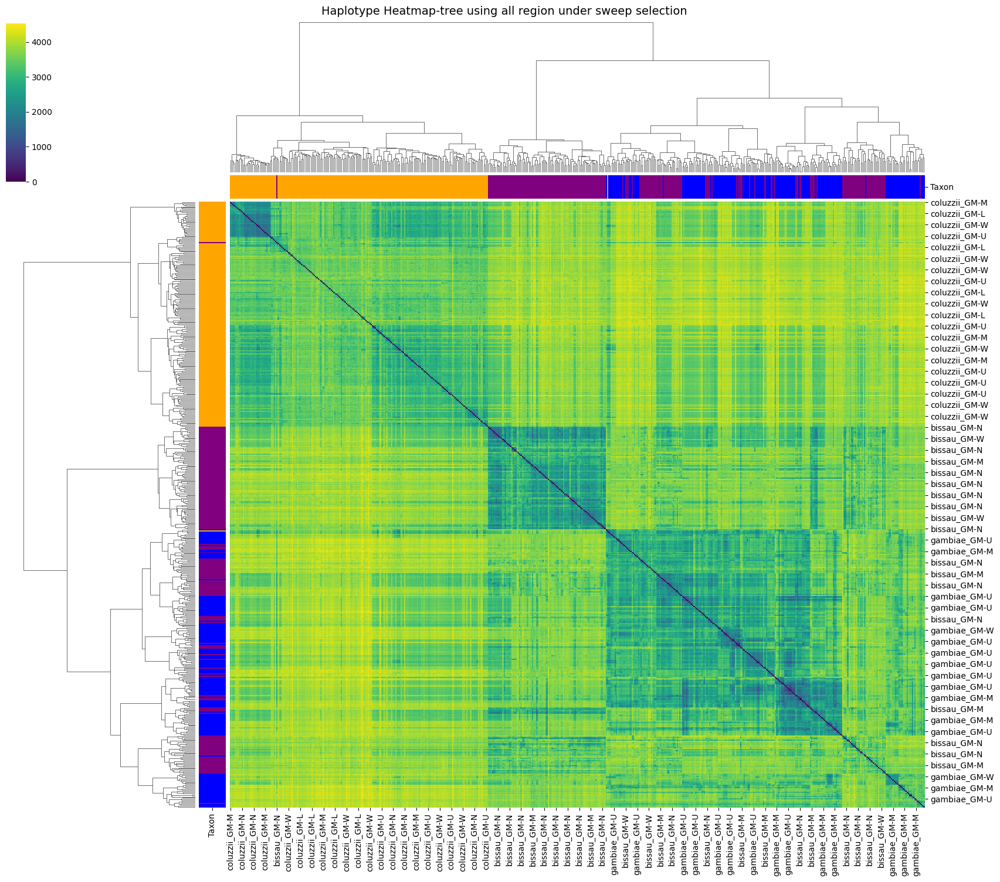

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import scipy.cluster.hierarchy as sch
import matplotlib.pyplot as plt
from scipy.spatial.distance import squareform


# Align sample metadata with haplotypes.
df_samples_phased = (
    samples_df.set_index("sample_id").loc[phased_sample.tolist()].reset_index()
)

# Ensure correct distance matrix format
if len(dist.shape) == 1:  # If dist is condensed (1D)
    distance_matrix_sq = squareform(dist)
else:
    distance_matrix_sq = dist  # Already square

# Repeat metadata so there is one row per haplotype
df_haps = pd.DataFrame(np.repeat(df_samples_phased.values, 2, axis=0))
df_haps.columns = df_samples_phased.columns  # Restore column names

# Ensure haplotype IDs match the distance matrix shape
haplotype_ids = list(df_haps["sample_pop"].values)  # Use the repeated sample IDs for haplotypes

# Validate matrix and haplotype list size
assert distance_matrix_sq.shape == (len(haplotype_ids), len(haplotype_ids)), \
    f"Mismatch: Distance matrix shape {distance_matrix_sq.shape} vs. haplotype list {len(haplotype_ids)}"

# Perform hierarchical clustering using the condensed form of distances
linkage_matrix = sch.linkage(dist, method='ward')

# Convert distance matrix to DataFrame with correct haplotype IDs
distance_df = pd.DataFrame(distance_matrix_sq, index=haplotype_ids, columns=haplotype_ids)


#save the matrix distance
#distance_df.to_csv(f'distance_matrix_{region}.csv')
distance_df.to_csv(f'distance_matrix_all_region.csv')
#distance_df = pd.read_csv(f'distance_matrix_{region}.csv', index_col=0)
distance_df

haplotype_ids = list(df_haps["sample_pop"].values)  # Use the repeated sample IDs for haplotypes
# Create color mapping based on taxon (as a DataFrame)
taxon_palette = {
    "coluzzii": "orange",
    "gambiae": "blue",
    "bissau": "purple"
}

# Convert taxon labels to colors
df_haps["color"] = df_haps["taxon"].map(taxon_palette)

# Create row_colors as a Pandas DataFrame (ensuring index matches the heatmap data)
row_colors = pd.DataFrame(df_haps["color"])
row_colors.index = haplotype_ids  # Align with heatmap index
row_colors.columns = ["Taxon"]  # Name the column for better visualization

# Plot heatmap with hierarchical clustering
sns.clustermap(
    pd.DataFrame(distance_matrix_sq, index=haplotype_ids, columns=haplotype_ids),
    row_linkage=linkage_matrix,
    col_linkage=linkage_matrix,
    cmap="viridis",
    figsize=(17, 15),
    row_colors=row_colors,
    #dendrogram_ratio=(0.1),
    col_colors = row_colors,
    cbar_pos=(0, 0.8, 0.02, 0.18)  # (x, y, width, height) - Adjust as needed
)
#plt.suptitle(f"Haplotype Heatmap-tree using {region}", fontsize=14, y=1)
plt.suptitle(f"Haplotype Heatmap-tree using all region under sweep selection", fontsize=14, y=1)

#plt.savefig(f'heatmap_tree_{region}.png', dpi=300)
plt.savefig(f'heatmap_tree_all_region.png', dpi=300)

plt.show()



In [ ]:
bissau_haplo = ['VBS79121-7065STDY13144861', 'VBS78669-7065STDY13144335', 'VBS79249-7065STDY13144934']

outhaplo = ['VBS48141-6366STDY9854743', 'VBS78143-7065STDY13143794', 'VBS68708-6411STDY13142731']

samples_list = bissau_haplo + outhaplo
ds_haps = ag3.haplotypes(
    region="3R:32,000,000-32,080,000",
    analysis="gamb_colu",
    #sample_sets = '3.0',
    sample_query=f"country=='Gambia, The' and sample_id in {bissau_haplo}",
    #cohort_size=20,
)
ds_haps


def plot_haplotypes(
    ds,
    hide_text=False,
    hide_non_seg=False,
):
    import plotly.express as px
    import allel

    # convert to 2D array of haplotypes
    pos = ds["variant_position"].values
    gt = ds["call_genotype"].values
    ht = gt.reshape(gt.shape[0], -1)

    # size rows and columns
    if hide_text:
        # can make smaller because text not shown
        row_height = 8
        col_width = 5
    else:
        # make a bit bigger so we can see the text
        row_height = 14
        col_width = 12

    # deal with non-segregating sites
    if hide_non_seg:
        ac = allel.HaplotypeArray(ht).count_alleles(max_allele=1)
        loc_seg = ac.is_segregating()
        ht = ht[loc_seg]

    # plot a heatmap
    fig = px.imshow(
        ht.T,
        text_auto=not hide_text,
        labels=dict(
            x="Variants",
            y="Haplotypes",
        ),
        width=ht.shape[0] * col_width + 200,
        height=ht.shape[1] * row_height + 200,
        zmin=0,
        zmax=0,
        color_continuous_scale="greys",
        template="simple_white",
        aspect="auto"
    )

    # visual styling
    fig.update_layout(
        coloraxis_showscale=False,
        plot_bgcolor="#cccccc",
    )
    fig.update_traces(xgap=0, ygap=1)
    fig.update_xaxes(tickvals=[])
    fig.update_yaxes(tickvals=[])

    return fig
plot_haplotypes(ds_haps)

In [ ]:
plot_haplotypes(ds_haps, hide_non_seg=True)

In [ ]:
genotype = ag3.snp_calls(
    region="3R:32,000,000-32,080,000",
    site_mask="gamb_colu",
    sample_query=f"country=='Gambia, The' and sample_id in {bissau_haplo}",

)
genotype

<xarray.Dataset> Size: 3MB
Dimensions:                             (variants: 72373, alleles: 4,
                                         samples: 2, ploidy: 2)
Coordinates:
    variant_position                    (variants) int32 289kB dask.array<chunksize=(72373,), meta=np.ndarray>
    variant_contig                      (variants) uint8 72kB dask.array<chunksize=(72373,), meta=np.ndarray>
    sample_id                           (samples) <U36 288B dask.array<chunksize=(2,), meta=np.ndarray>
Dimensions without coordinates: variants, alleles, samples, ploidy
Data variables:
    variant_allele                      (variants, alleles) |S1 289kB dask.array<chunksize=(72373, 4), meta=np.ndarray>
    variant_filter_pass_gamb_colu_arab  (variants) bool 72kB dask.array<chunksize=(58326,), meta=np.ndarray>
    variant_filter_pass_gamb_colu       (variants) bool 72kB dask.array<chunksize=(58326,), meta=np.ndarray>
    variant_filter_pass_arab            (variants) bool 72kB dask.array<chunksize=(58326,), meta=np.ndarray>
    call_genotype                       (variants, samples, ploidy) int8 289kB dask.array<chunksize=(58326, 2, 2), meta=np.ndarray>
    call_GQ                             (variants, samples) int16 289kB dask.array<chunksize=(58326, 2), meta=np.ndarray>
    call_MQ                             (variants, samples) float32 579kB dask.array<chunksize=(58326, 2), meta=np.ndarray>
    call_AD                             (variants, samples, alleles) int16 1MB dask.array<chunksize=(58326, 2, 4), meta=np.ndarray>
    call_genotype_mask                  (variants, samples, ploidy) bool 289kB dask.array<chunksize=(58326, 2, 2), meta=np.ndarray>
Attributes:
    contigs:  ('2R', '2L', '3R', '3L', 'X')

Bissau molecular form display unique cluster whitout any shared clusters with their sister, in the region 3R:32,000,000-32,080,000 where Ors genes are located.

In [ ]:
genes = ag3.genome_features("region=X:14,924,000-15,600,000")
info = genes.query("type in ['gene']")
info
gene_name = {}
for idx, row in info.iterrows():
  if row['Name'] == "NaN":
    gene_name[row['ID']] = row['ID']
  else:
    gene_name[row['ID']] = row['Name']
gene_name
genes = genes.query("type in ['mRNA']")
genes_transcript = {}
for idx, row in genes.iterrows():
    genes_transcript[row['Parent']] = row['ID']
genes_transcript
# construct dict with gene_name and transcript ID
gene_transcript = {}
for gene, transcript in genes_transcript.items():
    gene_transcript[gene_name[gene]] = transcript
gene_transcript

{'AGAP000815': 'AGAP000815-RB',
 'AGAP000817': 'AGAP000817-RA',
 'AGAP000816': 'AGAP000816-RA',
 'AGAP013474': 'AGAP013474-RA',
 'AGAP013173': 'AGAP013173-RA',
 'AGAP013424': 'AGAP013424-RA',
 'AGAP012997': 'AGAP012997-RA',
 'AGAP000818': 'AGAP000818-RA',
 'AGAP000819': 'AGAP000819-RA',
 'AGAP000820': 'AGAP000820-RA',
 'AGAP000821': 'AGAP000821-RA',
 'AGAP000822': 'AGAP000822-RA',
 'AGAP000823': 'AGAP000823-RA',
 'AGAP000824': 'AGAP000824-RA',
 'AGAP000825': 'AGAP000825-RA',
 'AGAP000826': 'AGAP000826-RA',
 'AGAP000829': 'AGAP000829-RA',
 'AGAP000830': 'AGAP000830-RA',
 'AGAP000831': 'AGAP000831-RA',
 'AGAP000832': 'AGAP000832-RA',
 'AGAP000833': 'AGAP000833-RB',
 'AGAP000834': 'AGAP000834-RA',
 'AGAP000835': 'AGAP000835-RA',
 'AGAP028655': 'AGAP028655-RA',
 'AGAP013506': 'AGAP013506-RA',
 'AGAP000840': 'AGAP000840-RA',
 'AGAP000841': 'AGAP000841-RA',
 'AGAP013101': 'AGAP013101-RA',
 'AGAP000842': 'AGAP000842-RA',
 'AGAP000843': 'AGAP000843-RA',
 'AGAP000844': 'AGAP000844-RA'}

In [ ]:

#find gene transcript
df_genset = ag3.geneset().set_index('ID')
df_genset.query("Name =='CPR16'")
df_genset.query('ID == "AGAP005413"')
df_genset.query("Parent=='AGAP005413'")

In [ ]:
#Get the amino_acid full name
from Bio.Data import IUPACData

# Get the mapping of one-letter codes to full names
amino_acid_mapping = IUPACData.protein_letters_1to3_extended
amino_acid_mapping
# Dictionary mapping one-letter codes to full amino acid names
amino_acid_mapping_2 = {
    'A': 'Alanine',
    'R': 'Arginine',
    'N': 'Asparagine',
    'D': 'Aspartic acid',
    'C': 'Cysteine',
    'E': 'Glutamic acid',
    'Q': 'Glutamine',
    'G': 'Glycine',
    'H': 'Histidine',
    'I': 'Isoleucine',
    'L': 'Leucine',
    'K': 'Lysine',
    'M': 'Methionine',
    'F': 'Phenylalanine',
    'P': 'Proline',
    'S': 'Serine',
    'T': 'Threonine',
    'W': 'Tryptophan',
    'Y': 'Tyrosine',
    'V': 'Valine',
}

temporal = "admin1_year"
spacial = "admin1_name"
snp_transcript = ["AGAP009390-RA","AGAP009391-RA", "AGAP009392-RA",
                  "AGAP009393-RA", "AGAP009394-RA", "AGAP009395-RA",
                  "AGAP009396-RA", "AGAP009397-RA", "AGAP009398-RA"]
# Function to convert one-letter sequence to full names
def convert_to_full_names(sequence, amino_acid_mapping):
    full_names = []
    for code in sequence:
        full_name = amino_acid_mapping.get(code.upper(), f"Unknown({code})")
        full_names.append(full_name)
    return full_names


# Function to calculate the  snp_freq
def get_snp_freq(transcript, cohort):
    snp_allele_freqs_df = ag3.snp_allele_frequencies(
        sample_query="country=='Gambia, The' and taxon in ['gambiae', 'coluzzii', 'bissau']",
        transcript=transcript,
        cohorts=temporal,
        drop_invariant=False,
    )
    snp_allele_freqs_df

    freq_col = [col for col in snp_allele_freqs_df.columns if col.startswith('frq_')]
    freq_col
    ns_snps_df = snp_allele_freqs_df.query("effect == 'NON_SYNONYMOUS_CODING' and max_af >= 0.10")
    ns_snps_df
    # Define a custom order for the group ('biss', 'colu', 'gamb')
    group_order = {'biss': 1, 'colu': 2, 'gamb': 3}

    # Sort by group first and then by year
    sorted_data = sorted(
        freq_col,
        key=lambda x: (group_order[x.split('_')[-2]], int(x.split('_')[-1]))
    )

    ordered_nsnp = ns_snps_df[[col for col in ns_snps_df.columns if col not in freq_col] + sorted_data]
    ordered_nsnp
    ag3.plot_frequencies_heatmap(ordered_nsnp)
    file_name = f"ns_snps_{transcript}.xlsx"
    ordered_nsnp["full_name_aa_ref"] = convert_to_full_names(ordered_nsnp["ref_aa"], amino_acid_mapping_2)
    ordered_nsnp["full_name_aa_alt"] = convert_to_full_names(ordered_nsnp["alt_aa"], amino_acid_mapping_2)
    #ordered_nsnp.to_csv(file_name, index=False)
    ordered_nsnp.to_excel(file_name, index=False)




for gene in snp_transcript:
  get_snp_freq(gene, temporal)

## SNP freq in Bissau
##Or53:
M58T,V40M, E56D, I336L, M335I, A243V, E27Q and M300I have high freq in Bissau pop and are highly linked(LD >0.8)

## Or30:
G29V, P221S and F305L are highly express in Bissau and linked also(LD > 0.8)

## 0r46:
Q101E and F182V highly expressed in Bissau and linked(LD > 0.8)

## Or17:
E7K, T213A, F307S and K329E highly experssed in Bissau

## Or55
D101N, V176I and S179A highly experssed in Bissau and linked(LD > 0.8)

In [ ]:
import glob
import shutil
from google.colab import files
import zipfile # Import the zipfile module


excel = glob.glob('*.xlsx')
for file in excel:
  files.download(file )


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:

def get_variant_position(variant_position, variant_name):
  if not isinstance(variant_position, list):
    variant_position = list(variant_position)
  try:
    index = variant_position.index(variant_name)
    return index
  except ValueError:
    return None

In [ ]:

import allel
import numpy as np
from scipy.spatial.distance import squareform
import seaborn as sns
import matplotlib.pyplot as plt
import allel

ns_snps_df = pd.read_excel('/content/ns_snps_AGAP009397-RA.xlsx')
ns_snps_df['label']
gene_name = "Or46"
# Get the gene ID
gene = (ns_snps_df.iloc[0]['transcript']).split("-")[0]
#Get the gene region
genome_features = ag3.genome_features()
gene_features = genome_features.query(f"ID=='{gene}' and type=='gene'")
gene_features
start = gene_features.iloc[0]['start']
start =f"{start:,}"
end = gene_features.iloc[0]['end']
end =f"{end:,}"
gene_region =gene_features.iloc[0]['contig'] + ':' + str(start) + '-' + str(end)
gene_region
#for taxon in ['coluzzii', 'gambiae', 'bissau']:
taxon = 'bissau'
ds_snps = ag3.snp_calls(region=gene_region,
                        sample_query=f"country=='Gambia, The' and taxon=='{taxon}'", site_mask="gamb_colu")
ds_snps
# use the scikit-allel wrapper class for genotype calls
gt = allel.GenotypeDaskArray(ds_snps["call_genotype"].data)
gt
snp_position = list(ds_snps['variant_position'].values)


snp_regions = []
snp_name = []
for index, row in ns_snps_df.iterrows():
  region = row['label']
  variant = region.split(' ')[-1]
  variant = variant.replace("(", "").replace(")", "")
  snp_pos = region.split(' ')[0].split(":")[-1]
  snp_pos = int(snp_pos.replace(',', ''))  # Remove commas and convert to int
  snp_regions.append(snp_pos)
  snp_name.append(variant)


target_position = list(pd.Series(snp_regions).unique())
len(target_position)


# Get the SNP position from the genotype data
variant_position = []
to_del =  []
for idx, pos in enumerate(target_position):
    index = get_variant_position(snp_position, pos)
    if index is not None:
        variant_position.append(index)
    else:
        print(f"Variant {snp_name[idx]} at position {pos} not found in the list.")
        to_del.append(idx)
snp_name = list(np.delete(snp_name, to_del))

# Constract snp_name

snp_name = pd.Series(snp_name).unique()
snp_name


#snp_name = list(snp_colu_freq['aa_change'])
#snp_name
#LD
# extract variant genotype
selected_variant = gt[variant_position, :]



# Linkage disequilibrium using Rogers and Huff
print("LD Rogers & Huff...")
ld_rhr = allel.rogers_huff_r(selected_variant.to_n_alt(fill=-1))  # Compute LD
ld_rhr = squareform(ld_rhr)  # Convert to square matrix
#np.fill_diagonal(ld_rhr, np.nan)  # Fill diagonal with NaN

# Construct pandas dataframe for LD resutl
ld_rhr_df = pd.DataFrame(ld_rhr, index=snp_name, columns=snp_name)
#ld_rhr_df[['G29V', 'P221S', 'F305L']]
# remove column and rows with NA
# Remove rows and columns with all NaN values

# Create a mask for the upper triangle
mask = np.triu(np.ones_like(ld_rhr, dtype=bool))

# Create the heatmap
fig = plt.figure(figsize=(30, 12))
ax = sns.heatmap(
    ld_rhr,
    mask=mask,  # Apply the mask
    vmin=-1, vmax=1,
    cmap="coolwarm",  # Blue-to-red colormap for scientific convention
    xticklabels=snp_name, yticklabels=snp_name,
    linewidths=0.8, linecolor="white", annot=True, fmt=".2f",  # Annotate cells
)

# Customize the heatmap title and labels
ax.set_title(f"Linkage Disequilibrium (Rogers & Huff) between {gene_name} variants", fontsize=14, pad=15)
plt.xticks(rotation=90)  # Rotate x-axis labels
plt.yticks(rotation=0)  # Rotate y-axis labels

# Save the figure
fig.savefig(f'LD_{taxon}_{gene_name}.png', dpi=1000, bbox_inches='tight')
print(f"LD of {taxon}")
#plt.show()


In [ ]:
# advanced diplotype  cluster
snp_transcript = ["AGAP009390-RA","AGAP009391-RA", "AGAP009392-RA",
                  "AGAP009393-RA", "AGAP009394-RA", "AGAP009395-RA",
                  "AGAP009396-RA", "AGAP009397-RA", "AGAP009398-RA"]


sample_metadata = ag3.sample_metadata(sample_query="country=='Gambia, The' and taxon in ['coluzzii', 'gambiae', 'bissau']")

#coluzzii_subset = sample_metadata.query("taxon=='coluzzii'").groupby("admin1_iso").apply(lambda x: x.sample(n=min(20, len(x)))).reset_index(drop=True)
coluzzi_susbet = sample_metadata.query("taxon=='coluzzii'").sample(n=100, random_state=42)
coluzzii_subset.groupby('admin1_iso').size()
gambiae_subset = sample_metadata.query("taxon=='gambiae'")
bissau_subset = sample_metadata.query("taxon=='bissau' and admin1_iso != 'GM-U'").groupby('admin1_iso').apply(lambda x: x.sample(n=min(20, len(x)))).reset_index(drop=True)

# Take 40 indiv in each taxon
"""coluzzii_subset = sample_metadata.query("taxon=='coluzzii'").sample(n=40, random_state=42)
gambiae_subset =sample_metadata.query("taxon=='gambiae'").sample(n=40, random_state=42)
bissau_subset = sample_metadata.query("taxon=='bissau'").sample(n=40, random_state=42)
"""
samples_df = pd.concat([coluzzii_subset, gambiae_subset, bissau_subset])
samples_list = samples_df['sample_id'].tolist()

if isinstance(snp_transcript, pd.Series):
    print("Not a good format")
    snp_transcript = snp_transcript.tolist()
for transcript in snp_transcript:
  print(transcript)
  ag3.plot_diplotype_clustering_advanced(
  region="3R:32000000-32080000",
  site_mask="gamb_colu",
  #sample_query="country=='Gambia, The' and taxon in ['coluzzii', 'gambiae', 'bissau']",
  sample_query=f"country=='Gambia, The' and sample_id in {samples_list}",
  heterozygosity=True,
  snp_transcript=transcript,
  snp_filter_min_maf=0.10,
  #cnv_region="3R:32000000-32080000",
  snp_query="effect == 'NON_SYNONYMOUS_CODING'",
  color='taxon',
  marker_size=6,
  linkage_method="complete",
  #linkage_method='ward',
)
"""for region in  regions:
  ag3.plot_diplotype_clustering_advanced(
      region=region,
      site_mask="gamb_colu",
      sample_query="country=='Gambia, The' and taxon in ['coluzzii', 'gambiae', 'bissau']",
      heterozygosity=True,
      #cohort_size=200,
      symbol='taxon',
      color='admin1_iso',
      #linkage_method='ward' # or average, complete to have better view on local adpatation
  )"""

<ipython-input-3-cdc4b39be32d>:13: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



AGAP009390-RA


Load genotypes for distance calculation:   0%|          | 0/410 [00:00<?, ?it/s]

Load genotypes for heterozygosity calculation:   0%|          | 0/410 [00:00<?, ?it/s]

Load SNP genotypes:   0%|          | 0/154 [00:00<?, ?it/s]

Compute SNP effects:   0%|          | 0/4083 [00:00<?, ?it/s]

AGAP009391-RA


Load genotypes for distance calculation:   0%|          | 0/410 [00:00<?, ?it/s]

Load genotypes for heterozygosity calculation:   0%|          | 0/410 [00:00<?, ?it/s]

Load SNP genotypes:   0%|          | 0/154 [00:00<?, ?it/s]

Compute SNP effects:   0%|          | 0/4173 [00:00<?, ?it/s]

AGAP009392-RA


Load genotypes for distance calculation:   0%|          | 0/410 [00:00<?, ?it/s]

Load genotypes for heterozygosity calculation:   0%|          | 0/410 [00:00<?, ?it/s]

Load SNP genotypes:   0%|          | 0/154 [00:00<?, ?it/s]

Compute SNP effects:   0%|          | 0/4314 [00:00<?, ?it/s]

AGAP009393-RA


Load genotypes for distance calculation:   0%|          | 0/410 [00:00<?, ?it/s]

Load genotypes for heterozygosity calculation:   0%|          | 0/410 [00:00<?, ?it/s]

Load SNP genotypes:   0%|          | 0/154 [00:00<?, ?it/s]

Compute SNP effects:   0%|          | 0/4350 [00:00<?, ?it/s]

AGAP009394-RA


Load genotypes for distance calculation:   0%|          | 0/410 [00:00<?, ?it/s]

Load genotypes for heterozygosity calculation:   0%|          | 0/410 [00:00<?, ?it/s]

Load SNP genotypes:   0%|          | 0/154 [00:00<?, ?it/s]

Compute SNP effects:   0%|          | 0/4320 [00:00<?, ?it/s]

AGAP009395-RA


Load genotypes for distance calculation:   0%|          | 0/410 [00:00<?, ?it/s]

Load genotypes for heterozygosity calculation:   0%|          | 0/410 [00:00<?, ?it/s]

Load SNP genotypes:   0%|          | 0/154 [00:00<?, ?it/s]

Compute SNP effects:   0%|          | 0/4293 [00:00<?, ?it/s]

AGAP009396-RA


Load genotypes for distance calculation:   0%|          | 0/410 [00:00<?, ?it/s]

Load genotypes for heterozygosity calculation:   0%|          | 0/410 [00:00<?, ?it/s]

Load SNP genotypes:   0%|          | 0/154 [00:00<?, ?it/s]

Compute SNP effects:   0%|          | 0/4308 [00:00<?, ?it/s]

AGAP009397-RA


Load genotypes for distance calculation:   0%|          | 0/410 [00:00<?, ?it/s]

Load genotypes for heterozygosity calculation:   0%|          | 0/410 [00:00<?, ?it/s]

Load SNP genotypes:   0%|          | 0/154 [00:00<?, ?it/s]

Compute SNP effects:   0%|          | 0/4398 [00:00<?, ?it/s]

AGAP009398-RA


Load genotypes for distance calculation:   0%|          | 0/410 [00:00<?, ?it/s]

Load genotypes for heterozygosity calculation:   0%|          | 0/410 [00:00<?, ?it/s]

Load SNP genotypes:   0%|          | 0/154 [00:00<?, ?it/s]

Compute SNP effects:   0%|          | 0/4293 [00:00<?, ?it/s]

'for region in  regions:\n  ag3.plot_diplotype_clustering_advanced(\n      region=region,\n      site_mask="gamb_colu",\n      sample_query="country==\'Gambia, The\' and taxon in [\'coluzzii\', \'gambiae\', \'bissau\']",\n      heterozygosity=True,\n      #cohort_size=200,\n      symbol=\'taxon\',\n      color=\'admin1_iso\',\n      #linkage_method=\'ward\' # or average, complete to have better view on local adpatation\n  )'

In [ ]:
# advanced diplotype  cluster
snp_transcript = ["AGAP009390-RA","AGAP009391-RA", "AGAP009392-RA",
                  "AGAP009393-RA", "AGAP009394-RA", "AGAP009395-RA",
                  "AGAP009396-RA", "AGAP009397-RA", "AGAP009398-RA"]


sample_metadata = ag3.sample_metadata(sample_query="country=='Gambia, The' and taxon in ['coluzzii', 'gambiae', 'bissau']")

#coluzzii_subset = sample_metadata.query("taxon=='coluzzii'").groupby("admin1_iso").apply(lambda x: x.sample(n=min(20, len(x)))).reset_index(drop=True)
coluzzii_subset = sample_metadata.query("taxon=='coluzzii'").sample(n=100, random_state=42)
coluzzii_subset.groupby('admin1_iso').size()
gambiae_subset = sample_metadata.query("taxon=='gambiae'")
bissau_subset = sample_metadata.query("taxon=='bissau' and admin1_iso != 'GM-U'").groupby('admin1_iso').apply(lambda x: x.sample(n=min(20, len(x)))).reset_index(drop=True)

# Take 40 indiv in each taxon
"""coluzzii_subset = sample_metadata.query("taxon=='coluzzii'").sample(n=40, random_state=42)
gambiae_subset =sample_metadata.query("taxon=='gambiae'").sample(n=40, random_state=42)
bissau_subset = sample_metadata.query("taxon=='bissau'").sample(n=40, random_state=42)
"""
samples_df = pd.concat([coluzzii_subset, gambiae_subset, bissau_subset])
samples_list = samples_df['sample_id'].tolist()

if isinstance(snp_transcript, pd.Series):
    print("Not a good format")
    snp_transcript = snp_transcript.tolist()
ag3.plot_diplotype_clustering_advanced(
    region="X:15130000-15324000",
    site_mask="gamb_colu",
    #sample_query="country=='Gambia, The' and taxon in ['coluzzii', 'gambiae', 'bissau']",
    sample_query=f"country=='Gambia, The' and sample_id in {samples_list}",
    heterozygosity=True,
    #snp_transcript=transcript,
    #snp_filter_min_maf=0.10,
    cnv_region="X:15130000-15324000",
    #snp_query="effect == 'NON_SYNONYMOUS_CODING'",
    color='taxon',
    marker_size=6,
    #linkage_method="complete",
    linkage_method='ward',
)
for gene, transcript in genes_transcript.items():
  if gene in gene_name:
    # if gene_name[gene] is not nan
    print(gene_name[gene])
  ag3.plot_diplotype_clustering_advanced(
  region="X:15130000-15324000",
  site_mask="gamb_colu",
  #sample_query="country=='Gambia, The' and taxon in ['coluzzii', 'gambiae', 'bissau']",
  sample_query=f"country=='Gambia, The' and sample_id in {samples_list}",
  heterozygosity=True,
  snp_transcript=transcript,
  snp_filter_min_maf=0.10,
  #cnv_region="2R:28450000-28545000",
  snp_query="effect == 'NON_SYNONYMOUS_CODING'",
  color='taxon',
  marker_size=6,
  #linkage_method="complete",
  linkage_method='ward',
)


The diploide cluster show an isolated cluster of bissau with low heterozygosity meaning selection . Bissau molecular form evolve independantly around that particular region and confirm our hypotheisis for local adaptation of Bissau. This concern Bissau molecular form from Northern bank cohort.

We find that 3R:32,000,000_32,080,000 region is displaying a sweep selection in only one particular taxon containing Ors genes, Bissau molecular form specially the Nothern Bank cohort. Here we use advanced diploid cluster to see variant which are only found in the population having selection




These mutations are only or mostly found in a Bissau haplotype cluster
The AGAP009390-RA(Or53) presents 6 mutations: M301I, E247Q, A243V, M58T, E56D and V40M. One addational mutation the S237R was also found but in all taxon.

The AGAP009391-RA(Or30) presents F305L, P221S only found in Bissau, F130L, K97E, Q96H, Q96R,G29V, M21V and I12M mostly found in Bissau with some portion found as well in coluzzii  central river population.

The AGAP009392-RA(Or46) present F182V and Q101E

AGAP009395-RA(Or17) present K329EV, F307S, T213A and E7K only in Bissau molecular form and one common mutation the A223V

AGAP009396-RA(Or13) E368K, I38K, Y312H, V258L, D25OY,A230V V223I, I195V, F19OI, I186L, V162M,  G153V mostly in Bissau but found in some coluzzii individu from the central river

AGAP009397-RA(Or55) present V265I, V181I,S179A, T178A,V176I and  D101N.
S179AI, V176I and  D101N was only located in Bissau population

AGAP009398-RA(Or15) presents S352N, T337P, T336I(only in haplotype cluster) and F23L




AGAP009393-RA(Or47)(on mutations) and AGAP009394-RA(Or16)(One common mutation, the V254L in all taxon) was no longer participating to the sweep selection

In [ ]:
genes_df = ag3.genome_features(region=f"2R:{start_region}-{end_region}").query("type=='gene'")
genes_df = genes_df[['contig', 'start', 'end', 'strand', 'ID', 'Name', 'type']]

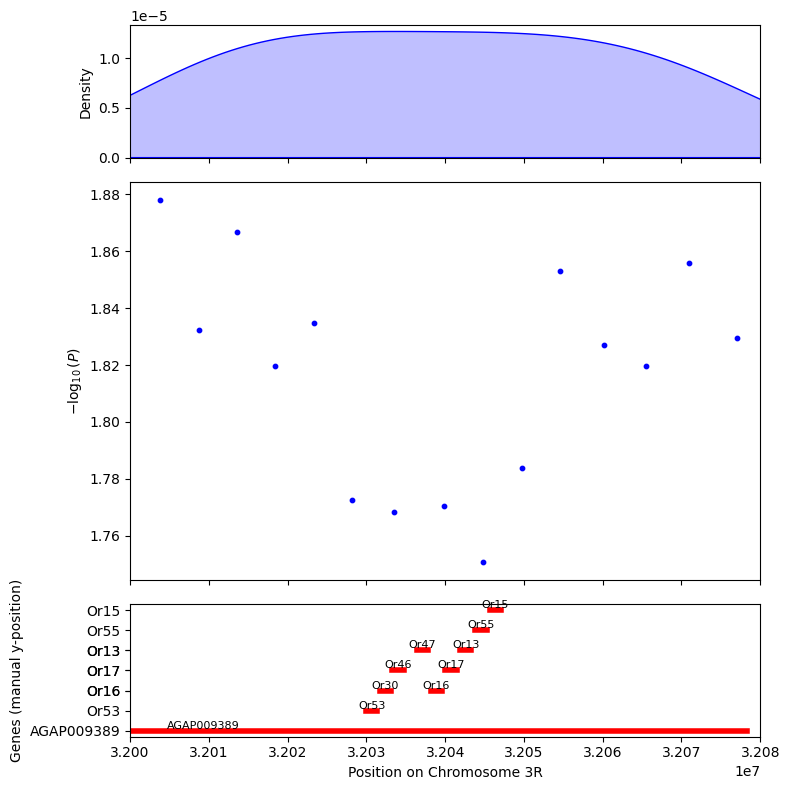

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Set a seed for reproducibility
np.random.seed(42)

# Define the genomic region
chromosome = "3R"
start_region = 32000000
end_region = 32080000

# Load H12 dataset
gambiae = pd.read_csv("/content/gambiae_h12_GWSS_results.csv")
h12_df = gambiae.query(f"chrom == '{chromosome}'").rename(columns={"Chr_pos": "position", "H12": "p_value"})
h12_df = h12_df[["position", "p_value"]]

# Filter for the selected region
h12_df = h12_df.query(f"{start_region} <= position <= {end_region}")

# Load gene annotations
genes_df = ag3.genome_features(region=f"{chromosome}:{start_region}-{end_region}").query("type == 'gene'")
genes_df = genes_df[['contig', 'start', 'end', 'strand', 'ID', 'Name', 'type']]

# Ensure only relevant chromosome data
genes_df = genes_df.query(f"contig == '{chromosome}'")

# Handle missing gene names
genes_df["Name"] = genes_df["Name"].fillna(genes_df["ID"])  # Use ID if Name is missing

# If no genes are found, print a message
if genes_df.empty:
    print("No genes found in the selected region!")

# --- Manual Y-Position Assignment ---
# Create a dictionary to map each gene to a specific y-position
"""gene_y_positions = {
    "CYP6P3": 2,
    "CYP6P1SP": 4,
    "CYP6P2": 6,
    "CYP6P1": 8,
    "CYP6A2": 10,
    "CYP6P4": 12,
    "CYP6A1": 14,
    "CYP6P5": 16,
    "AGAP000586": 18,
    "AGAP013202": 20,
    "AGAP029190": 22,
    "AGAP002872": 24,
}"""
n =0
gene_y_positions = {}
len_y_pos =0
for _, row in genes_df.iterrows():

    if n==5:
      # from start
      len_y_pos=2
      gene_y_positions[row["Name"]] = + 10
      n=0
    gene_y_positions[row["Name"]] = len_y_pos+ 10
    n+=1
    len_y_pos+=1
# Assign y-positions to genes
genes_df["y_pos"] = genes_df["Name"].map(gene_y_positions)

# If a gene doesn't have a manually assigned y-position, assign it a default value
genes_df["y_pos"] = genes_df["y_pos"].fillna(len(gene_y_positions) + 1)

# --- Plot Setup ---
fig, ax = plt.subplots(3, 1, figsize=(8, 8), gridspec_kw={"height_ratios": [1, 3, 1]}, sharex=True)

# --- Top Panel: SNP Density ---
sns.kdeplot(h12_df["position"], ax=ax[0], fill=True, color="blue")
ax[0].set_ylabel("Density")

# --- Middle Panel: Manhattan-Style Plot ---
ax[1].scatter(h12_df["position"], -np.log10(h12_df["p_value"]), color="blue", s=10)
ax[1].set_ylabel(r"$-\log_{10}(P)$")

# --- Bottom Panel: Gene Annotations ---
if not genes_df.empty:
    for _, row in genes_df.iterrows():
        y_pos = row["y_pos"]
        #strand_symbol = "→" if row["strand"] == "+" else "←"

        ax[2].plot([row["start"], row["end"]], [y_pos, y_pos], color="red", lw=4)
        ax[2].text(
            (row["start"] + row["end"]) / 2, y_pos + 0.1, f"{row['Name']}", # {strand_symbol}",
            ha="center", fontsize=8, color="black"
        )

    ax[2].set_yticks(list(gene_y_positions.values()))
    ax[2].set_yticklabels(list(gene_y_positions.keys()))

ax[2].set_ylabel("Genes (manual y-position)")
ax[2].set_xlabel(f"Position on Chromosome {chromosome}")

# **ZOOM into the region**
ax[2].set_xlim(start_region, end_region)
ax[1].set_xlim(start_region, end_region)
ax[0].set_xlim(start_region, end_region)

plt.tight_layout()
plt.show()

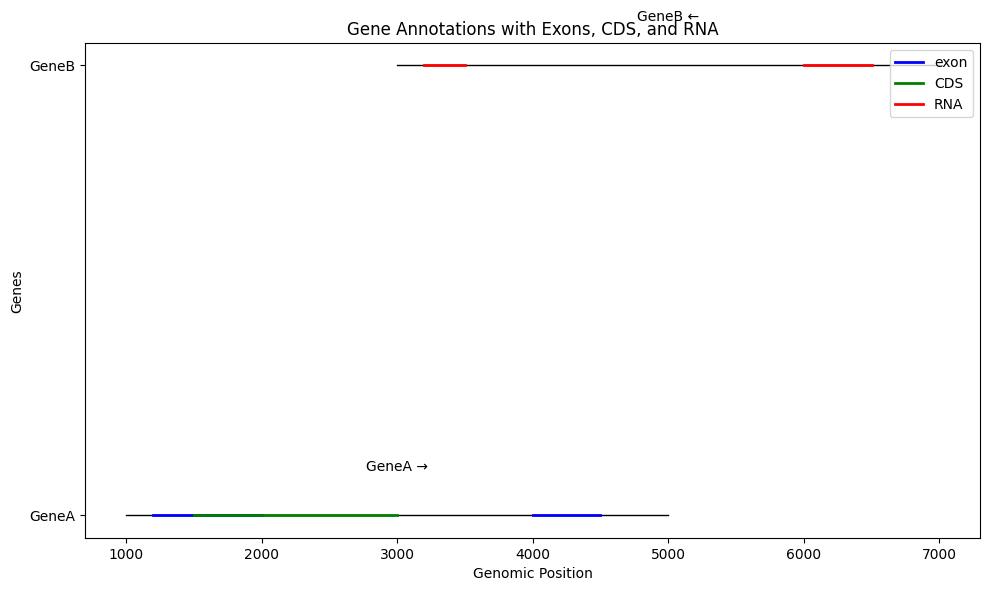

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Mock Data for Genes and Features
genes_data = {
    "ID": ["Gene1", "Gene2"],
    "start": [1000, 3000],
    "end": [5000, 7000],
    "strand": ["+", "-"],
    "Name": ["GeneA", "GeneB"],
    "biotype": ["protein_coding", "RNA"],
}

features_data = {
    "Parent": ["Gene1", "Gene1", "Gene1", "Gene2", "Gene2"],
    "type": ["exon", "CDS", "exon", "RNA", "RNA"],
    "start": [1200, 1500, 4000, 3200, 6000],
    "end": [2000, 3000, 4500, 3500, 6500],
}

# Create DataFrames
genes_df = pd.DataFrame(genes_data)
features_df = pd.DataFrame(features_data)

# Assign y-levels to genes
genes_df["y_pos"] = [1, 2]  # Manually assign y-positions for simplicity

# Define color mapping for feature types
feature_colors = {
    "exon": "blue",
    "CDS": "green",
    "RNA": "red",
}

# --- Plot Setup ---
fig, ax = plt.subplots(figsize=(10, 6))

# Plot Genes and Features
for _, row in genes_df.iterrows():
    y_pos = row["y_pos"]
    strand_symbol = "→" if row["strand"] == "+" else "←"

    # Draw the gene backbone
    ax.plot([row["start"], row["end"]], [y_pos, y_pos], color="black", lw=1)
    ax.text(
        (row["start"] + row["end"]) / 2, y_pos + 0.1, f"{row['Name']} {strand_symbol}",
        ha="center", fontsize=10, color="black"
    )

    # Add features (exons, CDS, RNA, etc.)
    for _, feature_row in features_df[features_df["Parent"] == row["ID"]].iterrows():
        feature_start = feature_row["start"]
        feature_end = feature_row["end"]
        feature_type = feature_row["type"]

        # Use the same plotting method for all features, but with different colors
        ax.plot(
            [feature_start, feature_end], [y_pos, y_pos],
            color=feature_colors[feature_type], lw=2, label=feature_type
        )

# Customize the plot
ax.set_yticks(genes_df["y_pos"])
ax.set_yticklabels(genes_df["Name"])
ax.set_xlabel("Genomic Position")
ax.set_ylabel("Genes")
ax.set_title("Gene Annotations with Exons, CDS, and RNA")

# Add legend (remove duplicate labels)
handles, labels = ax.get_legend_handles_labels()
by_label = dict(zip(labels, handles))  # Remove duplicate labels
ax.legend(by_label.values(), by_label.keys(), loc="upper right")

plt.tight_layout()
plt.show()

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.patches import Rectangle

# Set a seed for reproducibility
np.random.seed(42)

# Define the genomic region
chromosome = "2R"
start_region = 28450000
end_region = 28545000

# Load H12 dataset
gambiae = pd.read_csv("/content/gambiae_h12_GWSS_results.csv")
h12_df = gambiae.query(f"chrom == '{chromosome}'").rename(columns={"Chr_pos": "position", "H12": "p_value"})
h12_df = h12_df[["position", "p_value"]]

# Filter for the selected region
h12_df = h12_df.query(f"{start_region} <= position <= {end_region}")

# Load gene annotations
genes_df = ag3.genome_features(region=f"{chromosome}:{start_region}-{end_region}").query("type == 'gene'")
genes_df = genes_df[['contig', 'start', 'end', 'strand', 'ID', 'Name', 'type', 'biotype']]

# Ensure only relevant chromosome data
genes_df = genes_df.query(f"contig == '{chromosome}'")

# Handle missing gene names
genes_df["Name"] = genes_df["Name"].fillna(genes_df["ID"])  # Use ID if Name is missing

# If no genes are found, print a message
if genes_df.empty:
    print("No genes found in the selected region!")

# --- Automatic Y-Position Assignment ---
# Sort genes by their start position
genes_df = genes_df.sort_values(by="start")

# Assign y-levels to genes based on overlap
y_levels = []  # List to store the y-level for each gene
for _, row in genes_df.iterrows():
    # Find the first available y-level that doesn't overlap with existing genes
    overlapping_levels = set()
    for i, (s, e, y) in enumerate(y_levels):
        if not (row["end"] < s or row["start"] > e):
            overlapping_levels.add(y)

    # Assign the lowest available y-level
    available_level = 1
    while available_level in overlapping_levels:
        available_level += 1

    y_levels.append((row["start"], row["end"], available_level))

# Add y-levels to the genes DataFrame
genes_df["y_pos"] = [y for _, _, y in y_levels]

# --- Load Exon, CDS, and RNA Annotations ---
# Assuming you have a function to load these features
features_df = ag3.genome_features(region=f"{chromosome}:{start_region}-{end_region}").query("type in ['exon', 'CDS', 'RNA']")
features_df = features_df[['contig', 'start', 'end', 'strand', 'type', 'Parent']]

# Merge features with genes to get y_pos
features_df = features_df.merge(genes_df[['ID', 'y_pos']], left_on='Parent', right_on='ID', how='left')

# --- Plot Setup ---
# Increase figure size (width, height)
fig, ax = plt.subplots(3, 1, figsize=(15, 12), gridspec_kw={"height_ratios": [1, 3, 2]}, sharex=True)

# --- Top Panel: SNP Density ---
sns.kdeplot(h12_df["position"], ax=ax[0], fill=True, color="blue")
ax[0].set_ylabel("Density")

# --- Middle Panel: Manhattan-Style Plot ---
ax[1].scatter(h12_df["position"], -np.log10(h12_df["p_value"]), color="blue", s=10)
ax[1].set_ylabel(r"$-\log_{10}(P)$")

# --- Bottom Panel: Gene Annotations ---
if not genes_df.empty:
    gene_height = 0.5  # Height of each gene box
    padding = 0.2  # Padding between gene boxes

    for _, row in genes_df.iterrows():
        y_pos = row["y_pos"] * (gene_height + padding)
        strand_symbol = "→" if row["strand"] == "+" else "←"

        # Draw the gene box
        ax[2].plot([row["start"], row["end"]], [y_pos, y_pos], color="black", lw=1)  # Gene backbone
        ax[2].text(
            (row["start"] + row["end"]) / 2, y_pos + 0.1, f"{row['Name']} {strand_symbol}",
            ha="center", fontsize=10, color="black"
        )

        # Add exons, CDS, and RNA features
        for _, feature_row in features_df[features_df["Parent"] == row["ID"]].iterrows():
            feature_start = feature_row["start"]
            feature_end = feature_row["end"]
            feature_type = feature_row["type"]

            if feature_type == "exon":
                ax[2].add_patch(Rectangle((feature_start, y_pos - gene_height / 4), feature_end - feature_start, gene_height / 2, color="blue"))
            elif feature_type == "CDS":
                ax[2].add_patch(Rectangle((feature_start, y_pos - gene_height / 4), feature_end - feature_start, gene_height / 2, color="green"))
            elif feature_type == "RNA":
                ax[2].plot([feature_start, feature_end], [y_pos, y_pos], color="red", lw=2)

    ax[2].set_yticks(np.arange(1, max(genes_df["y_pos"]) + 1) * (gene_height + padding))
    ax[2].set_yticklabels([f"Level {i}" for i in range(1, max(genes_df["y_pos"]) + 1)])
    ax[2].set_ylim(0, (max(genes_df["y_pos"]) + 1) * (gene_height + padding))

ax[2].set_ylabel("Genes (automatic y-position)")
ax[2].set_xlabel(f"Position on Chromosome {chromosome}")

# **ZOOM into the region**
ax[2].set_xlim(start_region, end_region)
ax[1].set_xlim(start_region, end_region)
ax[0].set_xlim(start_region, end_region)

plt.tight_layout()
plt.show()

In [ ]:
!wget https://ftp.ensemblgenomes.ebi.ac.uk/pub/metazoa/release-60/gff3/anopheles_gambiae/Anopheles_gambiae.AgamP4.60.chr.gff3.gz
!sudo apt-get install gzip
!gzip -d Anopheles_gambiae.AgamP4.60.chr.gff3.gz

!pip install -qq gffutils

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 23.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.8/43.8 kB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 2.3 MB/s eta 0:00:00


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import gffutils

def load_gff3(gff_file):
    """
    Load gene annotations from a GFF3 file.
    Returns a DataFrame with 'start', 'end', 'name', and 'strand'.
    """
    db = gffutils.create_db(gff_file, dbfn=":memory:", force=True, keep_order=True, merge_strategy="create_unique")

    genes = []
    for gene in db.features_of_type("gene"):
        genes.append({
            "start": gene.start,
            "end": gene.end,
            "name": gene.attributes.get("ID", ["Unknown"])[0],
            "strand": gene.strand
        })

    return pd.DataFrame(genes)

def load_snp_data(snp_file):
    """
    Load SNP positions and H12/iHS values from a CSV or DataFrame.
    Assumes columns: ['chromosome', 'position', 'value']
    """
    return pd.read_csv(snp_file) if isinstance(snp_file, str) else snp_file

def plot_h12_iHs(gene_df, snp_df, chromosome):
    """
    Creates a 3-panel plot:
    1. SNP density
    2. Manhattan-style plot (-log10 H12/iHS)
    3. Gene annotations (handling overlapping genes)
    """
    # Assign different y-levels to overlapping genes
    y_levels = {}
    for _, row in gene_df.iterrows():
        overlapping_levels = [y for (s, e), y in y_levels.items() if not (row["end"] < s or row["start"] > e)]
        current_level = max(overlapping_levels) + 1 if overlapping_levels else 1
        y_levels[(row["start"], row["end"])] = current_level

    gene_df["y_level"] = gene_df.apply(lambda row: y_levels[(row["start"], row["end"])], axis=1)

    fig, ax = plt.subplots(3, 1, figsize=(12, 8), gridspec_kw={"height_ratios": [1, 3, 1]}, sharex=True)

    # --- Top Panel: SNP Density ---
    sns.kdeplot(snp_df["position"], ax=ax[0], fill=True, color="blue")
    ax[0].set_ylabel("Density")

    # --- Middle Panel: Manhattan-Style Plot ---
    ax[1].scatter(snp_df["position"], -np.log10(snp_df["value"]), color="blue", s=10)
    ax[1].set_ylabel(r"$-\log_{10}(\text{H12/iHS})$")

    # --- Bottom Panel: Gene Annotations ---
    for _, row in gene_df.iterrows():
        y_pos = row["y_level"]
        strand_symbol = "→" if row["strand"] == "+" else "←"

        ax[2].plot([row["start"], row["end"]], [y_pos, y_pos], color="red", lw=4)
        ax[2].text((row["start"] + row["end"]) / 2, y_pos + 0.2, f"{row['name']} {strand_symbol}",
                   ha="center", fontsize=8, color="black")

    ax[2].set_yticks(range(1, max(y_levels.values()) + 2))
    ax[2].set_ylabel("Genes (stacked)")
    ax[2].set_xlabel(f"Position on Chromosome {chromosome}")

    plt.tight_layout()
    plt.show()

# Example Usage:
gene_df = load_gff3("/content/Anopheles_gambiae.AgamP4.60.chr.gff3")  # Load genes from GFF3 file
gene_df
# snp_df = pd.read_csv("h12_values.csv")  # Load SNP data from CSV
# plot_h12_iHs(gene_df, snp_df, "2L")  # Plot


,start,end,name,strand
0,17351,18787,gene:AGAP029842,+
1,157348,186936,gene:AGAP004677,-
2,203779,205293,gene:AGAP004678,+
3,207894,210460,gene:AGAP004679,+
4,271285,271815,gene:AGAP004680,+
...,...,...,...,...
12609,23863618,23864713,gene:AGAP013312,-
12610,23957193,23998340,gene:AGAP001091,+
12611,24086190,24087589,gene:AGAP001092,+
12612,24094799,24142048,gene:AGAP001093,+


## Data preparation  for ancestry analysis

In [ ]:
regions = ["2R:28,430,000-28,615,000", "3R:28,400,000-28,600,000", "X:15,130,000-15,324,000", "3R:32,000,000-32,080,000"]
#taxons = ["coluzzii", "gambiae", "bissau", "arabiensis", "melas"]
taxons = ["coluzzii", "gambiae", "bissau"]
country = "Gambia, The"
sample_query = f"country=='{country}' and taxon in {taxons}"
# Construct snp data
gm_snps =ag3.snp_calls(
    region="3R:32,000,000-32,080,000",
    sample_query=sample_query,
)
gm_snps # variants: 656106, alleles: 4samples: 2660, ploidy: 2
# construct population information
taxon_sample = ag3.sample_metadata(sample_query=sample_query)
taxon_sample
# Define pop based on iso and taxon like GM-N_gamb, GM-U_arab etc.
taxon_sample['pop'] = taxon_sample['admin1_iso'] + '_' + taxon_sample['taxon']
taxon_sample.groupby('pop').size()
# kepp pop >= 10
taxon_sample = taxon_sample[taxon_sample['pop'].isin(taxon_sample['pop'].value_counts()[taxon_sample['pop'].value_counts() >= 10].index)]
taxon_sample
# SAve taxon_sample metadata
taxon_sample.to_csv('taxon_sample.csv', sep=',', index=True)


# Get all sample IDs from the dataset
dataset_sample_ids = gm_snps['sample_id'].values  # Array of sample IDs in gm_snps

# Find indices of selected samples
sample_indices = np.where(np.isin(dataset_sample_ids, taxon_sample['sample_id'].values))[0]

# Select samples using indices
gm_snps_selected = gm_snps.isel(samples=sample_indices)
gm_snps_selected

samples_selected = gm_snps_selected['sample_id'].values
samples_selected


# To filter the SNP dataset and warp the dataset to GT array
#filt = 'gamb_colu_arab'
filt = 'gamb_colu'
filt_val = gm_snps_selected[f"variant_filter_pass_{filt}"].values
gt_filtered = allel.GenotypeDaskArray(gm_snps_selected["call_genotype"][filt_val].data)
gt_filtered.shape

(72373, 1134, 2)

In [ ]:
import numpy as np

# Get all sample IDs in the SNP dataset
dataset_sample_ids = gm_snps_selected['sample_id'].values  # Sample IDs in gm_snps_selected

# Get indices of selected samples based on taxon_sample['sample_id']
pop_idx = np.where(np.isin(dataset_sample_ids, taxon_sample['sample_id'].values))[0]

print(pop_idx)  # This should be a list of indices matching the selected population


[   0    1    2 ... 1131 1132 1133]


In [ ]:
from dask.diagnostics.progress import ProgressBar
# compute allele counts and take max_allel=3
with ProgressBar():
  ac = gt_filtered.take(pop_idx, axis=1).count_alleles(max_allele=3).compute()
  #ac = gt_filtered.count_alleles(max_allele=3).compute() # same sine we filtered gt for only our samples

[########################################] | 100% Completed | 15.80 s


In [ ]:
#filter - to keep biallelic and remove missing data
filter_ac = (ac.max_allele() == 1) & (ac[:, :2].min(axis=1) > 1)
gt_rm_miss = gt_filtered.compress(filter_ac, axis=0)
geno_alt = gt_rm_miss.to_n_alt()
geno_alt.shape # 39953 x 2652

(6968, 1134)

In [ ]:
def plot_ld(gn, title):
    """
    Compute LD between SNP and plot pairwise LD.
    """
    m = allel.rogers_huff_r(gn) ** 2
    ax = allel.plot_pairwise_ld(m)
    ax.set_title(title)
plot_ld(geno_alt[:1000], 'Figure 1. Pairwise LD.')

NameError: name 'geno_alt' is not defined

In [ ]:
# Perform LD pruning
import dask.array as da
import allel
import numpy as np
def plot_ld(gn, title):
    """
    Compute LD between SNP and plot pairwise LD.
    """
    m = allel.rogers_huff_r(gn) ** 2
    ax = allel.plot_pairwise_ld(m)
    ax.set_title(title)
def ld_prune(gn, size, step, threshold=.1, n_iter=1):
    """
    Perform LD pruning on genotype data.
    """
    for i in range(n_iter):
        # Convert gn to a NumPy array if it's a Dask array
        if isinstance(gn, da.Array):
            gn = gn.compute()

        loc_unlinked = allel.locate_unlinked(gn, size=size, step=step, threshold=threshold)
        n = np.count_nonzero(loc_unlinked)
        n_remove = gn.shape[0] - n
        print('iteration', i + 1, 'retaining', n, 'removing', n_remove, 'variants')
        gn = gn.compress(loc_unlinked, axis=0)
    return gn

gnu = ld_prune(geno_alt, size=500, step=200, threshold=.1, n_iter=10)
plot_ld(geno_alt[:1000], 'Figure 1. Pairwise LD.')
plot_ld(gnu[:1000], 'Figure 2. Pairwise LD after LD pruning.')

NameError: name 'geno_alt' is not defined

In [ ]:
gnu.shape #8304 x 2652

(8304, 2652)

In [ ]:
import numpy as np
import h5py


# Save the genotype array to a .npy file
np.save('filtered_geno_alt_gamb_colu.npy', geno_alt)

# Save the data in HDF5 format
with h5py.File('filtered_geno_alt_gamb_colu.h5', 'w') as f:
    f.create_dataset('genotypes', data=geno_alt)

from  google.colab import files
files.download('filtered_geno_alt_gamb_colu.npy')
files.download('filtered_geno_alt_gamb_colu.h5')


/usr/local/lib/python3.11/dist-packages/dask/array/core.py:1709: FutureWarning:

The `numpy.save` function is not implemented by Dask array. You may want to use the da.map_blocks function or something similar to silence this warning. Your code may stop working in a future release.



<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
geno_alt = np.load('/content/filtered_geno_alt_gamb_colu.npy')
geno_alt.shape

(38655, 1134)

In [ ]:
!pip install -qq umap
!pip install -qq umap-learn

!pip install -qq  scipy
!pip install -qq scikit-bio

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.4/5.4 MB 37.4 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.7/11.7 MB 93.3 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


/usr/local/lib/python3.11/dist-packages/skbio/stats/ordination/_principal_coordinate_analysis.py:214: RuntimeWarning: The result contains negative eigenvalues that are large in magnitude, which may suggest result inaccuracy. See Notes for details. The negative-most eigenvalue is -261821.79037445586 whereas the largest positive one is 13748822.571512949.
  warn(
/usr/local/lib/python3.11/dist-packages/skbio/util/_plotting.py:53: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()
/usr/local/lib/python3.11/dist-packages/skbio/util/_plotting.py:53: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


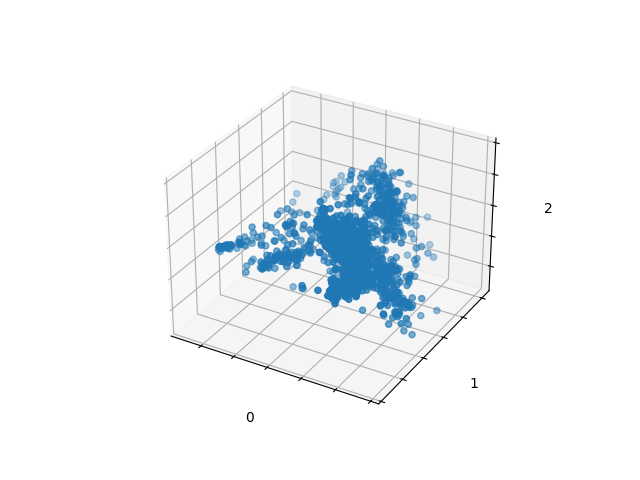

In [ ]:
from skbio.stats.ordination import pcoa
# convert gnu into dataframe
#gm_snp_df = pd.DataFrame(gm_snps)
#gm_snp_df

# Compute pairwise distance
matrix_distance = allel.pairwise_distance(geno_alt, metric='cityblock')
# Perform PCoA using scikit-bio
pcoa_results = pcoa(matrix_distance)
pcoa_results

In [ ]:

# import population info
#load anopheles gambiae from Gambia country
pop_info = taxon_sample[['sample_id', 'taxon', 'pop']]
pop_info


# show variance
pcoa_results.proportion_explained * 100
# save variance
variance_explained = pcoa_results.proportion_explained * 100
variance_explained = pd.DataFrame(variance_explained)
variance_explained.columns = ['variance_explained']
variance_explained.index.name = 'PC'
variance_explained.reset_index(inplace=True)
variance_explained.groupby('PC').sum()
variance_explained.to_csv('variance_explained.csv', sep=',', index=True)
variance_explained

,PC,variance_explained
0,PC1,6.933875
1,PC2,5.203991
2,PC3,3.376813
3,PC4,3.086981
4,PC5,2.356611
...,...,...
1129,PC1130,0.000000
1130,PC1131,0.000000
1131,PC1132,0.000000
1132,PC1133,0.000000


<ipython-input-9-281218ab5868>:55: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  plt.xlabel(f'PC{x} ({pcoa_results.proportion_explained[x-1]*100:.2f}% Variance)')
<ipython-input-9-281218ab5868>:56: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  plt.ylabel(f'PC{y} ({pcoa_results.proportion_explained[y-1]*100:.2f}% Variance)')


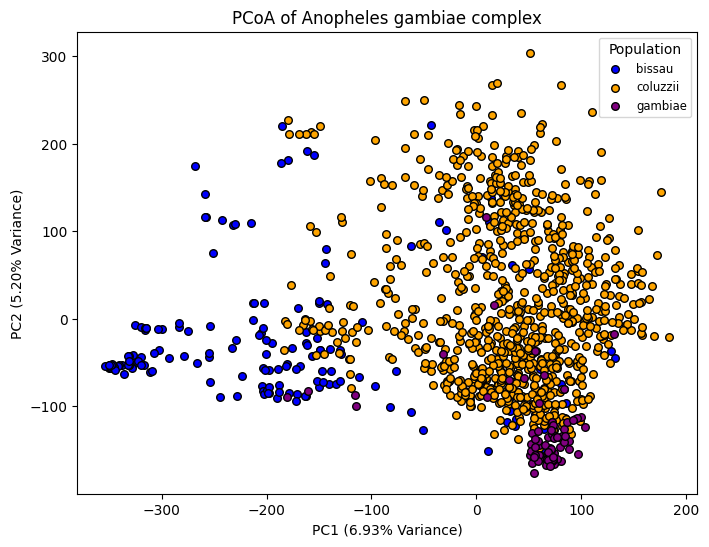

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
# Extract population labels as list to match with geno
population_labels = pop_info['taxon'].tolist()
population_labels

# Plot PCoA results with colors by population
plt.figure(figsize=(8, 6))
#plt.figure(figsize=(12, 10))

# Create a color palette for each population
unique_populations = np.unique(population_labels)
unique_populations
# create color palette
color_map = {
    'GM-L_coluzzii':'#80A1D4',
    'GM-M_bissau': '#D47F7F',
    'GM-M_coluzzii':'#E4BD3C',
    'GM-M_gambiae': '#3CE488',
    'GM-N_bissau': 'black',
    'GM-N_coluzzii':'#171A2F',
    'GM-U_coluzzii': '#23021E',
    'GM-U_gambiae': '#BD0BA2',
    'GM-W_bissau': '#A2789C',
    'GM-W_coluzzii': '#4A1414',
    'GM-W_gambiae': '#EE0202'
}

# define color palette manually
population_color_map = {
    'gambiae': 'purple',
    'bissau': 'blue',
    'coluzzii': 'orange',
    'arabiensis': 'red',
    'melas': 'green'
}
"""population_color_map = {
    'GM-U': 'blue',
    'GM-M': 'green',
    'GM-W': 'orange',
    'GM-N': 'purple',
    'GM-L': 'red'
}"""

# Scatter plot with colors assigned by population
x=1
y=2
for pop in unique_populations:
    mask = np.array(population_labels) == pop
    plt.scatter(pcoa_results.samples[f'PC{x}'][mask], pcoa_results.samples[f'PC{y}'][mask],
                label=pop, color=population_color_map[pop], edgecolor='k', s=30)

# Add plot details
plt.title('PCoA of Anopheles gambiae complex')
plt.xlabel(f'PC{x} ({pcoa_results.proportion_explained[x-1]*100:.2f}% Variance)')
plt.ylabel(f'PC{y} ({pcoa_results.proportion_explained[y-1]*100:.2f}% Variance)')
plt.legend(title='Population', loc='best', fontsize='small')
#plt.savefig('pcoa_taxon_with_LD_pruning_sweep_sel.png')
plt.show()

#pcoa_results.samples.to_csv('pcoa_taxon_sweep_sel_pruned.csv', sep=',', index=True)
# SAve the matrix
#np.save('matrix_distance_pruned.npy', matrix_distance)
#files.download('matrix_distance_pruned.npy')



## Usign SNP filter allel gamb_colu_arab
All regions under sweep selection combine into one show tree main cluster with arabiensis and melas isolated from each other.
coluzzii, gambiae s.s and bissau are cluster into one. This is by using LD pruned data. Howerver when we keep all LD locus, we are having 4 with gambiae s.s and bissau clustered together and coluzii in one cluster when looking PC2 and PC3

## Using SNP filter allel gamb_colu
Without LD pruning, bissau is a bit close to gambiae s.s and give same pca result from 3 chrommosome

Therefore, the region 3R:32,000,000-32,080,000 show a mixed cluster between gambiae s.s and coluzzii. Another isolate cluster i also find with only Bissau molecular form. Even if some indivdu from Bissau are mixed into the other cluster, it show that Northern bank pop(or some) is displaying some local adpatation compare to the rest, which mean independant evolution of that population and confirm our hypothesis, Bissau pop at this locus is showing independant evolution. This region encompase Ors(Odorants receptors genes)

# workflow to prepare SNP data and plot PCoA and UMAP

In [ ]:
#!pip install -qq umap
#!pip install -qq umap-learn

!pip install -qq  scipy
!pip install -qq scikit-bio
#!pip uninstall -y umap
!pip install -q umap-learn
import umap.umap_ as umap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.4/5.4 MB 41.4 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.7/11.7 MB 67.2 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [ ]:
# SNP data
from dask.diagnostics.progress import ProgressBar

def get_snp_data(region, sample_query, filter):
    print(f"Processing SNP data for region: {region}")
    # Construct snp data
    gm_snps =ag3.snp_calls(
        region=region,
        sample_query=sample_query,)

    # construct population information
    taxon_sample = ag3.sample_metadata(sample_query=sample_query)
    # Define pop based on iso and taxon like GM-N_gamb, GM-U_arab etc.
    taxon_sample['pop'] = taxon_sample['admin1_iso'] + '_' + taxon_sample['taxon']
    taxon_sample.groupby('pop').size()
    # kepp pop >= 10
    taxon_sample = taxon_sample[taxon_sample['pop'].isin(taxon_sample['pop'].value_counts()[taxon_sample['pop'].value_counts() >= 10].index)]
    # SAve taxon_sample metadata
    taxon_sample.to_csv('taxon_sample.csv', sep=',', index=True)

    # Get all sample IDs from the dataset
    dataset_sample_ids = gm_snps['sample_id'].values  # Array of sample IDs in gm_snps

    # Find indices of selected samples
    sample_indices = np.where(np.isin(dataset_sample_ids, taxon_sample['sample_id'].values))[0]

    # Select samples using indices
    gm_snps_selected = gm_snps.isel(samples=sample_indices)

    samples_selected = gm_snps_selected['sample_id'].values

    # To filter the SNP dataset and warp the dataset to GT array
    #filt = 'gamb_colu_arab'
    filt_val = gm_snps_selected[f"variant_filter_pass_{filter}"].values
    gt_filtered = allel.GenotypeDaskArray(gm_snps_selected["call_genotype"][filt_val].data)

    return gt_filtered, gm_snps_selected, taxon_sample


def snp_filtering_proccess(gt_filtered, gm_snps_selected, taxon_sample):
  # Get all sample IDs in the SNP dataset
  dataset_sample_ids = gm_snps_selected['sample_id'].values  # Sample IDs in gm_snps_selected

  # Get indices of selected samples based on taxon_sample['sample_id']
  pop_idx = np.where(np.isin(dataset_sample_ids, taxon_sample['sample_id'].values))[0]
  with ProgressBar():
    ac = gt_filtered.take(pop_idx, axis=1).count_alleles(max_allele=3).compute()
  #filter - to keep biallelic and remove missing data
  filter_ac = (ac.max_allele() == 1) & (ac[:, :2].min(axis=1) > 1)
  gt_rm_miss = gt_filtered.compress(filter_ac, axis=0)
  geno_alt = gt_rm_miss.to_n_alt()

  return geno_alt


In [ ]:
# Perform LD pruning
import dask.array as da
import allel
import numpy as np
def plot_ld(gn, title):
    """
    Compute LD between SNP and plot pairwise LD.
    """
    m = allel.rogers_huff_r(gn) ** 2
    ax = allel.plot_pairwise_ld(m)
    ax.set_title(title)
def ld_prune(gn, size, step, threshold=.1, n_iter=1):
    """
    Perform LD pruning on genotype data.
    """
    for i in range(n_iter):
        # Convert gn to a NumPy array if it's a Dask array
        if isinstance(gn, da.Array):
            gn = gn.compute()

        loc_unlinked = allel.locate_unlinked(gn, size=size, step=step, threshold=threshold)
        n = np.count_nonzero(loc_unlinked)
        n_remove = gn.shape[0] - n
        print('iteration', i + 1, 'retaining', n, 'removing', n_remove, 'variants')
        gn = gn.compress(loc_unlinked, axis=0)
    return gn

In [ ]:
!rm *.*

In [ ]:
# SNP data processing
regions = ["2R:28,430,000-28,615,000", "3R:28,400,000-28,600,000", "X:15,130,000-15,324,000", "3R:32,000,000-32,080,000"]
taxons = ["coluzzii", "gambiae", "bissau", "arabiensis", "melas"]
#taxons = ["coluzzii", "gambiae", "bissau"]
country = "Gambia, The"
sample_query = f"country=='{country}' and taxon in {taxons}"
filter = 'gamb_colu_arab'
#filter = 'gamb_colu'
region = regions
gt_filtered, gm_snps_selected, taxon_sample = get_snp_data(region, sample_query, filter)
geno_alt = snp_filtering_proccess(gt_filtered, gm_snps_selected, taxon_sample)

geno_alt.shape

Processing SNP data for region: ['2R:28,430,000-28,615,000', '3R:28,400,000-28,600,000', 'X:15,130,000-15,324,000', '3R:32,000,000-32,080,000']
[########################################] | 100% Completed | 162.15 s


(39953, 2652)

iteration 1 retaining 18754 removing 21199 variants
iteration 2 retaining 13347 removing 5407 variants
iteration 3 retaining 11187 removing 2160 variants
iteration 4 retaining 10046 removing 1141 variants
iteration 5 retaining 9455 removing 591 variants
iteration 6 retaining 9045 removing 410 variants
iteration 7 retaining 8768 removing 277 variants
iteration 8 retaining 8571 removing 197 variants
iteration 9 retaining 8433 removing 138 variants
iteration 10 retaining 8304 removing 129 variants


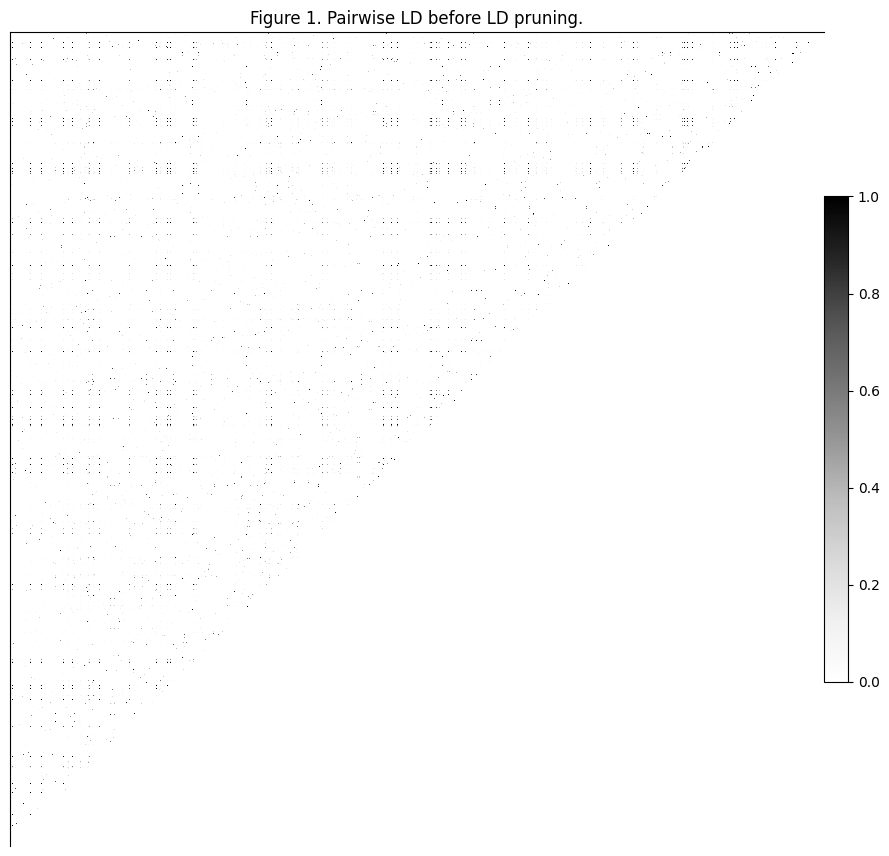

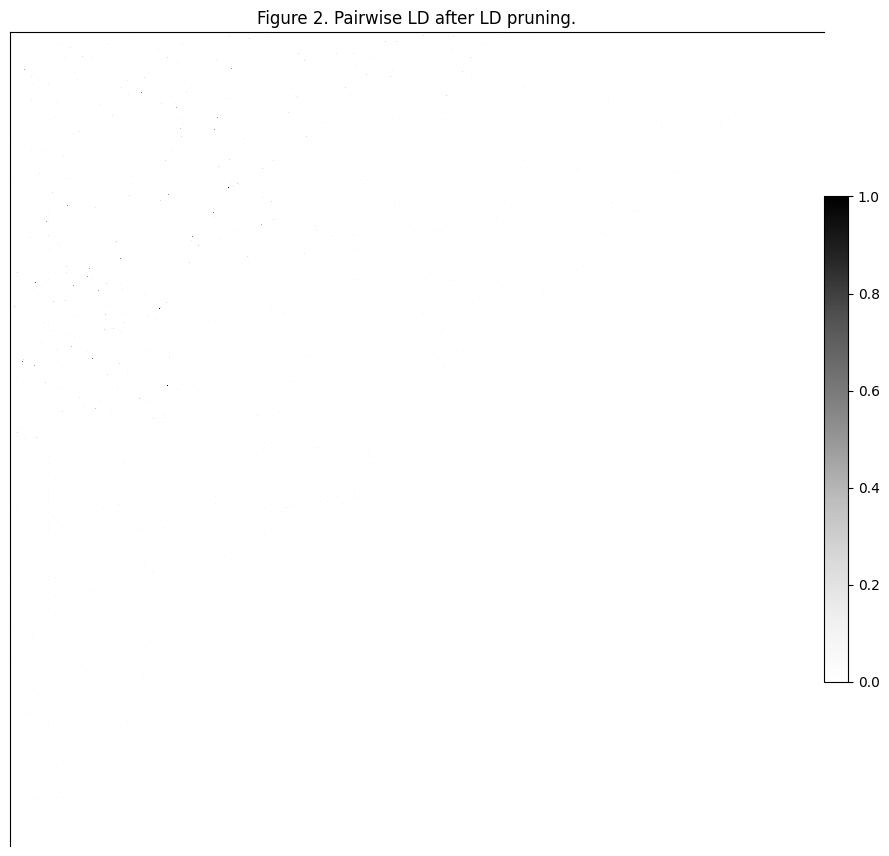

In [ ]:
# LD perform LD pruning
gnu = ld_prune(geno_alt, size=500, step=200, threshold=.1, n_iter=10)
plot_ld(geno_alt[:1000], 'Figure 1. Pairwise LD before LD pruning.')
plot_ld(gnu[:1000], 'Figure 2. Pairwise LD after LD pruning.')

In [ ]:
gnu.shape

(1250, 1134)

In [ ]:
# save genotype data
from google.colab import files
np.save('filtered_geno_alt_gamb_colu.npy', geno_alt)
np.save('filtered_geno_alt_gamb_colu_pruned.npy', gnu)

files.download('filtered_geno_alt_gamb_colu.npy')
files.download('filtered_geno_alt_gamb_colu_pruned.npy')

/usr/local/lib/python3.11/dist-packages/dask/array/core.py:1709: FutureWarning:

The `numpy.save` function is not implemented by Dask array. You may want to use the da.map_blocks function or something similar to silence this warning. Your code may stop working in a future release.



<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

/usr/local/lib/python3.11/dist-packages/skbio/stats/ordination/_principal_coordinate_analysis.py:214: RuntimeWarning:

The result contains negative eigenvalues that are large in magnitude, which may suggest result inaccuracy. See Notes for details. The negative-most eigenvalue is -289791.66499174054 whereas the largest positive one is 4075284.6126713.

/usr/local/lib/python3.11/dist-packages/skbio/util/_plotting.py:53: UserWarning:

Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.

/usr/local/lib/python3.11/dist-packages/skbio/util/_plotting.py:53: UserWarning:

Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.



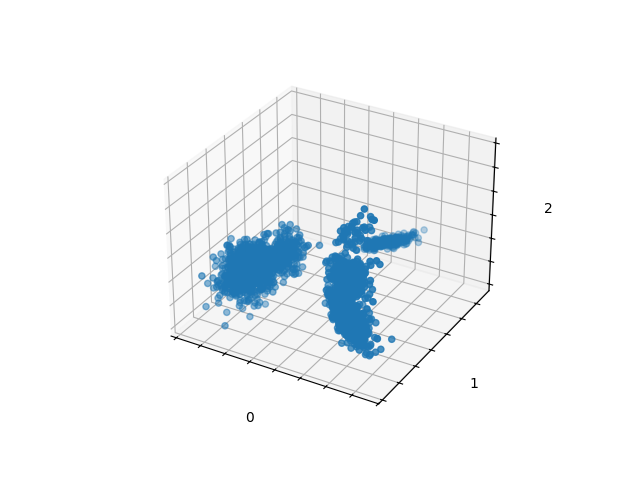

In [ ]:
# Perform PCoA
from skbio.stats.ordination import pcoa

# Compute pairwise distance
matrix_distance = allel.pairwise_distance(gnu, metric='cityblock')
# Perform PCoA using scikit-bio
pcoa_results = pcoa(matrix_distance)

#save pcoa
#pcoa_results.samples.to_csv(f'pcoa_taxon_{region}.csv', sep=',', index=True)
#pcoa_results.samples.to_csv(f'pcoa_taxon_all_region.csv', sep=',', index=True)


pcoa_results

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns


# import population info
#taxon_sample = pd.read_csv('taxon_sample.csv')

#load anopheles gambiae from Gambia country
pop_info = taxon_sample[['sample_id', 'taxon', 'pop']]
pop_info


# show variance
pcoa_results.proportion_explained * 100
# save variance
variance_explained = pcoa_results.proportion_explained * 100
variance_explained = pd.DataFrame(variance_explained)
variance_explained.columns = ['variance_explained']
variance_explained.index.name = 'PC'
variance_explained.reset_index(inplace=True)
variance_explained.groupby('PC').sum()
variance_explained.to_csv(f'variance_explained_all_reigion.csv', sep=',', index=True)
variance_explained



,PC,variance_explained
0,PC1,51.795878
1,PC2,23.296932
2,PC3,1.927995
3,PC4,1.242499
4,PC5,1.009917
...,...,...
2647,PC2648,0.000000
2648,PC2649,0.000000
2649,PC2650,0.000000
2650,PC2651,0.000000


In [ ]:
!rm *.png

<ipython-input-28-278cda244ab1>:47: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

<ipython-input-28-278cda244ab1>:48: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



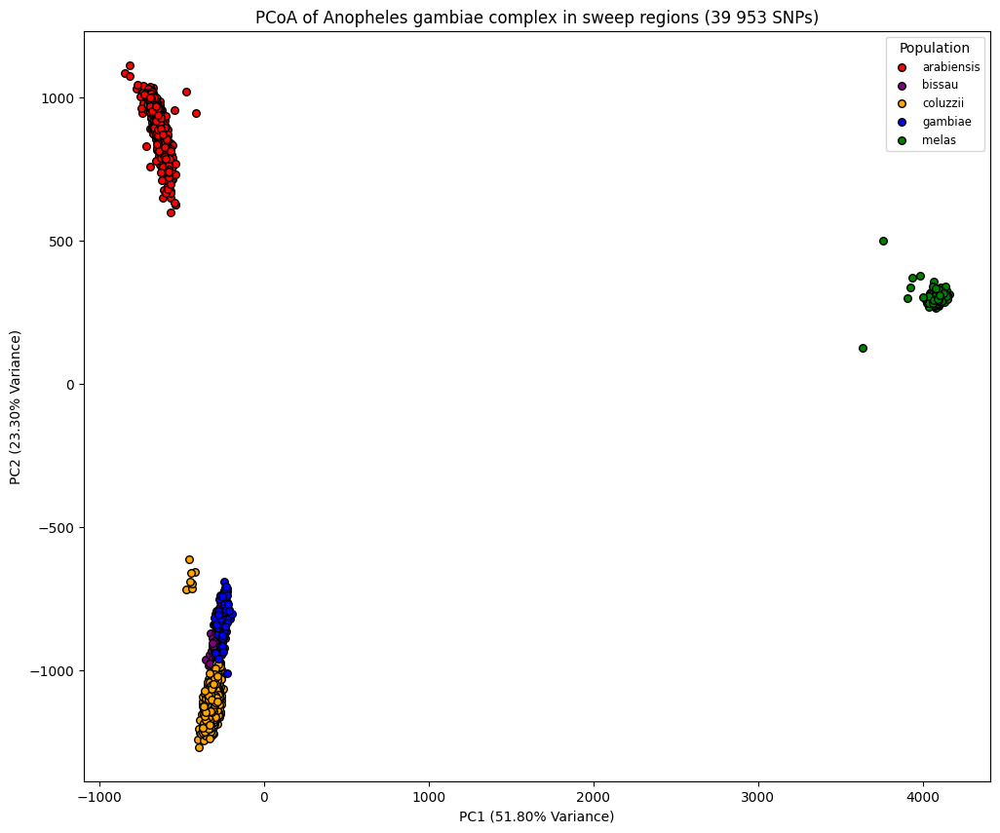

In [ ]:
# Extract population labels as list to match with geno
population_labels = pop_info['taxon'].tolist()
population_labels

# Plot PCoA results with colors by population
#plt.figure(figsize=(8, 6))
plt.figure(figsize=(12, 10))

# Create a color palette for each population
unique_populations = np.unique(population_labels)
unique_populations
# create color palette
color_map = {
    'GM-L_coluzzii':'red',
    'GM-M_bissau': '#D47F7F',
    'GM-M_coluzzii':'orange',
    'GM-M_gambiae': '#3CE488',
    'GM-N_bissau': 'black',
    'GM-N_coluzzii':'blue',
    'GM-U_coluzzii': 'yellow',
    'GM-U_gambiae': '#BD0BA2',
    'GM-W_bissau': '#A2789C',
    'GM-W_coluzzii': '#4A1414',
    'GM-W_gambiae': 'green'
}

# define color palette manually
population_color_map = {
    'bissau': 'purple',
    'gambiae': 'blue',
    'coluzzii': 'orange',
    'arabiensis': 'red',
    'melas': 'green'
}

# Scatter plot with colors assigned by population
x=1
y=2
for pop in unique_populations:
    mask = np.array(population_labels) == pop
    plt.scatter(pcoa_results.samples[f'PC{x}'][mask], pcoa_results.samples[f'PC{y}'][mask],
                label=pop, color=population_color_map[pop], edgecolor='k', s=30)

# Add plot details
#plt.title(f'PCoA of Anopheles gambiae complex using region: {region} (6 968 SNPs)')
plt.title(f'PCoA of Anopheles gambiae complex in sweep regions (39 953 SNPs)')
plt.xlabel(f'PC{x} ({pcoa_results.proportion_explained[x-1]*100:.2f}% Variance)')
plt.ylabel(f'PC{y} ({pcoa_results.proportion_explained[y-1]*100:.2f}% Variance)')
plt.legend(title='Population', loc='best', fontsize='small')
# plt.savefig(f'pcoa_taxon_PC{x}_vs_PC{y}_{region}.png')
#plt.savefig(f'pcoa_taxon_all_region_pruned_PC{x}_vs_PC{y}.png')
plt.savefig(f'pcoa_taxon_all_region_PC{x}_vs_PC{y}.png')
plt.show()


In [ ]:
# Dowload all PNG
from google.colab import files
# collect all png files
png_files = !ls *.png
# download all png files
for file in png_files:
    files.download(file)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
def draw_umap(n_neighbors=15, min_dist=0.1, n_components=3, metric='euclidean', title=''):
    fit = umap.UMAP(
        n_neighbors=n_neighbors,
        min_dist=min_dist,
        n_components=n_components,
        metric=metric
    )
    u = fit.fit_transform(gnu.T);
    return u
# Get UMAP results
umap_results = draw_umap(n_neighbors=20, min_dist=0.1, n_components=3, metric='euclidean', title='UMAP')
# Create a color mapping dictionary
unique_pops = umap_df['population'].unique()
#colors = plt.cm.get_cmap('viridis', len(unique_pops))  # Use 'viridis' colormap or any other colormap
#pop_color_map = {pop: colors(i) for i, pop in enumerate(unique_pops)}
pop_color_map = {
    'bissau': 'purple',
    'gambiae': 'blue',
    'coluzzii': 'orange',
    'arabiensis': 'red',
    'melas': 'green'
}

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
# Map populations to colors
sample_to_pop = dict(zip(taxon_sample['sample_id'], taxon_sample['taxon']))
sample_ids = taxon_sample['sample_id'].values
pop_labels = [sample_to_pop[sample_id] for sample_id in sample_ids]
colors = [pop_color_map[pop] for pop in pop_labels]
# Plot the points with colors
ax.scatter(umap_results[:,0], umap_results[:,1], umap_results[:,2], c=colors, s=100)
plt.title('UMAP', fontsize=18)
plt.show()

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.metrics import pairwise_distances
import umap

# Perform UMAP
umap_model = umap.UMAP(n_components=3)
# transpose geno_alt
geno_alt_T = geno_alt.T
# Fit UMAP model
umap_results = umap_model.fit_transform(geno_alt_T)

# Convert results to DataFrame for easier plotting
umap_df = pd.DataFrame(umap_results, columns=['UMAP1', 'UMAP2', 'UMAP3'])
umap_df

In [ ]:
import plotly.express as px
import pandas as pd

# Create mapping from sample ID to population
sample_to_pop = dict(zip(taxon_sample['sample_id'], taxon_sample['taxon']))

#add sample_id to umap_df
umap_df = pd.DataFrame(umap_results, columns=['UMAP1', 'UMAP2', 'UMAP3'])
umap_df['sample_id'] = taxon_sample['sample_id'].values

# Ensure sample IDs exist in the mapping to avoid KeyError
umap_df['population'] = umap_df['sample_id'].map(sample_to_pop)

# Define custom colors for populations
pop_color_map = {
    'coluzzii': 'orange',
    'bissau': 'purple',
    'gambiae': 'blue'
}

# Create 3D scatter plot with proper color mapping
fig = px.scatter_3d(
    umap_df, x='UMAP1', y='UMAP2', z='UMAP3',
    color='population', labels={'color': 'Population'},
    color_discrete_map=pop_color_map  # Ensure correct color assignment
)

fig.update_traces(marker=dict(size=8))
fig.show()

In [ ]:
!pip install -qq umap-learn[plot]
#!pip install -qq pandas matplotlib datashader bokeh holoviews scikit-image colorcet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 41.9 MB/s eta 0:00:00


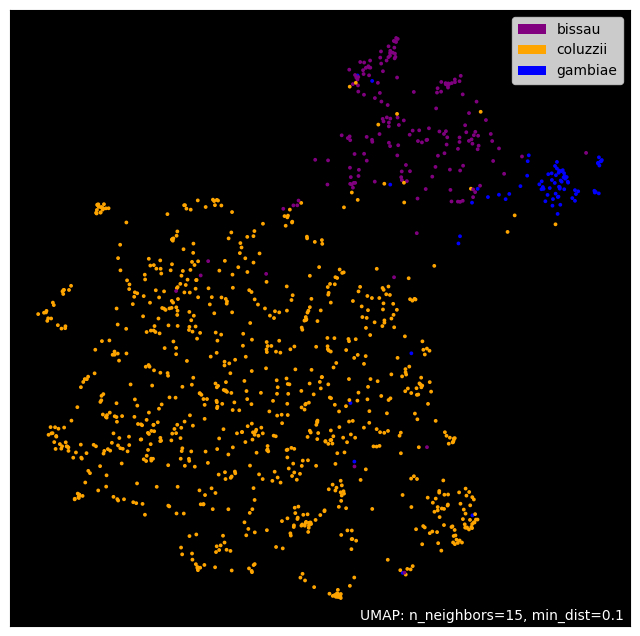

In [ ]:
#import umap
#import umap.umap_ as umap

import umap.plot  # Ensure UMAP plotting is installed: pip install umap-learn[plot]

# Perform UMAP
umap_model = umap.UMAP(n_components=2, random_state=42)

# Transpose geno_alt (assuming geno_alt is a NumPy array or Pandas DataFrame)
geno_alt_T = geno_alt.T

# Fit and transform UMAP model
umap_results = umap_model.fit_transform(geno_alt_T)

# Create a mapping from sample IDs to population
sample_to_pop = dict(zip(taxon_sample['sample_id'], taxon_sample['taxon']))
sample_ids = taxon_sample['sample_id'].values
# Map the populations to your PCoA and UMAP results
umap_df = pd.DataFrame(umap_results, columns=['UMAP1', 'UMAP2'])
umap_df
umap_df['population'] = [sample_to_pop[sample_id] for sample_id in sample_ids]  # same for umap_df

# Save result
umap_df.to_csv(f'umap_taxon_all_region_PC1_vs_PC2.csv', sep=',', index=True)
# Ensure 'population' column exists in umap_df
if 'population' in umap_df.columns:

    fig = umap.plot.points(umap_model, labels=umap_df['population'], theme="fire", color_key=population_color_map)
    plt.savefig(f'umap_taxon_all_regionPC1_vs_PC2.png')
    plt.show()
else:
    print("Warning: 'population' column not found in umap_df")

/usr/local/lib/python3.11/dist-packages/umap/plot.py:895: UserWarning:

Hammer edge bundling is expensive for large graphs!
This may take a long time to compute!



<Axes: >

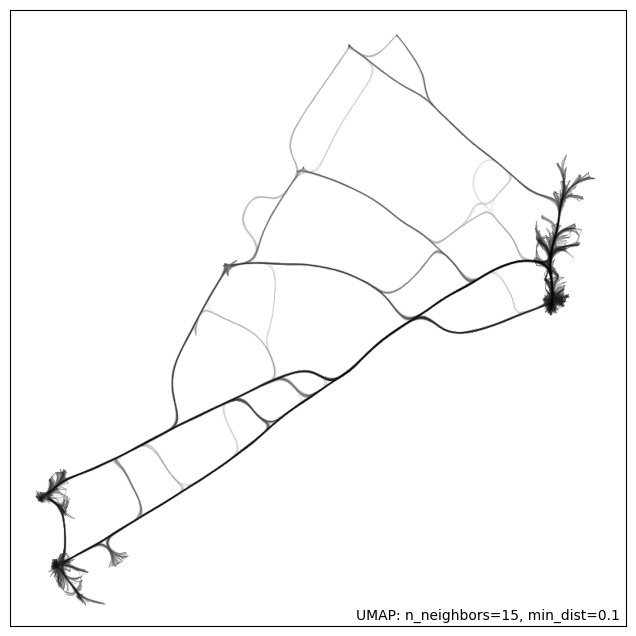

In [ ]:
umap.plot.connectivity(umap_model,  edge_bundling='hammer')

# Perform PCoA-UMAP


##Optional: adding UMAP for Supervised Dimension Reduction and Metric Learning step

In [ ]:
!pip uninstall -y umap
!pip install -q umap-learn
import umap.umap_ as umap

In [ ]:
!rm *.*

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



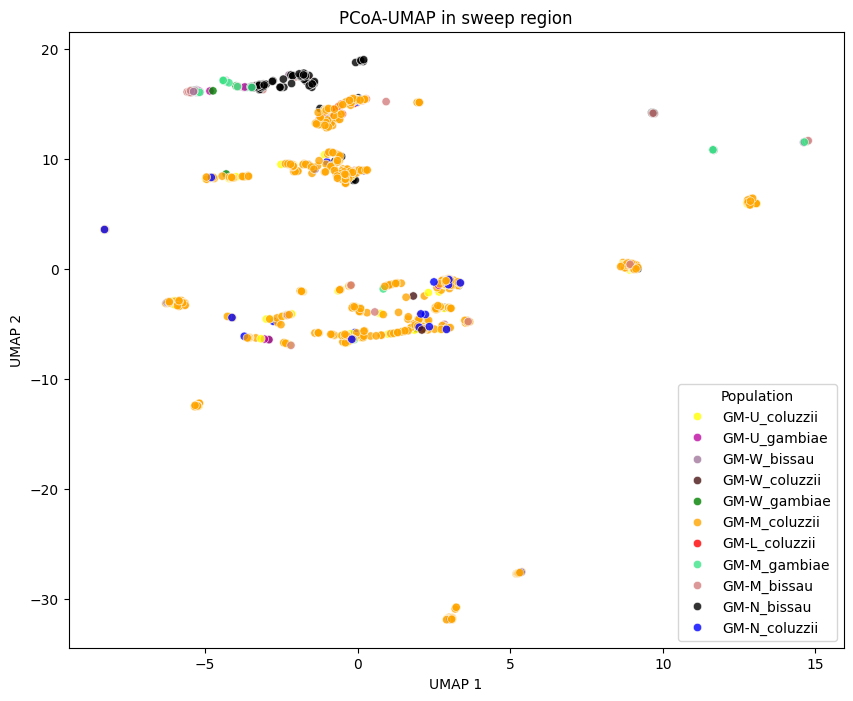

In [ ]:
#import umap
import seaborn as sns
import matplotlib.pyplot as plt
# Get  the pcoa resuts
# Convert to NumPy array for UMAP
pcoa_coords = pcoa_results.samples.iloc[:, :20]  # Select first 20 PCoA axes


# Apply UMAP on PCoA coordinates

umap_model = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=2, metric="euclidean") # min_dist=0.5 for fine features on UMAP more visible
umap_results = umap_model.fit_transform(pcoa_coords)  # Using the same genotype data (PCoA transformed)

# Map the populations to your PCoA and UMAP results
umap_df = pd.DataFrame(umap_results, columns=['UMAP1', 'UMAP2'])

# Assuming you have a DataFrame `taxon_sample` that includes sample IDs and their populations
taxon_sample
# Create a mapping from sample IDs to population
#sample_to_pop = dict(zip(taxon_sample['sample_id'], taxon_sample['taxon']))
sample_to_pop = dict(zip(taxon_sample['sample_id'], taxon_sample['pop']))
sample_ids = taxon_sample['sample_id'].values
# Map the populations to your PCoA and UMAP results
umap_df['population'] = [sample_to_pop[sample_id] for sample_id in sample_ids]  # same for umap_df

# Ensure population column has no NaN values (to avoid issues)
umap_df = umap_df.dropna(subset=['population'])

# Define custom colors for populations
pop_color_map = {
    'coluzzii': 'orange',
    'bissau': 'purple',
    'gambiae': 'blue',
    'arabiensis': 'red',
    'melas': 'green'
}

# Map population values to colors
umap_df['color'] = umap_df['population'].map(color_map )

# 🎨 Scatter plot using explicit colors
plt.figure(figsize=(10, 8))
sns.scatterplot(x="UMAP1", y="UMAP2", hue="population", palette=color_map, data=umap_df, alpha=0.8)

plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.title(f"PCoA-UMAP in sweep region")

plt.legend(title="Population")
plt.savefig(f'pcoa_umap_PC1_vs_PC2_all_region.png')
plt.show()
# save the fig
#Save umpa
umap_df.to_csv(f'umap_taxon__PC1_vs_PC2_all_region.csv', sep=',', index=True)


In [ ]:
!pip install -qq umap-learn[plot]
import umap.plot  # Ensure UMAP plotting is installed: pip install umap-learn[plot]

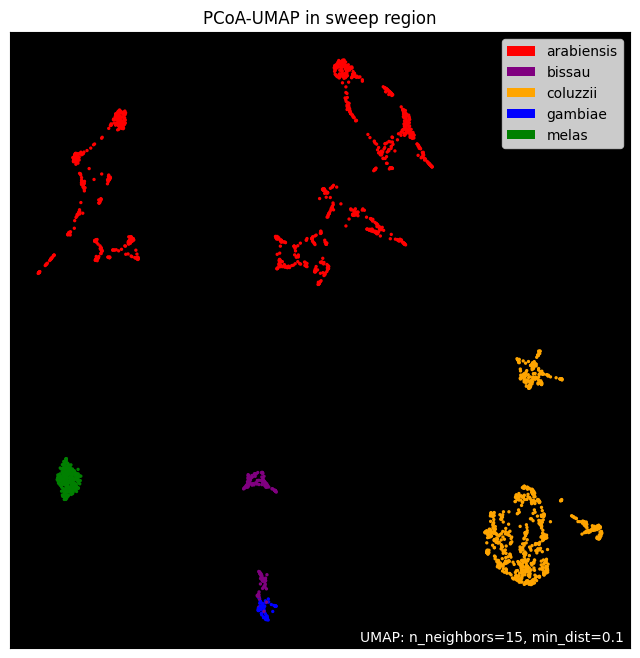

In [ ]:
fig = umap.plot.points(umap_model, labels=umap_df['population'], color_key=population_color_map, theme="fire")
plt.title(f"PCoA-UMAP in sweep region")
plt.savefig(f'PcoA-UMAP_taxon_all_regionPC1_vs_PC2.png')
plt.show()

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



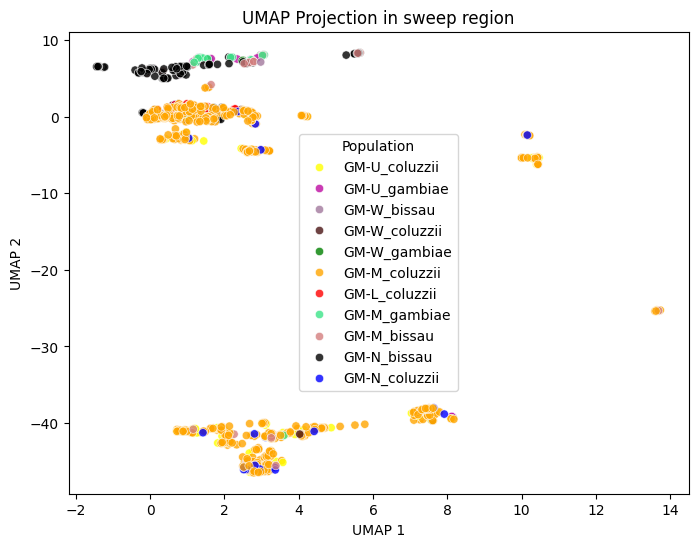

In [ ]:
#import umap
import seaborn as sns
import matplotlib.pyplot as plt
# Get  the pcoa resuts
# Convert to NumPy array for UMAP
pcoa_coords = pcoa_results.samples.iloc[:, :20]  # Select first 20 PCoA axes


# Apply UMAP on PCoA coordinates

umap_model = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=2, metric="euclidean") # min_dist=0.5 for fine features on UMAP more visible
umap_results = umap_model.fit_transform(geno_alt.T)  # Using the same genotype data (PCoA transformed)

# Map the populations to your PCoA and UMAP results
umap_df = pd.DataFrame(umap_results, columns=['UMAP1', 'UMAP2'])

# Assuming you have a DataFrame `taxon_sample` that includes sample IDs and their populations
# Create a mapping from sample IDs to population
sample_to_pop = dict(zip(taxon_sample['sample_id'], taxon_sample['taxon']))
sample_to_pop = dict(zip(taxon_sample['sample_id'], taxon_sample['pop']))
sample_ids = taxon_sample['sample_id'].values
# Map the populations to your PCoA and UMAP results
umap_df['population'] = [sample_to_pop[sample_id] for sample_id in sample_ids]  # same for umap_df

# Ensure population column has no NaN values (to avoid issues)
umap_df = umap_df.dropna(subset=['population'])

# Define custom colors for populations
pop_color_map = {
    'coluzzii': 'orange',
    'bissau': 'purple',
    'gambiae': 'blue',
    'arabiensis': 'red',
    'melas': 'green'
}

# Map population values to colors
umap_df['color'] = umap_df['population'].map(color_map)

# 🎨 Scatter plot using explicit colors
plt.figure(figsize=(8, 6))
sns.scatterplot(x="UMAP1", y="UMAP2", hue="population", palette=color_map, data=umap_df, alpha=0.8)

plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.title(f"UMAP Projection in sweep region")
plt.legend(title="Population")
#save
plt.savefig(f'umap_PC1_vs_PC2_all_region.png')
plt.show()



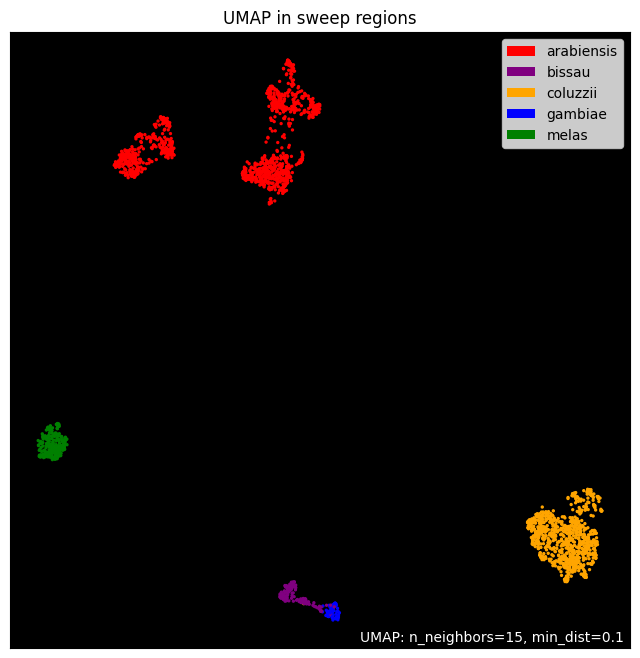

In [ ]:
fig = umap.plot.points(umap_model, labels=umap_df['population'], color_key=population_color_map, theme="fire")
plt.title(f"UMAP in sweep regions")
plt.savefig(f'UMAP_taxon_all_region_PC1_vs_PC2.png')
plt.show()

In [ ]:
#  dowload all results
from google.colab import files
import glob
# collect all png files
png_files = glob.glob('*.png')
csv_files = glob.glob('*.csv')
# download all png files
for file in png_files:
    files.download(file)
for file in csv_files:
    files.download(file)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


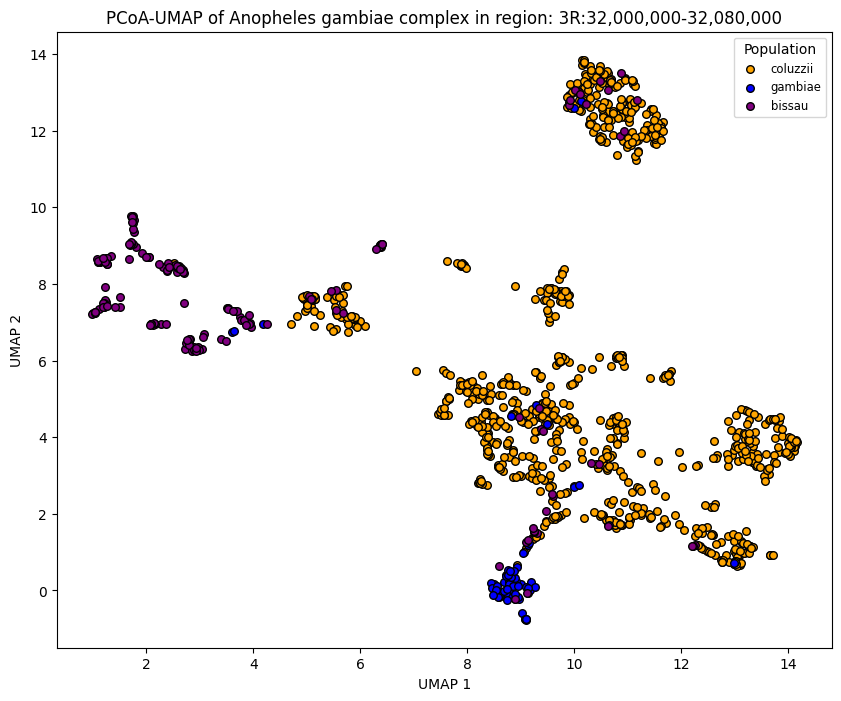

In [ ]:
import umap
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Convert to NumPy array for UMAP
pcoa_coords = pcoa_results.samples.iloc[:, :20]  # Select first 20 PCoA axes

# Apply UMAP
umap_model = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=2, metric="euclidean")
umap_results = umap_model.fit_transform(pcoa_coords)

# Create DataFrame for UMAP results
umap_df = pd.DataFrame(umap_results, columns=['UMAP1', 'UMAP2'])
sample_to_pop = dict(zip(taxon_sample['sample_id'], taxon_sample['taxon']))
sample_ids = taxon_sample['sample_id'].values
umap_df['population'] = [sample_to_pop[sample_id] for sample_id in sample_ids]

# Drop missing values
umap_df = umap_df.dropna(subset=['population'])

# Define custom color mapping (same as PCoA)
population_color_map = {
    'bissau': 'purple',
    'gambiae': 'blue',
    'coluzzii': 'orange',
    'arabiensis': 'red',
    'melas': 'green'
}

# Plot UMAP scatter (similar to PCoA style)
plt.figure(figsize=(10, 8))

for pop in umap_df['population'].unique():
    subset = umap_df[umap_df['population'] == pop]
    plt.scatter(subset['UMAP1'], subset['UMAP2'],
                label=pop, color=population_color_map.get(pop, 'gray'),
                edgecolor='k', s=30)

# Titles and labels
plt.title(f'PCoA-UMAP of Anopheles gambiae complex in region: {region}')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')
plt.legend(title='Population', loc='best', fontsize='small')

# Save figure
plt.savefig(f'pcoa_umap_PC1_vs_PC2_{region}.png')
plt.show()

# Save UMAP results
umap_df.to_csv(f'umap_taxon_all_region_PC1_vs_PC2_{region}.csv', sep=',', index=True)


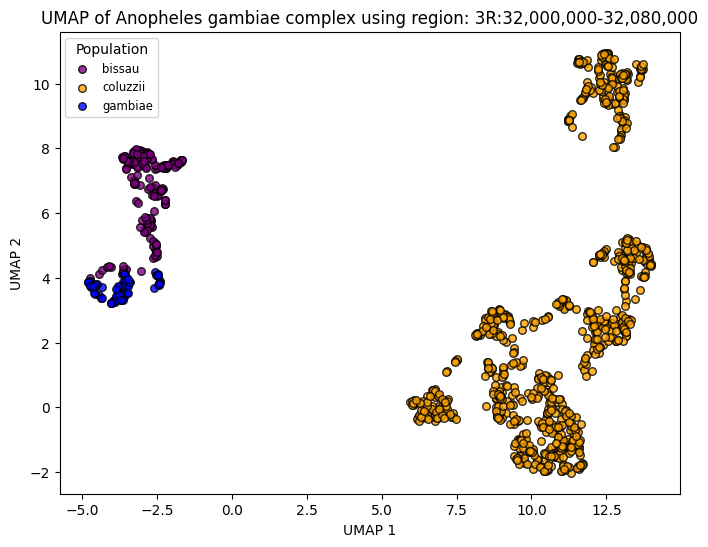

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Ensure that the population labels are extracted correctly
population_labels = pop_info['taxon'].tolist()  # Extract labels
unique_populations = np.unique(population_labels)  # Get unique taxa

# Define consistent colors for populations
population_color_map = {
    'bissau': 'purple',
    'gambiae': 'blue',
    'coluzzii': 'orange',
    'arabiensis': 'red',
    'melas': 'green'
}

# Create the figure
plt.figure(figsize=(8, 6))

# Loop through unique populations and plot separately
for pop in unique_populations:
    mask = (umap_df['population'] == pop)  # Filter for the specific population
    plt.scatter(
        umap_df.loc[mask, 'UMAP1'], umap_df.loc[mask, 'UMAP2'],
        label=pop, color=population_color_map.get(pop, 'gray'),  # Default to gray if not found
        edgecolor='k', s=30, alpha=0.8  # Edge color for better visibility
    )

# Add plot details
plt.title(f'UMAP of Anopheles gambiae complex using region: {region}')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')
plt.legend(title='Population', loc='best', fontsize='small')

# Save and show the figure
plt.savefig(f'pcoa_umap_PC1_vs_PC2_{region}.png')
plt.show()

# Save UMAP results to CSV
umap_df.to_csv(f'umap_taxon_all_region_PC1_vs_PC2.csv', sep=',', index=True)


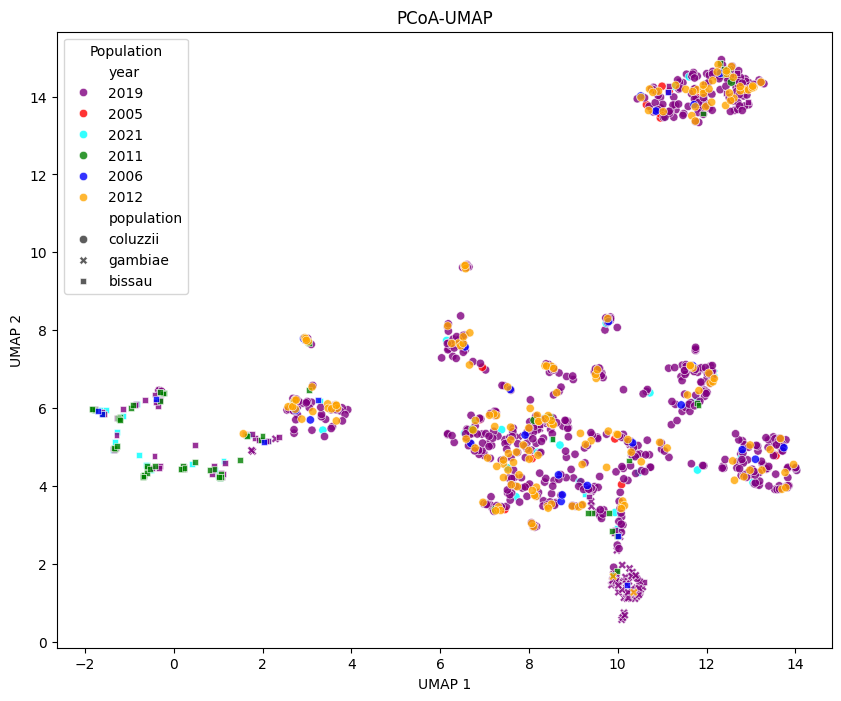

<Figure size 640x480 with 0 Axes>

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Get the PCoA results
pcoa_coords = pcoa_results.samples.iloc[:, :20]  # Select first 20 PCoA axes

# Apply UMAP on PCoA coordinates
umap_model = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=2, metric="euclidean")
umap_results = umap_model.fit_transform(pcoa_coords)  # Using the same genotype data (PCoA transformed)

# Create a DataFrame for UMAP results
umap_df = pd.DataFrame(umap_results, columns=['UMAP1', 'UMAP2'])

# Assuming you have a DataFrame `taxon_sample` that includes sample IDs, populations, and years
# Create a mapping from sample IDs to populations and years
sample_to_pop = dict(zip(taxon_sample['sample_id'], taxon_sample['taxon']))
sample_to_year = dict(zip(taxon_sample['sample_id'], taxon_sample['year']))
sample_to_cohort = dict(zip(taxon_sample['sample_id'], taxon_sample['admin1_iso']))
sample_region = dict(zip(taxon_sample['sample_id'], taxon_sample['admin1_name']))
# convert value into str
sample_to_year = {k: str(v) for k, v in sample_to_year.items()}
sample_ids = taxon_sample['sample_id'].values

# Map the populations and years to your UMAP results
umap_df['population'] = [sample_to_pop[sample_id] for sample_id in sample_ids]
umap_df['year'] = [sample_to_year[sample_id] for sample_id in sample_ids]
umap_df['cohort'] = [sample_to_cohort[sample_id] for sample_id in sample_ids]
umap_df['region'] = [sample_region[sample_id] for sample_id in sample_ids]

# Ensure population and year columns have no NaN values (to avoid issues)
umap_df = umap_df.dropna(subset=['population', 'year'])

# Define custom colors for years
year_color_map = {
    '2005': 'red',
    '2006': 'blue',
    '2011': 'green',
    '2012': 'orange',
    '2019': 'purple',
    '2020': 'black',
    '2021': 'cyan',  # Add any additional years you find
}
# cohort_color_map
cohort_color_map = {
    'GM-N': 'red',
    'GM-M': 'blue',
    'GM-L': 'green',
    'GM-U': 'orange',
    'GM-W': 'purple'
}
# region_color_map

# Map year values to colors
umap_df['color'] = umap_df['year'].map(year_color_map)

# Define markers for different taxa
taxon_marker_map = {
    'coluzzii': 'o',  # Circle
    'bissau': 's',    # Square
    'gambiae': 'D',   # Diamond
}


# 🎨 Scatter plot using explicit colors
plt.figure(figsize=(10, 8))
sns.scatterplot(x="UMAP1", y="UMAP2", hue="year", style="population",  data=umap_df, alpha=0.8, palette=year_color_map)

plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.title("PCoA-UMAP")
plt.legend(title="Population")
plt.show()
# save the fig
plt.savefig(f'pcoa_umap_PC1_vs_PC2.png')



/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



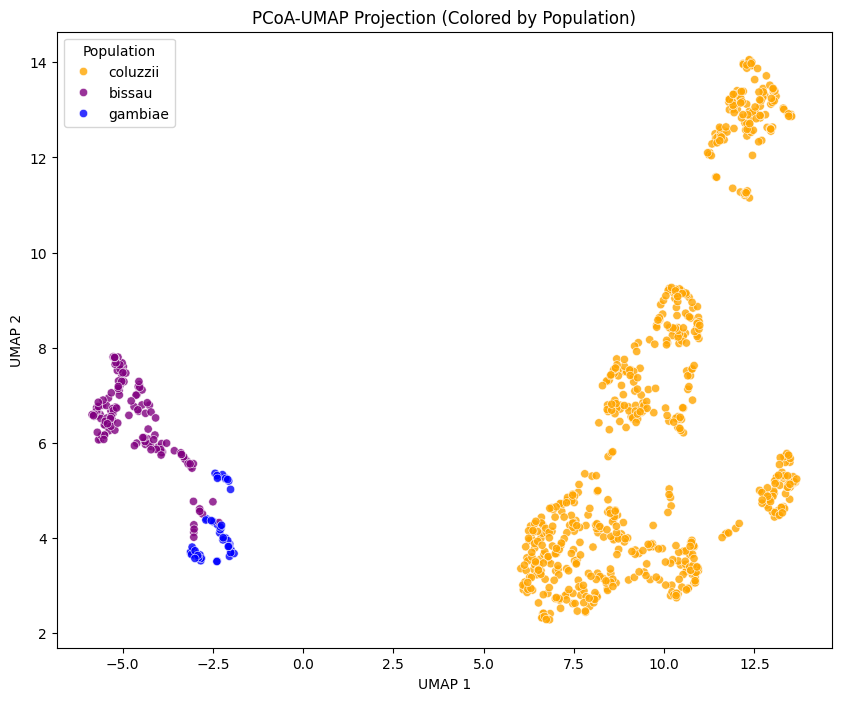

In [ ]:
#  Metric Learning to Optimize Distance Representation
from sklearn.model_selection import train_test_split
import umap.umap_ as umap
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
# Split PCoA data and taxon_sample for metric learning
X_train, X_test, taxon_sample_train, taxon_sample_test = train_test_split(pcoa_coords, taxon_sample, test_size=0.2, random_state=42)

# Train UMAP with metric learning (no labels, purely unsupervised)
umap_model = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=2, metric="euclidean")
umap_results = umap_model.fit_transform(X_train)

# Map the populations to your PCoA and UMAP results
umap_df = pd.DataFrame(umap_results, columns=['UMAP1', 'UMAP2'])

# Assuming you have a DataFrame `taxon_sample` that includes sample IDs and their populations
# Create a mapping from sample IDs to population for the train set
sample_to_pop = dict(zip(taxon_sample_train['sample_id'], taxon_sample_train['taxon']))
sample_ids = taxon_sample_train['sample_id'].values
# Map the populations to your PCoA and UMAP results
umap_df['population'] = [sample_to_pop[sample_id] for sample_id in sample_ids]  # same for umap_df

# Ensure population column has no NaN values (to avoid issues)
umap_df = umap_df.dropna(subset=['population'])

# Define custom colors for populations
pop_color_map = {
    'coluzzii': 'orange',
    'bissau': 'purple',
    'gambiae': 'blue'
}

# Map population values to colors
umap_df['color'] = umap_df['population'].map(pop_color_map)

# 🎨 Scatter plot using explicit colors
plt.figure(figsize=(10, 8))
sns.scatterplot(x="UMAP1", y="UMAP2", hue="population", palette=pop_color_map, data=umap_df, alpha=0.8)

plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.title("PCoA-UMAP Projection trained")
plt.legend(title="Population")
plt.savefig(f'pcoa_umap_PC1_vs_PC2_trained.png')
plt.show()

In [ ]:
import plotly.express as px # for data visualization
df = umap_df.copy()
# Finally, sort the dataframe by label
#--------------------------------------------------------------------------#

# Create a 2D graph
fig = px.scatter(df, x='UMAP1', y='UMAP2', color=df['population'].astype(str), height=900, width=950)

# Update chart looks
fig.update_layout(title_text='UMAP',
                  showlegend=True,
                  legend=dict(orientation="h", yanchor="top", y=0, xanchor="center", x=0.5),
                  scene_camera=dict(up=dict(x=0, y=0, z=1),
                                        center=dict(x=0, y=0, z=-0.1),
                                        eye=dict(x=1.5, y=-1.4, z=0.5)),
                                        margin=dict(l=0, r=0, b=0, t=0),
                  scene = dict(xaxis=dict(backgroundcolor='white',
                                          color='black',
                                          gridcolor='#f0f0f0',
                                          title_font=dict(size=10),
                                          tickfont=dict(size=10),
                                          ),
                                yaxis=dict(backgroundcolor='white',
                                          color='black',
                                          gridcolor='#f0f0f0',
                                          title_font=dict(size=10),
                                          tickfont=dict(size=10),
                                          ),
                                zaxis=dict(backgroundcolor='lightgrey',
                                          color='black',
                                          gridcolor='#f0f0f0',
                                          title_font=dict(size=10),
                                          tickfont=dict(size=10),
                                          )))
# Update marker size
fig.update_traces(marker=dict(size=3, line=dict(color='black', width=0.1)))

fig.show()


# FST analysis from filtered genotype

In [ ]:
def select_populations(pop, population_column):
  """
  function that select SNP in a given region
  """
  pop_samples = taxon_sample[taxon_sample[population_column] == pop]['sample_id'].tolist()
  # Get a list of all sample IDs in your data
  all_samples = taxon_sample['sample_id'].tolist()
  index_pop = [all_samples.index(i) for i in pop_samples if i in all_samples]  # Check if the sample ID exists
  return index_pop

In [ ]:
pop_label = list(taxon_sample['pop'].unique())
pop_label

pop_index = {}
for pop in pop_label:
  pop_index[pop] = select_populations(pop, 'pop')
pop_index

['GM-U_coluzzii',
 'GM-U_gambiae',
 'GM-W_bissau',
 'GM-W_coluzzii',
 'GM-W_gambiae',
 'GM-M_coluzzii',
 'GM-L_coluzzii',
 'GM-M_gambiae',
 'GM-M_bissau',
 'GM-N_bissau',
 'GM-N_coluzzii']

In [ ]:
def plot_fst(fst_df, region):
    # Convert 'fst' column to numeric
    fst_df['fst'] = pd.to_numeric(fst_df['fst'], errors='coerce')

    # Define taxa order
    order = sorted(pop_label, key=lambda x: x.split('_')[-1])

    # Pivot table and reorder rows/columns
    df = fst_df.pivot(index='population1', columns='population2', values='fst')
    df = df.reindex(index=order, columns=order)

    # Fill missing values to ensure symmetry
    df = df.fillna(df.T)

    # Generate a mask for the upper triangle
    mask = np.triu(np.ones_like(df, dtype=bool))

    # Set up the matplotlib figure
    plt.figure(figsize=(10, 10))

    # Define the colormap
    cmap = sns.color_palette("Spectral_r", n_colors=100, as_cmap=True)

    # Draw the heatmap
    sns.heatmap(
        df, mask=mask, cmap=cmap, annot=True, fmt=".3f", annot_kws={"size": 10},
        square=True, cbar_kws={"shrink": .8}, linewidths=0.5
    )

    # Adjust plot
    plt.xticks(rotation=90)
    plt.yticks(rotation=0)
    plt.title(f"FST in Anopheles gambiae complex in {region}", fontsize=12)

    # Save and show the plot
    plt.savefig(f"Fst_heatmap_{region}.png", dpi=300, bbox_inches='tight')
    plt.show()


Processing SNP data for region: ['2R:28,430,000-28,615,000', '3R:28,400,000-28,600,000', 'X:15,130,000-15,324,000', '3R:32,000,000-32,080,000']


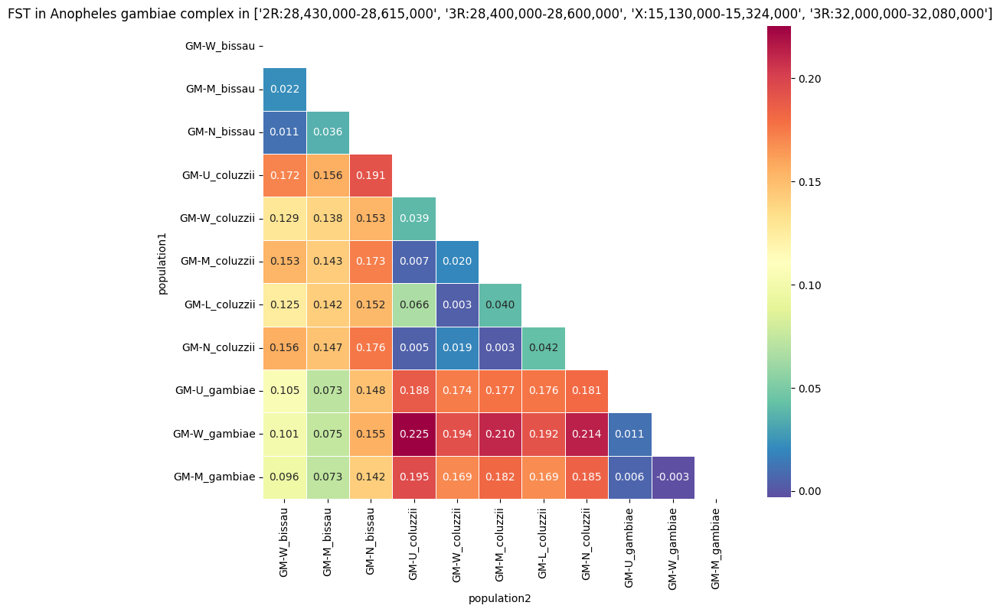

Processing SNP data for region: 2R:28,430,000-28,615,000


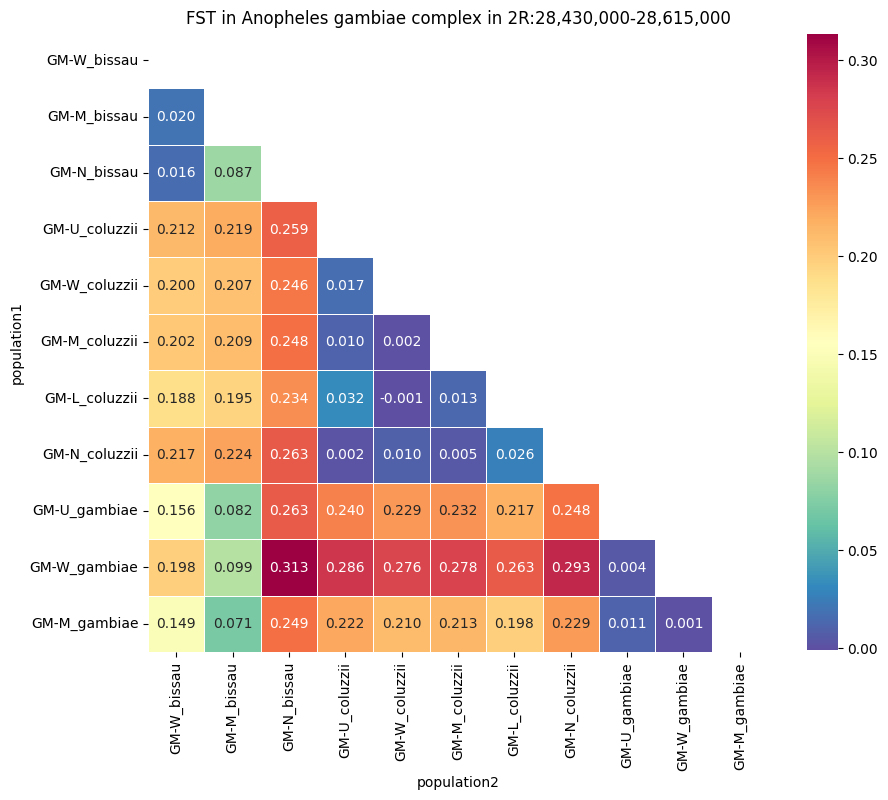

Processing SNP data for region: 3R:28,400,000-28,600,000


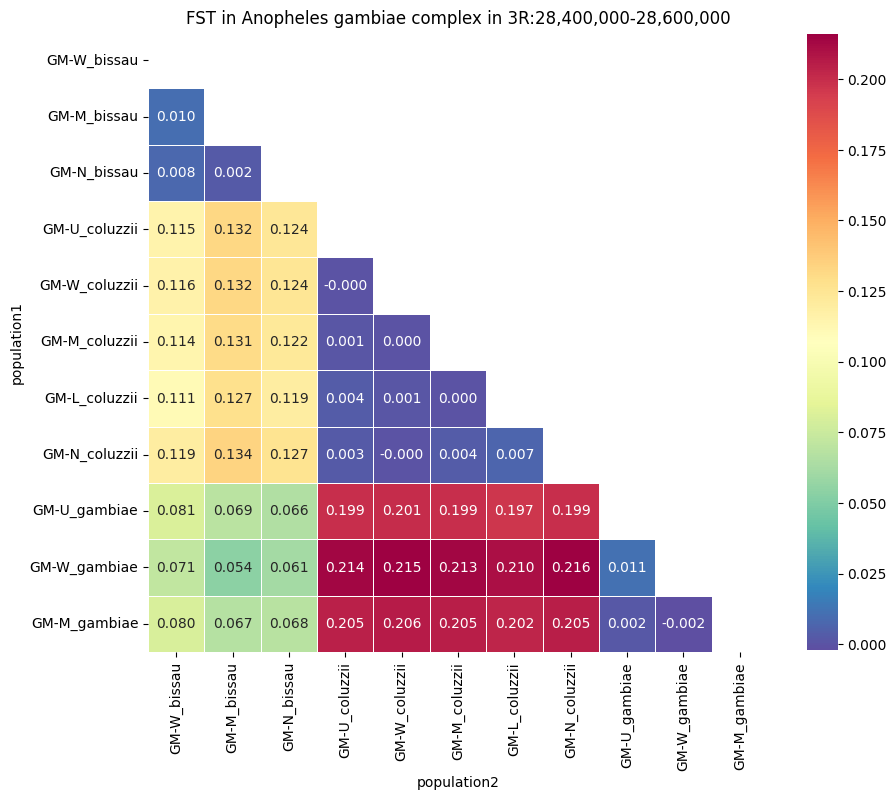

Processing SNP data for region: X:15,130,000-15,324,000


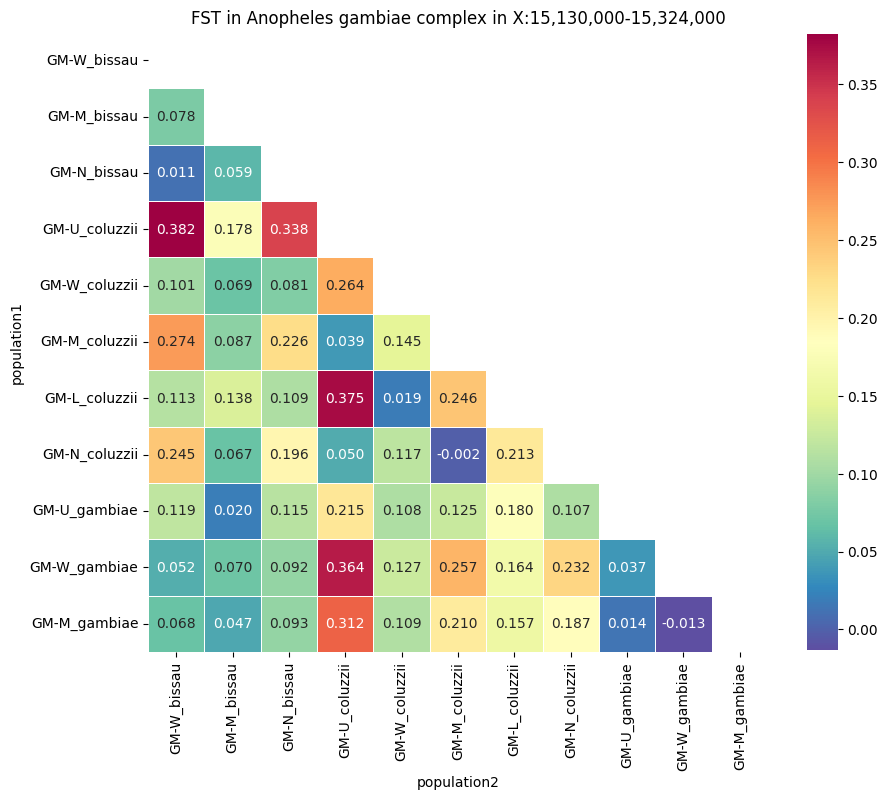

Processing SNP data for region: 3R:32,000,000-32,080,000


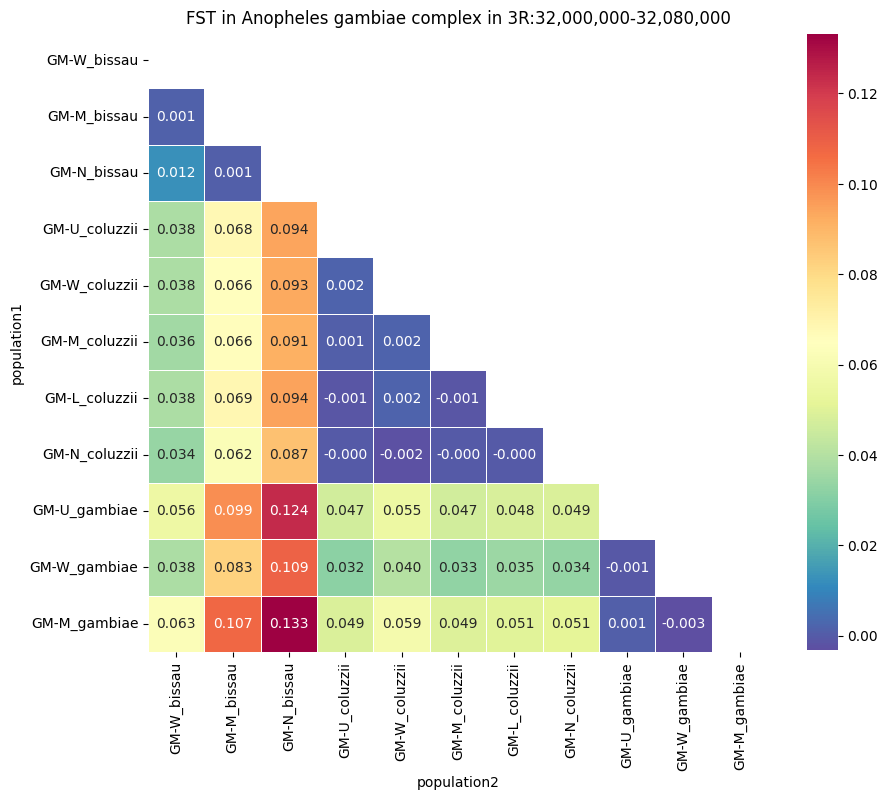

In [ ]:
import allel
import numpy as np

def fst_processing(region, sample_query, filter):
    # Step 1: Get SNP data
    genotype_data, gm_snps_selected, taxon_sample = get_snp_data(region, sample_query, filter)
    samples = list(taxon_sample["sample_id"].values)

    # Step 2: Define population indices
    # Group samples by population
    pop_label = list(taxon_sample['pop'].unique())

    pop_index = {}
    for pop in pop_label:
      pop_index[pop] = select_populations(pop, 'pop')
    pop_index

    # Select genotype data for each population
    genotype_pop = {}
    for pop, index in pop_index.items():
        genotype_pop[pop] = genotype_data[:, index]

    # Step 3: Compute allele counts
    allele_count = {}
    for pop, gt in genotype_pop.items():
        allele_count[pop] = gt.count_alleles(max_allele=3).compute()

    # Step 4: Compute block length for jackknife
    n_jack = 200  # Default value from MalariaGEN
    n_sites = allele_count[next(iter(allele_count))].shape[0]  # Get number of SNPs from first pop
    block_length = n_sites // n_jack  # Sites per block

    # Step 5: Compute average Fst
    fst_values = []
    pop_names = list(pop_index.keys())

    # Compute pairwise Fst for each population pair
    for i in range(len(pop_names)):
        for j in range(i+1, len(pop_names)):
            pop1, pop2 = pop_names[i], pop_names[j]
            ac1, ac2 = allele_count[pop1], allele_count[pop2]
            # Calculate block length for jackknife.
            n_jack = 200 # I used default value as in malariagen_data
            n_sites = ac1.shape[0]  # number of sites
            block_length = n_sites // n_jack  # number of sites in each block
            # Compute blockwise Hudson's Fst
            fst, se, _, _ = allel.blockwise_hudson_fst(ac1, ac2, blen=block_length)


            # Store result
            fst_values.append((pop1, pop2, float(fst), float(se)))
    #store in a dataframe
    fst_df = pd.DataFrame(fst_values, columns=['population1', 'population2', 'fst', 'se'])
    #return fst_df
    plot_fst(fst_df, region)

fst_processing(regions, sample_query, filter)
for region in regions:
  fst_processing(region, sample_query, filter)


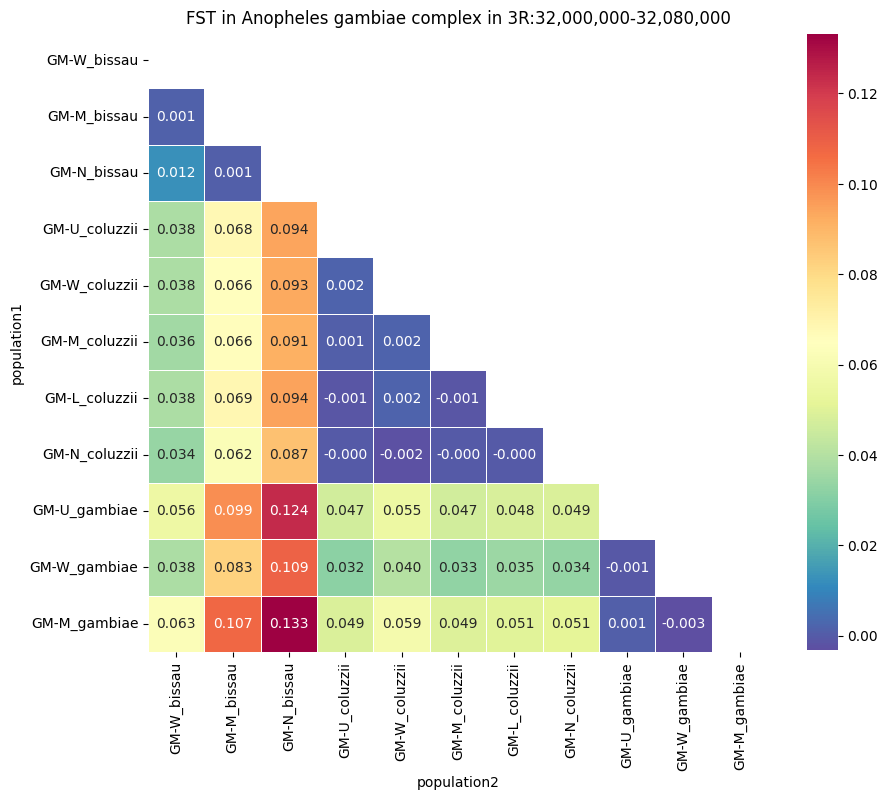

In [ ]:
fst_df =fst.copy()
# Convert 'fst' column to numeric
fst_df['fst'] = pd.to_numeric(fst_df['fst'], errors='coerce')

# Define taxa order
order = sorted(pop_label, key=lambda x: x.split('_')[-1])

# Pivot table and reorder rows/columns
df = fst_df.pivot(index='population1', columns='population2', values='fst')
df = df.reindex(index=order, columns=order)

# Fill missing values to ensure symmetry
df = df.fillna(df.T)

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(df, dtype=bool))

# Set up the matplotlib figure
plt.figure(figsize=(10, 10))

# Define the colormap
cmap = sns.color_palette("Spectral_r", n_colors=100, as_cmap=True)

# Draw the heatmap
sns.heatmap(
    df, mask=mask, cmap=cmap, annot=True, fmt=".3f", annot_kws={"size": 10},
    square=True, cbar_kws={"shrink": .8}, linewidths=0.5
)

# Adjust plot
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.title(f"FST in Anopheles gambiae complex in {region}", fontsize=12)

# Save and show the plot
plt.savefig(f"Fst_heatmap_{region}.png", dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
# Step1: get SNP data gt_filtered, gm_snps_selected, taxon_sample
regions = ["2R:28,430,000-28,615,000", "3R:28,400,000-28,600,000",  "X:15,130,000-15,324,000", "3R:32,000,000-32,080,000"]
#region = "3R:32,000,000-32,080,000"
filter="gamb_colu"
sample_query = "country=='Gambia, The' and taxon in ['coluzzii', 'bissau', 'gambiae']"
def fst_processing(region, sample_query, filter):

    genotype_data, gm_snps_selected, taxon_sample = get_snp_data(region, sample_query, filter)
    samples = list(taxon_sample["sample_id"].values)


    # Step2: construct genotype for each population by firt located sample index pop
    # Define populations index
    population_column = "taxon"
    # gambiae index
    gambiae_index = select_populations('gambiae', population_column)
    # coluzzii index
    coluzzii_index = select_populations('coluzzii', population_column)
    # bisau index
    bissau_index = select_populations('bissau', population_column)

    # Select genotype data for each population
    gambiae_gt = genotype_data[:, gambiae_index]
    coluzzii_gt = genotype_data[:, coluzzii_index]
    bissau_gt = genotype_data[:, bissau_index]

    # Step3: compute allel count for each population geno_alt.count_alleles
    gambiae_ac = gambiae_gt.count_alleles(max_allele=3).compute()
    coluzzii_ac = coluzzii_gt.count_alleles(max_allele=3).compute()
    bissau_ac = bissau_gt.count_alleles(max_allele=3).compute()
    # Step4: compute block length for jackknife.
    # Calculate block length for jackknife.
    n_jack = 200 # I used default value as in malariagen_data
    n_sites = gambiae_ac.shape[0]  # number of sites
    block_length = n_sites // n_jack  # number of sites in each block


    # Step5: compute average Fst

    # Calculate average Fst.
    fst1, se1, _, _ = allel.blockwise_hudson_fst(gambiae_ac, coluzzii_ac, blen=block_length)

    # Normalise to Python scalar types.
    fst1 = float(fst1)
    se1 = float(se1)

    fst2, se2, _, _ = allel.blockwise_hudson_fst(gambiae_ac, bissau_ac, blen=block_length)

    fst2 = float(fst2)
    se2 = float(se2)

    fst3, se3, _, _ = allel.blockwise_hudson_fst(coluzzii_ac, bissau_ac, blen=block_length)

    fst3 = float(fst3)
    se3 = float(se3)

    # store result into a dataframe
    fst_df = pd.DataFrame(columns=['fst', 'se', 'population1', 'population2'])
    fst_df.loc[0] = [fst1, se1, 'gambiae', 'coluzzii']
    fst_df.loc[1] = [fst2, se2, 'gambiae', 'bissau']
    fst_df.loc[2] = [fst3, se3, 'coluzzii', 'bissau']

    # reformating
    fst_df['population1'] = fst_df['population1'].replace({
        'gambiae': 'An. gambiae s.s',
        'coluzzii': 'An. coluzzii',
        'bissau': 'Bissau'
    })
    fst_df['population2'] = fst_df['population2'].replace({
        'gambiae': 'An. gambiae s.s',
        'coluzzii': 'An. coluzzii',
        'bissau': 'Bissau'
    })
    fst_df

    # Convert 'fst' column to numeric
    fst_df['fst'] = pd.to_numeric(fst_df['fst'], errors='coerce')

    # Define taxa order
    order = ['An. gambiae s.s', 'An. coluzzii', 'Bissau']  # Adjust according to your data

    # Pivot table and reorder rows/columns
    df = fst_df.pivot(index='population1', columns='population2', values='fst')
    df = df.reindex(index=order, columns=order)

    # Fill missing values to ensure symmetry
    df = df.fillna(df.T)

    # Generate a mask for the upper triangle
    mask = np.triu(np.ones_like(df, dtype=bool))

    # Set up the matplotlib figure
    plt.figure(figsize=(5, 5))

    # Define the colormap
    cmap = sns.color_palette("Spectral_r", n_colors=100, as_cmap=True)

    # Draw the heatmap
    sns.heatmap(
        df, mask=mask, cmap=cmap, annot=True, fmt=".3f", annot_kws={"size": 10},
        square=True, cbar_kws={"shrink": .8}, linewidths=0.5
    )

    # Adjust plot
    plt.xticks(rotation=90)
    plt.yticks(rotation=0)
    plt.title(f"FST in Anopheles gambiae complex in {region}", fontsize=12)

    # Save and show the plot
    plt.savefig(f"Fst_heatmap_{region}.png", dpi=300, bbox_inches='tight')
    plt.show()

Processing SNP data for region: 2R:28,430,000-28,615,000


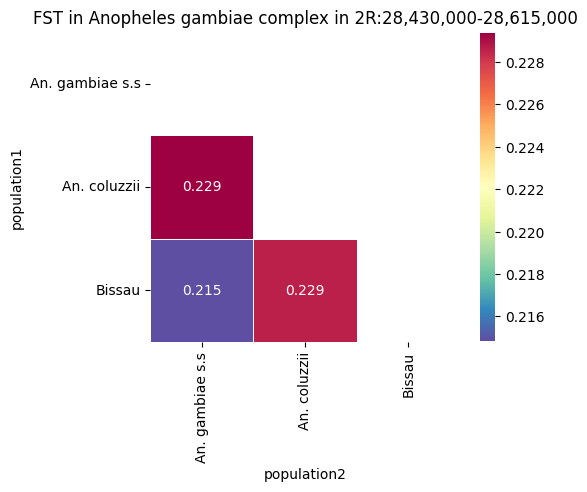

Processing SNP data for region: 3R:28,400,000-28,600,000


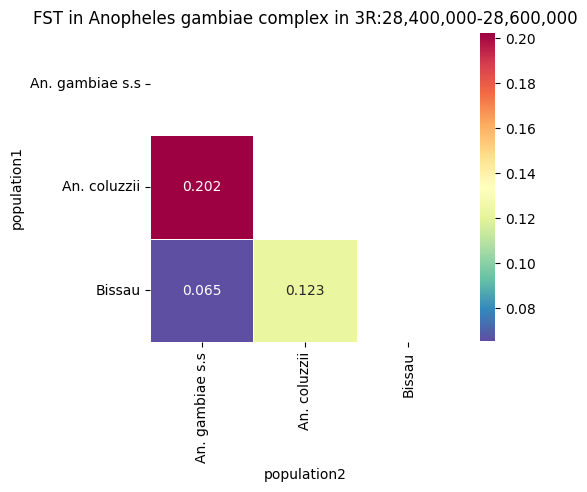

Processing SNP data for region: X:15,130,000-15,324,000


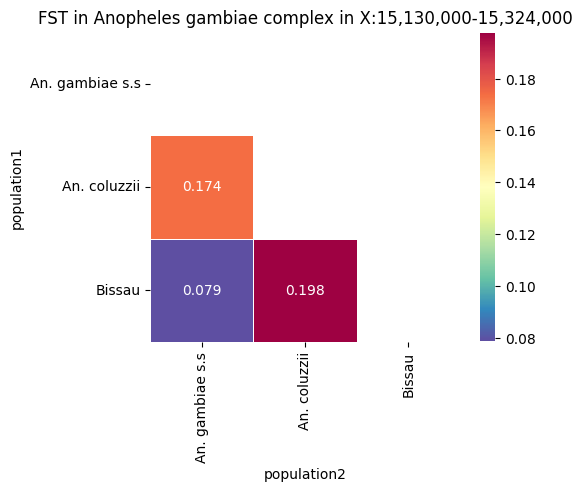

Processing SNP data for region: 3R:32,000,000-32,080,000


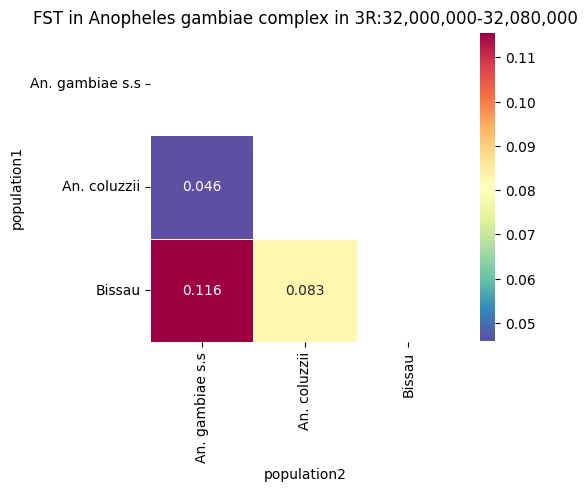

In [ ]:
for region in regions:
    fst_processing(region, sample_query, filter)

In [ ]:
#dowload fst results
#collect fils fst
# using glob to get a list of files
import glob
fst = glob.glob('/content/Fst_*.png')
#download all png files
from google.colab import files
for file in fst:
    files.download(file)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Population branching statistic (PBS) could be addded.

## Get VCF file

In [ ]:
import os
# Step1: get SNP data gt_filtered, gm_snps_selected, taxon_sample
regions = ["2R:28,430,000-28,615,000", "3R:28,400,000-28,600,000",  "X:15,130,000-15,324,000", "3R:32,000,000-32,080,000"]
#region = "3R:32,000,000-32,080,000"
filter="gamb_colu"
sample_query = "country=='Gambia, The' and taxon in ['coluzzii', 'bissau', 'gambiae']"
for region in regions:
  ag3.biallelic_snps_to_plink(output_dir=os.getcwd(),
                              region=region,
                              n_snps=10000,
                              #sample_sets='AG1000G-AO'
                              sample_query="country=='Gambia, The' and taxon in ['coluzzii', 'bissau', 'gambiae']",
                              site_mask=filter
                              )

In [ ]:
region= "3R:28,400,000-32,090,000"
filter="gamb_colu"

ag3.biallelic_snps_to_plink(output_dir=os.getcwd(),
                            region=region,
                            n_snps=32000,
                            #sample_sets='AG1000G-AO'
                            sample_query="country=='Gambia, The' and taxon in ['coluzzii', 'bissau', 'gambiae']",
                            site_mask=filter
                            )

Compute SNP allele counts:   0%|          | 0/4312 [00:00<?, ?it/s]

Computing genotype ref counts:   0%|          | 0/4564 [00:00<?, ?it/s]

'/content/3R:28,400,000-32,090,000.32000.2.0.0'

In [ ]:
!ls

3R:28,400,000-32,090,000.32000.2.0.0.bed  3R:28,400,000-32,090,000.32000.2.0.0.fam
3R:28,400,000-32,090,000.32000.2.0.0.bim  sample_data


In [ ]:
# rename files
!mkdir plink_files
!cp *.bed plink_files
!cp *.bim plink_files
!cp *.fam plink_files

!mv /content/3R:28,400,000-32,090,000.32000.2.0.0.bed  3R_28,5.bed
!mv /content/3R:28,400,000-32,090,000.32000.2.0.0.bim  3R_28,5.bim
!mv /content/3R:28,400,000-32,090,000.32000.2.0.0.fam  3R_28,5.fam



In [ ]:
# Install plink
!wget -qO- https://s3.amazonaws.com/plink1-assets/plink_linux_x86_64_20230116.zip > plink.zip
!unzip plink.zip
!chmod +x plink
!mv plink /usr/local/bin/
!plink --version

!ls | grep 'vcf'

Archive:  plink.zip
  inflating: plink                   
  inflating: LICENSE                 
  inflating: toy.ped                 
  inflating: toy.map                 
  inflating: prettify                
PLINK v1.90b7 64-bit (16 Jan 2023)


In [ ]:
!sudo apt install bcftools
!bcftools --version

!sudo apt-get install tabix

In [ ]:
!plink --bfile /content/3R_28,5 --recode vcf --out 3R_28,5
# Generate PED and MAP file
!plink --vcf 3R_28,5.vcf.gz --recode --out 3R_28,5
#!plink --bfile /content/X_15 --recode vcf --make-bed --allow-extra-chr --out  X_15

# combine vcf files
# compress all vcf file
#!bgzip 2R_28,5.vcf
!bgzip 3R_28,5.vcf
#!bgzip 3R_32.vcf
#!bgzip X_15.vcf
# merge my two vcf file into one
#!bcftools index 2R_28,5.vcf.gz
!bcftools index 3R_28,5.vcf.gz
#!bcftools index 3R_32.vcf.gz
#!bcftools index X_15.vcf.gz

#!bcftools concat 2R_28,5.vcf.gz 3R_28,5.vcf.gz  3R_32.vcf.gz X_15.vcf.gz -O z -o sweep_region.vcf.gz
!bcftools index 3R_28,5.vcf.gz
# Check the number of variant
#!bcftools view -c1 2R_28,5.vcf.gz | grep -v -c '^#' # 11583
!bcftools view -c1 3R_28,5.vcf.gz | grep -v -c '^#' # 13865
#!bcftools view -c1 3R_32.vcf.gz | grep -v -c '^#' # 12423
#!bcftools view -c1 X_15.vcf.gz | grep -v -c '^#' # 12920
#!bcftools view -c1 sweep_region.vcf.gz | grep -v -c '^#' # 50791
# Check the number of samples
#!bcftools query -l sweep_region.vcf.gz | wc -l # 1135
# Check chr in the concat vcf
!bcftools query -f '%CHROM\n' 3R_28,5.vcf.gz | sort | uniq # 0:2R, 2:3R, 4:X
!zcat 3R_28,5.vcf.gz | head -n 20
!cat 3R_28,5.map | tail -n 20


##fileformat=VCFv4.2
##fileDate=20250403
##source=PLINKv1.90
##contig=<ID=2,length=32089415>
##INFO=<ID=PR,Number=0,Type=Flag,Description="Provisional reference allele, may not be based on real reference genome">
##FORMAT=<ID=GT,Number=1,Type=String,Description="Genotype">
#CHROM	POS	ID	REF	ALT	QUAL	FILTER	INFO	FORMAT	0_VBS68485-6411STDY13142504	0_VBS68486-6411STDY13142505	0_VBS68498-6411STDY13142517	0_VBS68505-6411STDY13142524	0_VBS68506-6411STDY13142525	0_VBS68514-6411STDY13142533	0_VBS68516-6411STDY13142535	0_VBS68517-6411STDY13142536	0_VBS68528-6411STDY13142547	0_VBS68549-6411STDY13142568	0_VBS68586-6411STDY13142607	0_VBS68617-6411STDY13142638	0_VBS68623-6411STDY13142644	0_VBS68629-6411STDY13142650	0_VBS68655-6411STDY13142676	0_VBS68659-6411STDY13142680	0_VBS68660-6411STDY13142681	0_VBS68661-6411STDY13142682	0_VBS68664-6411STDY13142685	0_VBS68673-6411STDY13142696	0_VBS68676-6411STDY13142699	0_VBS68677-6411STDY13142700	0_VBS68680-6411STDY13142703	0_VBS68682-6411STDY13142705	0_VBS686

In [ ]:
# Alternatif faster way
!plink --bfile /content/3R_28,5 --make-bed --out sweep_region_clean
!plink --bfile sweep_region_clean --recode vcf --out sweep_region_clean
!cat sweep_region_clean.vcf | head -n 20

##fileformat=VCFv4.2
##fileDate=20250403
##source=PLINKv1.90
##contig=<ID=2,length=32089415>
##INFO=<ID=PR,Number=0,Type=Flag,Description="Provisional reference allele, may not be based on real reference genome">
##FORMAT=<ID=GT,Number=1,Type=String,Description="Genotype">
#CHROM	POS	ID	REF	ALT	QUAL	FILTER	INFO	FORMAT	0_VBS68485-6411STDY13142504	0_VBS68486-6411STDY13142505	0_VBS68498-6411STDY13142517	0_VBS68505-6411STDY13142524	0_VBS68506-6411STDY13142525	0_VBS68514-6411STDY13142533	0_VBS68516-6411STDY13142535	0_VBS68517-6411STDY13142536	0_VBS68528-6411STDY13142547	0_VBS68549-6411STDY13142568	0_VBS68586-6411STDY13142607	0_VBS68617-6411STDY13142638	0_VBS68623-6411STDY13142644	0_VBS68629-6411STDY13142650	0_VBS68655-6411STDY13142676	0_VBS68659-6411STDY13142680	0_VBS68660-6411STDY13142681	0_VBS68661-6411STDY13142682	0_VBS68664-6411STDY13142685	0_VBS68673-6411STDY13142696	0_VBS68676-6411STDY13142699	0_VBS68677-6411STDY13142700	0_VBS68680-6411STDY13142703	0_VBS68682-6411STDY13142705	0_VBS686

In [ ]:
!bgzip sweep_region_clean.vcf
!bgzip phased_data.vcf.gz
#unzip
!gunzip phased_data.vcf.gz.gz

In [ ]:
# download files
from google.colab import files
files.download('sweep_region_clean.vcf.gz')
files.download('3R_28,5.bed')
files.download('3R_28,5.bim')
files.download('3R_28,5.fam')
files.download('3R_28,5.vcf.gz')
files.download('phased_data.vcf.gz')
files.download('phased_data.ibd.gz')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

##IBD analysis

In [ ]:
# Pseudocode / example for generating a genetic map from positions list
import math

# Define recombination rate in cM per bp for each chromosome (here uniform 1 cM/Mb = 1e-6 cM/bp)
rate_cM_per_bp = {
    "2L": 1e-6,
    "2R": 1e-6,
    "3L": 1e-6,
    "3R": 1e-6,
    "X":  1e-6
}

# Suppose we have a list of (chr, pos) tuples sorted by chr and pos:
sites = [("2L", 1000), ("2L", 500000), ("2L", 1000000),
         ("2R", 1000), ("2R", 1000000)]
last_pos = None
last_chr = None

for chr, pos in sites:
    if chr != last_chr:
        # New chromosome: reset genetic distance
        cum_cM = 0.0
        last_pos = pos
        print(f"{chr}\t{pos}\t{cum_cM:.6f}")
    else:
        # Same chromosome: increment distance
        dist_bp = pos - last_pos
        cum_cM += dist_bp * rate_cM_per_bp[chr]
        last_pos = pos
        print(f"{chr}\t{pos}\t{cum_cM:.6f}")
    last_chr = chr


2L	1000	0.000000
2L	500000	0.499000
2L	1000000	0.999000
2R	1000	0.000000
2R	1000000	0.999000


In [ ]:
!wget https://faculty.washington.edu/browning/refined-ibd/refined-ibd.17Jan20.102.jar
!wget https://faculty.washington.edu/browning/beagle/beagle.28Jun21.220.jar
!mv beagle.28Jun21.220.jar beagle.jar

--2025-04-03 20:27:02--  https://faculty.washington.edu/browning/refined-ibd/refined-ibd.17Jan20.102.jar
Resolving faculty.washington.edu (faculty.washington.edu)... 128.208.60.35, 128.208.61.21
Connecting to faculty.washington.edu (faculty.washington.edu)|128.208.60.35|:443... connected.
HTTP request sent, awaiting response... 200 
Length: 191398 (187K)
Saving to: ‘refined-ibd.17Jan20.102.jar’

refined-ibd.17Jan20 100%[===================>] 186.91K  --.-KB/s    in 0.1s    

2025-04-03 20:27:02 (1.29 MB/s) - ‘refined-ibd.17Jan20.102.jar’ saved [191398/191398]

--2025-04-03 20:27:03--  https://faculty.washington.edu/browning/beagle/beagle.28Jun21.220.jar
Resolving faculty.washington.edu (faculty.washington.edu)... 128.208.60.35, 128.208.61.21
Connecting to faculty.washington.edu (faculty.washington.edu)|128.208.60.35|:443... connected.
HTTP request sent, awaiting response... 200 
Length: 301360 (294K)
Saving to: ‘beagle.28Jun21.220.jar’

beagle.28Jun21.220. 100%[===================>] 29

In [ ]:
!java -jar beagle.jar gt=3R_28,5.vcf.gz out=phased_data

beagle.28Jun21.220.jar (version 5.2)
Copyright (C) 2014-2021 Brian L. Browning
Enter "java -jar beagle.28Jun21.220.jar" to list command line argument
Start time: 04:09 PM UTC on 03 Apr 2025

Command line: java -Xmx3246m -jar beagle.28Jun21.220.jar
  gt=3R_28,5.vcf.gz
  out=phased_data

No genetic map is specified: using 1 cM = 1 Mb

Reference samples:                    0
Study     samples:                1,135

Window 1 [2:28400001-32089414]
Reference markers:               34,148
Study     markers:               34,148

Burnin  iteration 1:           1 minute 4 seconds
Burnin  iteration 2:           40 seconds
Burnin  iteration 3:           38 seconds

Estimated ne:                  5334403

Phasing iteration 1:           34 seconds
Phasing iteration 2:           32 seconds
Phasing iteration 3:           31 seconds
Phasing iteration 4:           29 seconds
Phasing iteration 5:           30 seconds
Phasing iteration 6:           30 seconds
Phasing iteration 7:           29 seconds
Pha

In [ ]:
!zcat phased_data.vcf.gz | head -n 20
files.download('phased_data.vcf.gz')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
!sudo apt install bcftools
!bcftools query -l phased_data.vcf.gz | wc -l

In [ ]:
# Convert scientific notation in PLINK .map file to integer format
input_file = "anopheles_genetic_map.map"
output_file = "anopheles_genetic_map_fixed.map"

with open(input_file, "r") as infile, open(output_file, "w") as outfile:
    for line in infile:
        tokens = line.strip().split()
        if len(tokens) == 4:
            try:
                tokens[3] = str(int(float(tokens[3])))
            except ValueError:
                print("Could not convert:", tokens[3])
        outfile.write("\t".join(tokens) + "\n")

print(f"Fixed .map file written to {output_file}")


Fixed .map file written to anopheles_genetic_map_fixed.map


In [ ]:
!java -jar refined-ibd.17Jan20.102.jar gt=phased_data.vcf.gz  window=15 length=0.125 out=phased_data

refined-ibd.17Jan20.102.jar
Copyright (C) 2014-2017 Brian L. Browning
Enter java -jar refined-ibd.17Jan20.102.jar to list command line argument
Start time: 08:27 PM UTC on 03 Apr 2025

Command line: java -Xmx3246m -jar refined-ibd.17Jan20.102.jar
  gt=phased_data.vcf.gz
  window=15
  length=0.125
  out=phased_data

No genetic map is specified: using 1 cM = 1 Mb

Samples:                 1,135      
Model scale:             3.37       

Window 1 (2:28400001-32089414)
Markers:                 34,148     
Model construction:      19 seconds
IBD detection:           58 seconds
Total time:              1 minute 17 seconds

mean edges/level: 5      max edges/level: 22
mean edges/node:  1.371  mean count/edge: 454

Cumulative Statistics:

Markers:                 34,148     
Model construction:      19 seconds
IBD detection:           58 seconds
Total time:              1 minute 20 seconds

End time: 08:29 PM UTC on 03 Apr 2025
refined-ibd.17Jan20.102.jar finished


Set the  parameter lenght to 0.125

In [ ]:
!zcat phased_data.ibd.gz | head -n 20
!zcat phased_data.hbd.gz

0_VBS77812-7065STDY13143452	1	0_VBS79017-7065STDY13144694	1	2	28484666	28809902	4.06	0.325
0_VBS78023-7065STDY13143670	1	0_AG0064-C	1	2	28437930	28756347	6.89	0.318
0_VBS79062-7065STDY13144741	1	0_AG0139-C	1	2	30077389	30439135	17.62	0.362
0_VBS78057-7065STDY13143706	1	0_VBS78266-7065STDY13143921	1	2	28537640	29000492	3.35	0.463
0_VBS79062-7065STDY13144741	1	0_AG0085-C	1	2	29996197	30439135	20.5	0.443
0_VBS79064-7065STDY13144743	1	0_AG0098-C	1	2	29061312	29433545	3.96	0.372
0_VBS70332-7065STDY13152857	2	0_AG0446-CW	2	2	31618313	32076107	10.74	0.458
0_VBS69781-7065STDY13152216	1	0_AG0197-C	1	2	28403353	29302611	108.17	0.899
0_VBS78057-7065STDY13143706	1	0_VBS78293-7065STDY13143949	1	2	28524746	29161282	9.7	0.637
0_VBS79062-7065STDY13144741	1	0_AG0214-C	1	2	30853704	31185061	5.53	0.331
0_VBS48181-6366STDY9854780	2	0_AG0290-C	1	2	31049137	31526288	13.72	0.477
0_VBS78847-7065STDY13144518	1	0_AG0343-C	2	2	31635858	32089414	8.57	0.454
0_VBS79064-7065STDY13144743	2	0_AG0229-C	1	2	28484666	289

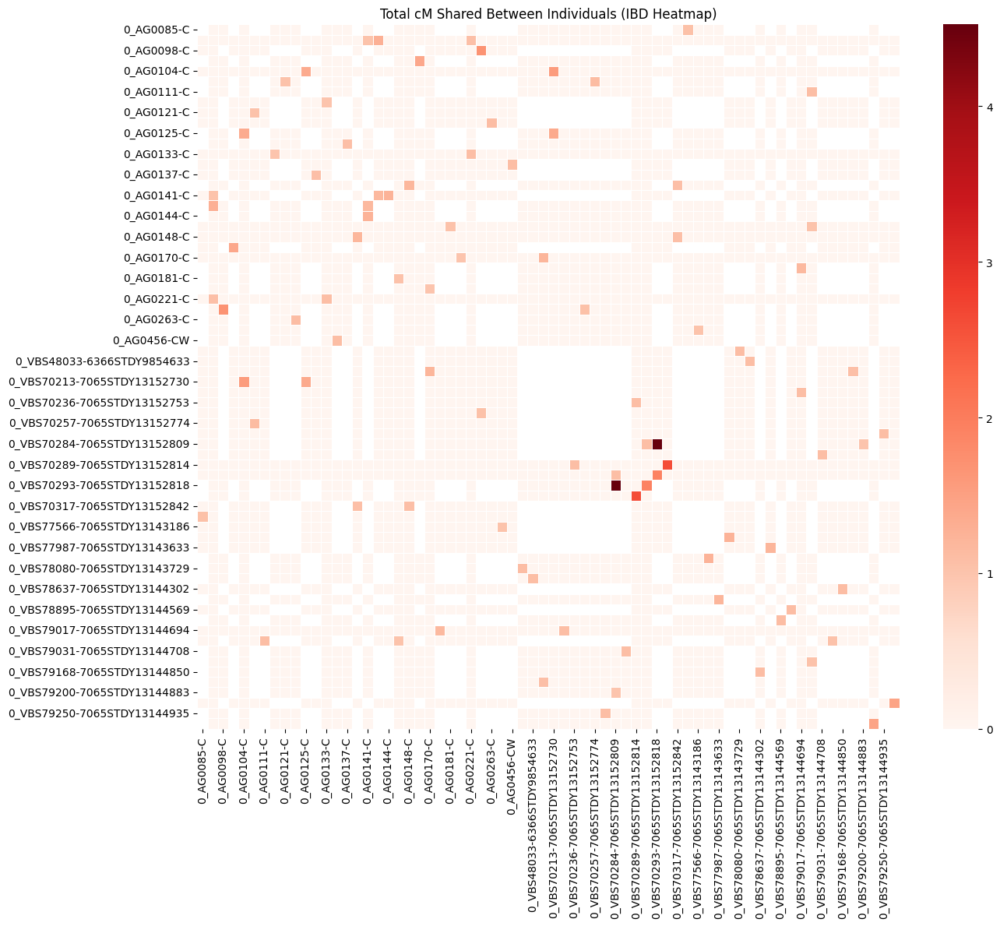

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the uploaded IBD file
file_path = "phased_data.ibd.gz"
columns = ['ID1', 'HAP1', 'ID2', 'HAP2', 'CHR', 'START', 'END', 'LOD', 'CM_LEN']
ibd_df = pd.read_csv(file_path, sep='\t', header=None, names=columns, compression='gzip')

# Filter: segments with strong evidence and longer than 1 cM
ibd_df = ibd_df[(df['CM_LEN'] > 1) & (ibd_df['LOD'] > 3)]

"""# Plot 1: Histogram of IBD segment midpoints
ibd_df['MIDPOINT'] = (ibd_df['START'] + ibd_df['END']) / 2
plt.figure(figsize=(12, 6))
sns.histplot(df['MIDPOINT'], bins=100)
plt.title("Density of IBD Segment Midpoints Across Genome")
plt.xlabel("Genomic Position (bp)")
plt.ylabel("Number of Segments")
plt.grid(True)
plt.tight_layout()"""

# Plot 2: Heatmap of total shared cM
cm_matrix = ibd_df.groupby(['ID1', 'ID2'])['CM_LEN'].sum().unstack(fill_value=0)
if not cm_matrix.empty:
    cm_matrix = cm_matrix.add(cm_matrix.T, fill_value=0)  # Symmetrize matrix
    plt.figure(figsize=(14, 12))
    sns.heatmap(cm_matrix, cmap='Reds', linewidths=0.5)
    plt.title("Total cM Shared Between Individuals (IBD Heatmap)")
    plt.tight_layout()


In [ ]:
# High-confidence, long IBD segments only:
ibd_confident = ibd_df[(ibd_df["lod"] >= 5) & (ibd_df["length_cM"] >= 3)]

# For exploratory or permissive analysis:
ibd_loose = ibd_df[(ibd_df["lod"] >= 3) & (ibd_df["length_cM"] >= 1)]


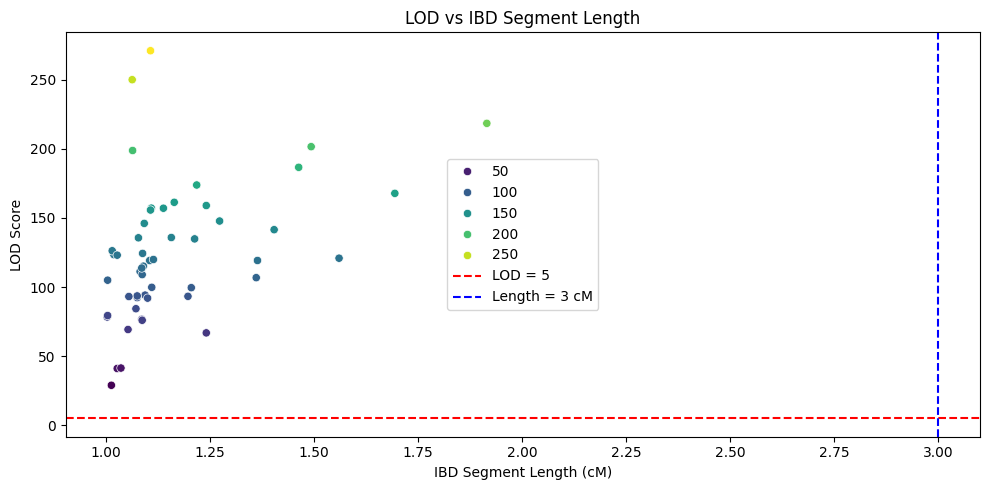

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming you have ibd_df with `lod` and `length_cM`
plt.figure(figsize=(10, 5))
sns.scatterplot(data=ibd_df, x="CM_LEN", y="LOD", hue="LOD", palette="viridis")
plt.axhline(5, color="red", linestyle="--", label="LOD = 5")
plt.axvline(3, color="blue", linestyle="--", label="Length = 3 cM")
plt.xlabel("IBD Segment Length (cM)")
plt.ylabel("LOD Score")
plt.title("LOD vs IBD Segment Length")
plt.legend()
plt.tight_layout()
plt.show()


<ipython-input-13-11e62aa984ae>:22: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


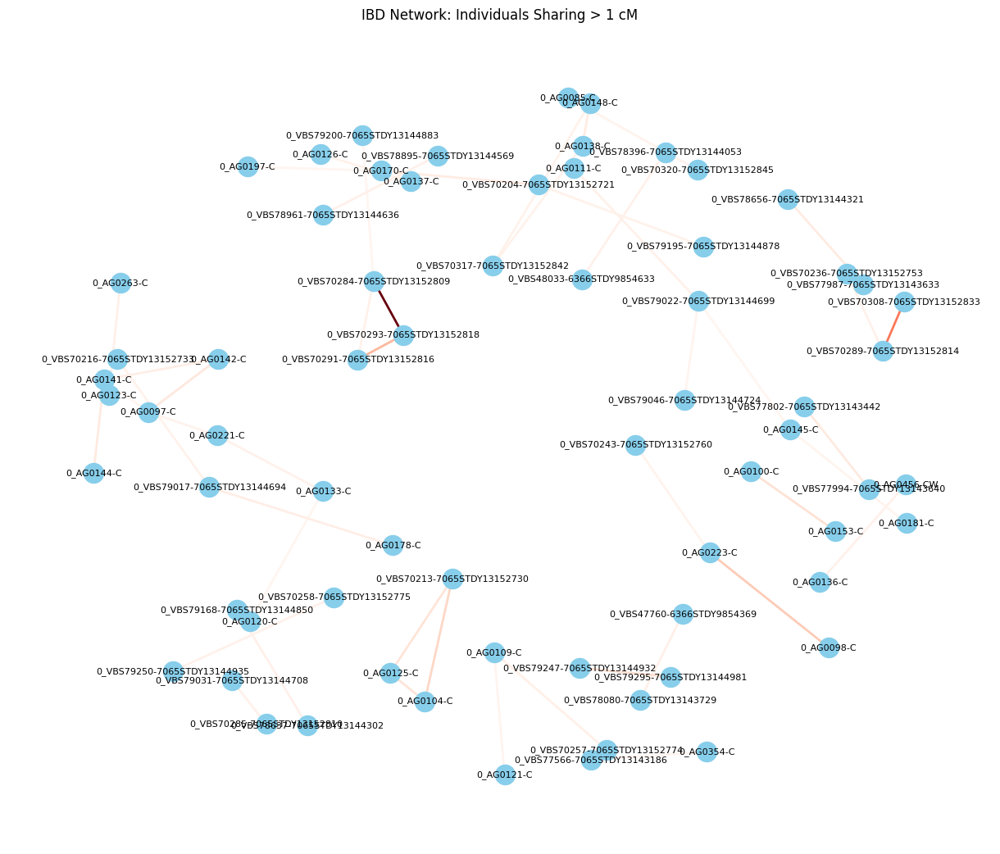

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt

# Build a graph of related individuals (edges weighted by cM shared)
G = nx.Graph()
threshold = 1  # Only connect pairs with > 1 cM shared

for i, row in cm_matrix.iterrows():
    for j, val in row.items():
        if i != j and val > threshold:
            G.add_edge(i, j, weight=val)

# Draw the network
plt.figure(figsize=(12, 10))
pos = nx.spring_layout(G, k=0.5, iterations=50, seed=42)
edges = G.edges(data=True)
weights = [d['weight'] for (u, v, d) in edges]

nx.draw(G, pos, with_labels=True, node_color='skyblue', edge_color=weights,
        edge_cmap=plt.cm.Reds, width=2, font_size=8)
plt.title("IBD Network: Individuals Sharing > 1 cM")
plt.tight_layout()
plt.show()


In [ ]:
!plink --bfile 3R_28,5 --genome --out ibd_results
!cat ibd_results.genome | head -n 20

# save file
n=0
for line in open('ibd_results.genome', 'r'):
    print(line.strip())
    data =line.strip()
    data =data.split("\t")
    n+=1
    if n==2:
      print(data)
      break




FID1                       IID1 FID2                       IID2 RT    EZ      Z0      Z1      Z2  PI_HAT PHE       DST     PPC   RATIO
0  VBS68485-6411STDY13142504   0  VBS68486-6411STDY13142505 OT     0  0.8679  0.1282  0.0040  0.0680  -1  0.969940  0.8944  7.0000
['0  VBS68485-6411STDY13142504   0  VBS68486-6411STDY13142505 OT     0  0.8679  0.1282  0.0040  0.0680  -1  0.969940  0.8944  7.0000']


In [ ]:
!pip install asmc-preparedecoding

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 986.7/986.7 kB 17.2 MB/s eta 0:00:00


In [ ]:
!head /content/mosquito.frq

 CHR        SNP   A1   A2          MAF  NCHROBS
   2       sid1    G    C     0.001762     2270
   2       sid2    A    G     0.002203     2270
   2       sid3    G    T     0.002203     2270
   2       sid4    T    A      0.05154     2270
   2       sid5    C    T       0.0326     2270
   2       sid6    T    G     0.001322     2270
   2       sid7    C    G    0.0008811     2270
   2       sid8    A    T     0.005286     2270
   2       sid9    T    C     0.001322     2270


In [ ]:
from asmc.preparedecoding import *
demo_file="mosquito.demo"
disc_file="times.disc"
freq_file="mosquito_150.freq"
dq = prepare_decoding(
    demography=demo_file,
    discretization=disc_file,
    frequencies=freq_file,
    samples=300, # Use a larger number (300 is suggested) for real analysis
)

## LD analysis

In [ ]:
# load and filter data  from selected region
region = "3R:28,400,000-32,090,000"  # Replace with your region of interest
sample_query = "country=='Gambia, The' and taxon in ['bissau']"
taxon_sample = ag3.sample_metadata(sample_query=sample_query)

# Load SNP call data
ds = ag3.biallelic_snp_calls(
    region=region,
    # Instead of using 'sample_id in my_population' directly,
    # pass the flattened list of sample IDs to the sample_query argument
    sample_query=sample_query,
    site_mask="gamb_colu",
    n_snps = 32000)

samples_id = ds['sample_id'].values
# Sample metadata
samples_df = ag3.sample_metadata(sample_query=sample_query)
sample_ids = ds.samples.data

Compute SNP allele counts:   0%|          | 0/1652 [00:00<?, ?it/s]

In [ ]:
# Prepare genotype and allel count
# Convert to GenotypeArray
gt = allel.GenotypeArray(ds["call_genotype"], dtype='i1')

# Minor allele frequency filtering
ac = gt.count_alleles()
maf = ac.to_frequencies()[:, 1]
mask_maf = maf > 0.05
gt_filt = gt.compress(mask_maf, axis=0)
positions = ds['variant_position'].data[mask_maf]
gn_filt = gt_filt.to_n_alt()
gn_filt.shape


(7003, 175)

In [ ]:
def plot_ld(gn, title):
    """
    Compute LD between SNP and plot pairwise LD.
    """
    m = allel.rogers_huff_r(gn) ** 2
    ax = allel.plot_pairwise_ld(m)
    ax.set_title(title)
    return m, ax

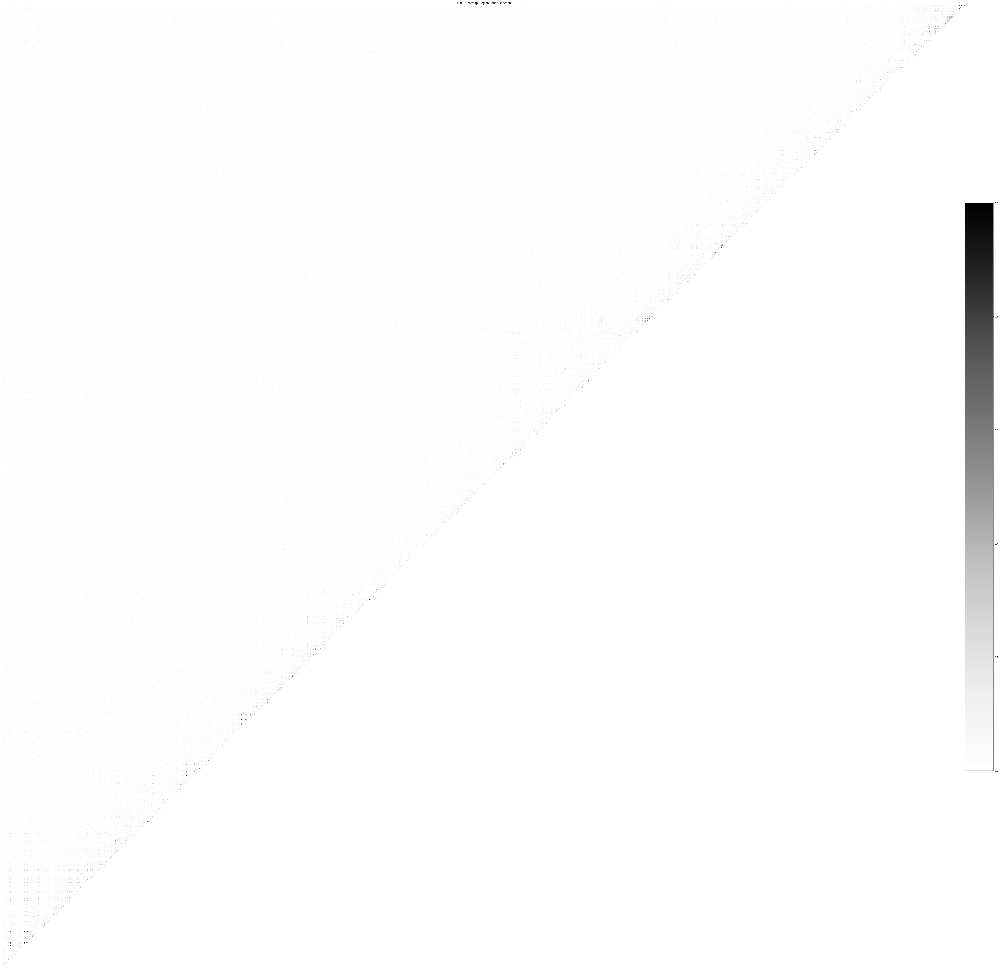

In [ ]:
r2, ax = plot_ld(gn_filt, "LD (r²) Heatmap: Region under Selection")

LD calculations may have been performed on a subset of SNPs.
Using estimated number of SNPs for LD: 4951


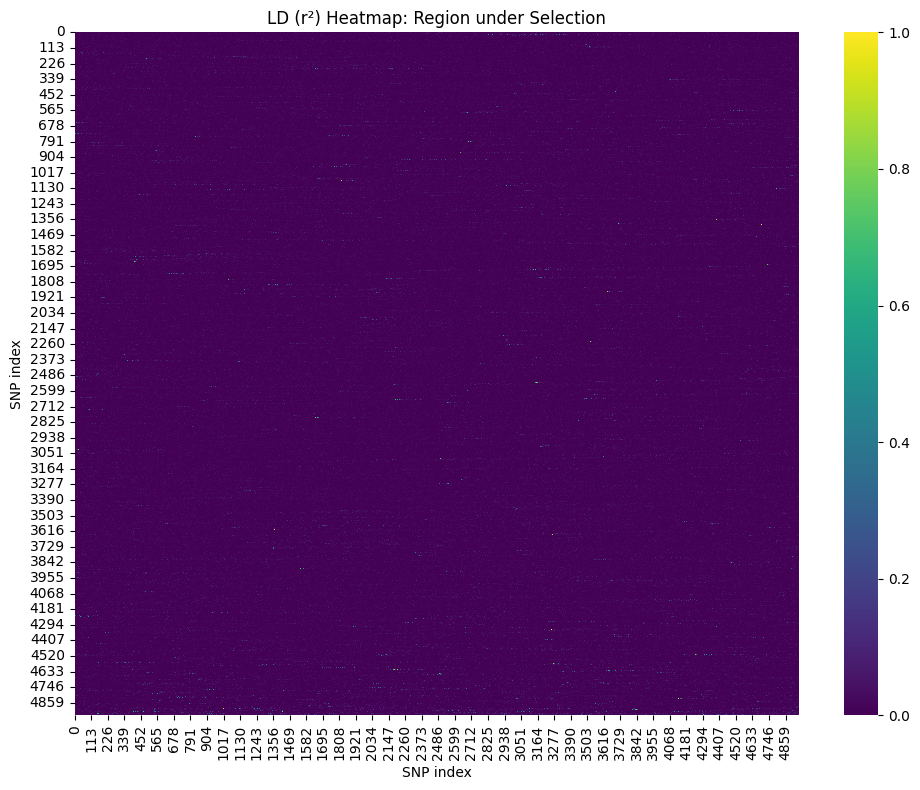

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Get the original dimensions using gn_filt.shape
num_snps = gn_filt.shape[0]

# Check if the size of r2 is compatible with the desired shape
expected_size = num_snps * num_snps
if r2.size < expected_size:
    print(f"Warning: r2 array size ({r2.size}) is smaller than expected ({expected_size}).")
    print("LD calculations may have been performed on a subset of SNPs.")
    num_snps_ld = int(np.sqrt(r2.size))  # Estimate the number of SNPs used in LD calculation
    print(f"Using estimated number of SNPs for LD: {num_snps_ld}")
else:
    num_snps_ld = num_snps

# Reshape r2 to its original form based on the estimated size
r2_reshaped = r2[:num_snps_ld * num_snps_ld].reshape(num_snps_ld, num_snps_ld)

plt.figure(figsize=(10, 8))
sns.heatmap(r2_reshaped, cmap='viridis') # Use the reshaped r2
plt.title("LD (r²) Heatmap: Region under Selection")
plt.xlabel("SNP index")
plt.ylabel("SNP index")
plt.tight_layout()
plt.show()

In [ ]:
from scipy.spatial.distance import squareform

ld_rhr = squareform(r2)  # Convert to square matrix
np.fill_diagonal(ld_rhr, np.nan)  # Fill diagonal with NaN

# Remove rows and columns with all NaN values

# Create a mask for the upper triangle
mask = np.triu(np.ones_like(ld_rhr, dtype=bool))

# Create the heatmap
fig = plt.figure(figsize=(9, 6))
ax = sns.heatmap(
    ld_rhr,
    mask=mask,  # Apply the mask
    vmin=-1, vmax=1,
    cmap="coolwarm",  # Blue-to-red colormap for scientific convention
    #xticklabels=snp_name, yticklabels=snp_name,
    linewidths=0.8, linecolor="white", annot=True, fmt=".2f",  # Annotate cells
)

# Customize the heatmap title and labels
ax.set_title(f"Linkage Disequilibrium (Rogers & Huff)", fontsize=14, pad=15)
plt.xticks(rotation=90)  # Rotate x-axis labels
plt.yticks(rotation=0)  # Rotate y-axis labels


In [ ]:
taxon_sample = ag3.sample_metadata(sample_query=sample_query)
def select_populations(pop, population_column):
  """
  function that select SNP in a given region
  """
  pop_samples = taxon_sample[taxon_sample[population_column] == pop]['sample_id'].tolist()
  # Get a list of all sample IDs in your data
  all_samples = taxon_sample['sample_id'].tolist()
  index_pop = [all_samples.index(i) for i in pop_samples if i in all_samples]  # Check if the sample ID exists
  return index_pop

In [ ]:
# Create boolean masks for each population
pop_A_mask = samples_df["taxon"] == "gambiae"
pop_B_mask = samples_df["taxon"] == "bissau"


gn_A = gn_filt[:, pop_A_mask.values]
gn_B = gn_filt[:, pop_B_mask.values]


gn_A.shape, gn_B.shape, gn_C.shape

((4998, 76), (4998, 175), (2349, 884))

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 6))
sns.lineplot(data=ld_all, x="window_center", y="mean_r2", hue="pop", marker="o")

plt.xlabel("Genomic position (bp)")
plt.ylabel("Mean r² (LD)")
plt.title("LD Decay Comparison Between Populations")
plt.legend(title="Population")
plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Load the PLINK LD file
ld_df = pd.read_csv("LD.ld", delim_whitespace=True)

# Filter only SNP pairs with r² ≥ 0.5
ld_df_filtered = ld_df[ld_df["R2"] >= 0.5].copy()

# Get unique SNPs involved in high-LD pairs
snps = pd.unique(ld_df_filtered[['SNP_A', 'SNP_B']].values.ravel())
snps = sorted(snps)  # Optional: sort SNPs alphabetically or by position
snp_index = {snp: i for i, snp in enumerate(snps)}

# Initialize LD matrix
ld_matrix = np.full((len(snps), len(snps)), np.nan)

# Fill the LD matrix
for _, row in ld_df_filtered.iterrows():
    i = snp_index[row["SNP_A"]]
    j = snp_index[row["SNP_B"]]
    ld_matrix[i, j] = row["R2"]
    ld_matrix[j, i] = row["R2"]

# Set diagonal to 1.0 (LD of SNP with itself)
np.fill_diagonal(ld_matrix, 1.0)
plt.figure(figsize=(12, 10))
sns.heatmap(ld_matrix, xticklabels=snps, yticklabels=snps, cmap="viridis", square=True)

# Optional cleanup for readability
plt.xticks(rotation=90, fontsize=6)
plt.yticks(rotation=0, fontsize=6)

plt.title("LD Heatmap (r² ≥ 0.5)")
plt.xlabel("SNPs")
plt.ylabel("SNPs")
plt.tight_layout()
plt.savefig("LD_heatmap_r2_0.5.png", dpi=300)
plt.show()


In [ ]:
sns.load_dataset("glue")

,Model,Year,Encoder,Task,Score
0,ERNIE,2019,Transformer,CoLA,75.5
1,T5,2019,Transformer,CoLA,71.6
2,RoBERTa,2019,Transformer,CoLA,67.8
3,BERT,2018,Transformer,CoLA,60.5
4,BiLSTM+ELMo,2018,LSTM,CoLA,32.1
...,...,...,...,...,...
59,BERT,2018,Transformer,RTE,70.1
60,BiLSTM+ELMo,2018,LSTM,RTE,57.4
61,BiLSTM+CoVe,2017,LSTM,RTE,52.7
62,BiLSTM+Attn,2017,LSTM,RTE,58.4


In [ ]:
ld_df_filtered

,CHR_A,BP_A,SNP_A,CHR_B,BP_B,SNP_B,R2
4,2,28414396,sid157,2,28414773,sid162,0.560180
5,2,28414716,sid161,2,28414773,sid162,0.645945
9,2,28428461,sid296,2,28428552,sid298,0.522045
10,2,28428835,sid302,2,28429253,sid307,0.556049
11,2,28430292,sid320,2,28430669,sid326,0.832596
...,...,...,...,...,...,...,...
1481,2,32066222,sid33870,2,32066693,sid33876,1.000000
1485,2,32069679,sid33915,2,32069790,sid33916,0.799293
1490,2,32081616,sid34064,2,32082011,sid34068,0.748671
1491,2,32084766,sid34103,2,32084917,sid34106,0.874224


# Neighboor-joining tree

In [ ]:
# Compute and plot the neighbour-joining tree.
sample_query = "country=='Gambia, The' and taxon in ['coluzzii', 'bissau', 'gambiae']"
regions = ["2R:28,430,000-28,615,000", "3R:28,400,000-28,600,000",  "X:15,130,000-15,324,000", "3R:32,000,000-32,080,000"]
#region = "3R:32,000,000-32,080,000"
taxon_symbols_map = {
    'gambiae': 'triangle-up',
    'coluzzii': 'circle',
    'bissau': 'cross',

}
species_color_map = {
    "gambiae": "blue",
    "coluzzii": "orange",
    "bissau": "purple",
}

region_color_map = {
    "Basse": "orange",
    "Kanifing": "blue",
    "Janjanbureh" : "red",
    "Kuntaur" : "brown",
    "Mansakonko" : "#33ECF5",
    "Brikama" : "green",
    "Kerewan" : "purple"
}

"""new_cohort =  {
    "GM-N_colu": "sample_id in N_coluzzii",
    "GM-N_bissau": "sample_id in N_bissau",
    "GM-N_gambiae": "sample_id in N_gambiae,
}"""



sample_metadata = ag3.sample_metadata(sample_query="country=='Gambia, The' and taxon in ['coluzzii', 'gambiae', 'bissau']")

coluzzii_subset = sample_metadata.query("taxon=='coluzzii'").groupby("admin1_iso").apply(lambda x: x.sample(n=min(20, len(x)))).reset_index(drop=True)
coluzzii_subset.groupby('admin1_iso').size()
gambiae_subset = sample_metadata.query("taxon=='gambiae'")
bissau_subset_GM_N = sample_metadata.query("taxon=='bissau'and admin1_iso == 'GM-N'").sample(n=50, random_state=42)
bissau_subset = sample_metadata.query("taxon=='bissau' and admin1_iso not in ['GM-U', 'GM-N']")

samples_df = pd.concat([coluzzii_subset, gambiae_subset, bissau_subset_GM_N, bissau_subset])

samples_df['pop'] = samples_df['taxon'] + '_' + samples_df['admin1_iso']
samples_df

# Get unique populations
pop = list(samples_df['pop'].unique())

# Create dictionary mapping population to sample IDs
pop_sample = {p: list(samples_df.query(f"pop=='{p}'")['sample_id'].values) for p in pop}

# Convert pop_sample to cohort format
pop_cohorts = {p: f"sample_id in {pop_sample[p]}" for p in pop}


# Samples list
samples_list = list(samples_df['sample_id'].values)



fig = ag3.plot_njt(
    metric="cityblock",
    title="Anopheles gambiae complex",
    width=1000,
    height=1000,
    show=False,
    #color=pop_cohorts,  # Use pop_cohorts instead of pop_sample
    color='admin2_name',
    #symbol ='taxon',
    marker_size=6,
    line_width=1,
    #category_orders=category_orders,
    region=regions,
    #n_snps=3900,
    n_snps=10_000,
    #sample_sets=sample_sets,
    #sample_query=sample_query,
    sample_query=f"country=='Gambia, The' and sample_id in {samples_list}",
    site_mask="gamb_colu",
    max_missing_an=0,
    min_minor_ac=10,
)

# Tidy up the plot.
fig.update_layout(
    legend=dict(
        title=f"Population",
    ),
    title_font=dict(
        size=20,
    ),
)

# Show the plot.
fig

<ipython-input-161-c92823e20e48>:37: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



Compute SNP allele counts:   0%|          | 0/1631 [00:00<?, ?it/s]

Compute biallelic diplotypes:   0%|          | 0/1666 [00:00<?, ?it/s]

Construct neighbour-joining tree:   0%|          | 0/267 [00:00<?, ?it/s]

In [ ]:
# Read sample metadata
taxon_sample = pd.read_csv("taxon_sample.csv")
taxon_sample = taxon_sample.query("taxon in ['coluzzii', 'gambiae', 'bissau']")

# Get unique populations
pop = list(taxon_sample['pop'].unique())

# Create dictionary mapping population to sample IDs
pop_sample = {p: list(taxon_sample.query(f"pop=='{p}'")['sample_id'].values) for p in pop}

# Convert pop_sample to cohort format
pop_cohorts = {p: f"sample_id in {pop_sample[p]}" for p in pop}
regions = ["2R:28,430,000-28,615,000", "3R:28,400,000-28,600,000",  "X:15,130,000-15,324,000", "3R:32,000,000-32,080,000"]
for region in regions:
  # Plot the NJ tree
  print(f"processing {region}")
  fig = ag3.plot_njt(
      metric="cityblock",
      title=f"Anopheles gambiae complex NJ using region:{region}",
      width=1000,
      height=1000,
      show=False,
      color=pop_cohorts,  # Use pop_cohorts instead of pop_sample
      marker_size=6,
      line_width=1,
      region=region,
      n_snps=1_000,
      sample_query=sample_query,
      site_mask="gamb_colu",
      max_missing_an=0,
      min_minor_ac=10,
  )

  # Tidy up the plot
  fig.update_layout(
      legend=dict(title="Population"),
      title_font=dict(size=20),
  )

  # Show the plot
  fig.show()


processing 2R:28,430,000-28,615,000


Compute SNP allele counts:   0%|          | 0/308 [00:00<?, ?it/s]

Compute biallelic diplotypes:   0%|          | 0/325 [00:00<?, ?it/s]

Construct neighbour-joining tree:   0%|          | 0/1133 [00:00<?, ?it/s]

processing 3R:28,400,000-28,600,000


Compute SNP allele counts:   0%|          | 0/616 [00:00<?, ?it/s]

Compute biallelic diplotypes:   0%|          | 0/650 [00:00<?, ?it/s]

Construct neighbour-joining tree:   0%|          | 0/1133 [00:00<?, ?it/s]

processing X:15,130,000-15,324,000


Compute SNP allele counts:   0%|          | 0/616 [00:00<?, ?it/s]

Compute biallelic diplotypes:   0%|          | 0/650 [00:00<?, ?it/s]

Construct neighbour-joining tree:   0%|          | 0/1133 [00:00<?, ?it/s]

processing 3R:32,000,000-32,080,000


Compute SNP allele counts:   0%|          | 0/616 [00:00<?, ?it/s]

Compute biallelic diplotypes:   0%|          | 0/650 [00:00<?, ?it/s]

Construct neighbour-joining tree:   0%|          | 0/1133 [00:00<?, ?it/s]

In [ ]:
taxon_sample = ag3.sample_metadata(sample_query=sample_query)
taxon_sample.query("taxon=='coluzzii'").groupby('admin1_iso').size()
#

,0
admin1_iso,
GM-L,26
GM-M,636
GM-N,31
GM-U,171
GM-W,20
